In [1]:
# Initialize Notebook
from IPython.core.display import HTML,Image
#%run ../library/v1.0.5/init.ipy
HTML('''<script> code_show=true;  function code_toggle() {  if (code_show){  $('div.input').hide();  } else {  $('div.input').show();  }  code_show = !code_show }  $( document ).ready(code_toggle); </script> <form action="javascript:code_toggle()"><input type="submit" value="Toggle Code"></form>''')

In [2]:
import gc, argparse, sys, os, errno
from IPython.core.display import HTML,Image
from functools import reduce
import h5py
%pylab inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm_notebook as tqdm
import scipy
import sklearn
from scipy.stats import pearsonr
import warnings
warnings.filterwarnings('ignore')
from bokeh.io import output_notebook, show
output_notebook()
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
from sklearn.metrics import roc_curve,roc_auc_score,auc
from sklearn.preprocessing import RobustScaler,MinMaxScaler,StandardScaler
from sklearn.neighbors import NearestNeighbors
from bokeh.palettes import Category20c
from ipywidgets import interact,interactive, FloatSlider,IntSlider, RadioButtons,Dropdown,Tab,Text

Populating the interactive namespace from numpy and matplotlib


Loading BokehJS ...

In [2]:
def embed_pdf_figure(width='640', height='480', title='Image'):
    data = BytesIO()
    plt.savefig(data, format='pdf', metadata={'Title': title})
    data = data.getvalue()
    data = 'data:application/pdf;base64,'+ str(b64encode(data), encoding='utf-8')
    display(HTML('<object width="{}" height="{}" data="{}" download="{}.pdf"></object>'.format(
        width, height, data, title)))
    plt.close()
    

from matplotlib.backends.backend_pdf import PdfPages, PdfFile
from IPython.display import HTML, display, FileLink
from base64 import b64encode, b64decode
from io import StringIO, BytesIO
from contextlib import contextmanager

@contextmanager
def embed_pdf_pages(width=960, height=480, title='Image'):
    data = BytesIO()
    try:
        pdf = PdfPages(data, metadata={'Title': title})
        yield pdf
    finally:
        pdf.close()
        data = data.getvalue()
        data = 'data:application/pdf;base64,'+ str(b64encode(data), encoding='utf-8')
        display(HTML('<object width="{}" height="{}" data="{}"></object>'.format(width, height, data)))
        plt.close()

@contextmanager
def embed_pdf_data(width=640, height=480, title='Image'):
    try:
        data = BytesIO()
        yield data
    finally:
        data = data.getvalue()

        data = 'data:application/pdf;base64,'+ str(b64encode(data), encoding='utf-8')
        display(HTML('<object width="{}" height="{}" data="{}"></object>'.format(width, height, data)))
        plt.close()

fonttitle = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 8}
fontlabel = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 6.5}
fontticklabel = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 6.5}
fontlegend = {'family':'Arial',
                  'weight' : 'normal', 
              #'linewidth':0.5,
                  'size' : 6.5}
fontcbarlabel = {'family':'Arial',
                 'weight' : 'normal', 
                 #'Rotation' : 270,
                 #'labelpad' : 25,
                 'size' : 6.5}
fontcbarticklabel = {'family':'Arial',#Helvetica
                 'weight' : 'normal', 
                 'size' : 5.5}
def std_plot(ax,xlabel,ylabel,title=None,
             legendtitle=None,bbox_to_anchor=None,
             labelspacing=1.2,borderpad=0,handletextpad=0,legendsort=True,markerscale=None,
             xlim=None,ylim=None,
             xbins=None,ybins=None,
             cbar=None,cbarlabel=None,
             moveyaxis=False,sns=False,left=True):
    #plt.yticks([0,0.2,0.4,0.6,0.8,1.0],['0','0.2','0.4','0.6','0.8','1.0'])
    pyplot.draw()
    #plt.figure(linewidth=30.5)
    if xlim is not None:  
        ax.set(xlim=xlim)
    if ylim is not None:
        ax.set(ylim=ylim)
    #pyplot.draw()
    if xbins is not None:
        locator = MaxNLocator(nbins=xbins)
        locator.set_axis(ax.xaxis)
        ax.set_xticks(locator())
    if ybins is not None:
        locator = MaxNLocator(nbins=ybins)
        locator.set_axis(ax.yaxis)
        ax.set_yticks(locator())
    pyplot.draw()
    ax.set_xticks(ax.get_xticks())
    ax.set_yticks(ax.get_yticks())
    ax.set_xlabel(xlabel,fontdict = fontlabel,labelpad=5.5)
    ax.set_ylabel(ylabel,fontdict = fontlabel,labelpad=5.5)
    ax.set_xticklabels(ax.get_xticklabels(),fontticklabel)
    ax.set_yticklabels(ax.get_yticklabels(),fontticklabel)

    if moveyaxis is True:
        #fontticklabel 
        ax.spines['left'].set_position(('data',0))
    ax.spines['left'].set_visible(left)
    ax.spines['right'].set_visible(not left)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_linewidth(0.5)
    ax.spines['bottom'].set_linewidth(0.5)
    ax.spines['left'].set_linewidth(0.5)
    ax.spines['bottom'].set_color('k')
    ax.spines['left'].set_color('k')
    ax.spines['right'].set_color('k')
    
    ax.tick_params(direction='out', pad=2)
    #ax.spines['bottom']._edgecolor="#000000"
    #ax.spines['left']._edgecolor="#000000"
    if title is not None:
        ax.set_title(title,fontdict = fonttitle)
    if legendtitle is not None:
        #if legendloc is None:
        #    legendloc="best"
        legend = ax.legend(title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
        ax.legend_.get_frame()._linewidth=0.5
        legend.get_title().set_fontweight('normal')
        legend.get_title().set_fontsize(6.5)
        if legendsort is True:
            # h: handle l:label
            h,l = ax.get_legend_handles_labels()
            l,h = zip(*sorted(zip(l,h), key=lambda t: int(t[0]))) 
            legend = ax.legend(h,l,title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
            ax.legend_.get_frame()._linewidth=0.5
            legend.get_title().set_fontweight('normal')
            legend.get_title().set_fontsize(6.5)
        if sns is True:
            h,l = ax.get_legend_handles_labels()
            #l,h = zip(*sorted(zip(l,h), key=lambda t: int(t[0]))) 
            legend = ax.legend(h[1:],l[1:],title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
            ax.legend_.get_frame()._linewidth=0.5
            legend.get_title().set_fontweight('normal')
            legend.get_title().set_fontsize(6.5)

    if cbar is not None:
        #locator, formatter = cbar._get_ticker_locator_formatter()
        #ticks, ticklabels, offset_string = cbar._ticker(locator, formatter)
        #cbar.ax.spines['top'].set_visible(False)
        #cbar.ax.spines['right'].set_visible(False)
        #cbar.ax.spines['bottom'].set_visible(False)
        #cbar.ax.spines['left'].set_visible(False)
        cbar.ax.tick_params(direction='out', pad=3,width=0,length=0)
        cbar.set_label(cbarlabel,fontdict = fontcbarlabel,Rotation=270,labelpad=7.5)
        cbar.ax.set_yticks(cbar.ax.get_yticks())
        cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(),fontcbarticklabel)
    return ax

def gradient_func(val):
    return '<span style="background: linear-gradient(90deg, #d65f5f {0}%, transparent 0%)">{0:.3f}</span>'.format(val)

def display_dataframe(df, filename=None, encoding='utf-8', format='csv', type='button',gradientfunc=False, **kwargs):
    #display(df)
    #if isinstance(df, pd.DataFrame):
    #    display(df.style.set_caption(filename))
    #else:
    if gradientfunc == False:
        display(df.style.set_caption(filename))    
    else:
        display(df.style.format(gradient_func).set_caption(filename)) 
    if filename is None:
        filename = "dataframe"
    if format == 'csv':
        data = df.to_csv(**kwargs)
        mime_type = 'text/csv'
        filename = filename + '.csv'
    elif format == 'tsv':
        data = df.to_csv(**kwargs)
        mime_type = 'text/plain'
        filename = filename + '.txt'
    else:
        raise ValueError('unknown file format: {}'.format(format))
    data = 'data:{mime_type};base64,'.format(mime_type=mime_type) + str(b64encode(bytes(data, encoding=encoding)), encoding=encoding)
    if type == 'hyperlink':
        display(HTML('<a href=" " download={filename} target="_blank">{filename}</a >'.format(
            mime_type=mime_type, filename=filename, data=data)))
    elif type == 'button':
        button_id = 'button_{}'.format(np.random.randint(1000000000))
        display(HTML(r'<input type="button" id="{0}" value="Download">'.format(button_id)))
        display(HTML('''<script>
    document.getElementById("{button_id}").addEventListener("click", function(event){{
        var filename = "{filename}";
        var data = "{data}";
        const element = document.createElement('a');
        element.setAttribute('href', data);
        element.setAttribute('download', filename);
        element.style.display = 'none';
        document.body.appendChild(element);
        element.click();
        document.body.removeChild(element);
    }});
</script>'''.format(button_id=button_id, filename=filename, data=data)))

In [3]:
cd ~/ex

/home/xieyufeng/ex


In [4]:
def interactive_config_settings(dataset,sequencing_type,classifier,value_change,example_cancer,reads_preprocess,stage_info):
    if sequencing_type == 'short':
        exp_mx_name = 'domains_combined'
    elif sequencing_type =='long':
        exp_mx_name = 'featurecounts'
    elif sequencing_type =='domain_only':
        exp_mx_name = 'domains_long'
    elif sequencing_type =='transcript':
        exp_mx_name = 'transcript'
    return dataset,sequencing_type,classifier,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info

widget =interactive(interactive_config_settings,
           dataset= ['scirep','exorbase','exosome_small','pico_3v3'],
           sequencing_type=['short','long','domain_only','transcript'],
           classifier = ['logistic_regression','linear_svm','random_forest','decision_tree','logistic_regression_l1'],
           value_change = ['any','up','down'],
        example_cancer=['Normal-CRC','Normal-PAAD','Normal-PRAD','Normal-HCC'],
                   reads_preprocess=[True,False],
                   stage_info = ['No Stage','With Stage'])  # if start from preprocessing
display(widget)


interactive(children=(Dropdown(description='dataset', options=('scirep', 'exorbase', 'exosome_small', 'pico_3v3'), value='scirep'), Dropdown(description='sequencing_type', options=('short', 'long', 'domain_only', 'transcript'), value='short'), Dropdown(description='classifier', options=('logistic_regression', 'linear_svm', 'random_forest', 'decision_tree', 'logistic_regression_l1'), value='logistic_regression'), Dropdown(description='value_change', options=('any', 'up', 'down'), value='any'), Dropdown(description='example_cancer', options=('Normal-CRC', 'Normal-PAAD', 'Normal-PRAD', 'Normal-HCC'), value='Normal-CRC'), Dropdown(description='reads_preprocess', options=(True, False), value=True), Dropdown(description='stage_info', options=('No Stage', 'With Stage'), value='No Stage'), Output()), _dom_classes=('widget-interact',))

In [6]:
dataset,sequencing_type,classifier_use,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info = widget.result
dataset,sequencing_type,classifier_use,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info

('scirep',
 'short',
 'logistic_regression',
 'any',
 'domains_combined',
 'Normal-CRC',
 True,
 'No Stage')

In [7]:
file_counts = 'output/'+dataset+'/summary/read_counts.txt'
file_length_path = 'output/'+dataset+'/stats/mapped_read_length_by_sample/'
file_length_path_insert = 'output/'+dataset+'/stats/mapped_insert_size_by_sample/'
plot_save_path = 'output/'+dataset+'/plots/'

    
import datetime
now = datetime.datetime.now()
timenow = '{}.{}.{}.{}:{}'.format(now.year,now.month,now.day,now.hour,now.minute)
savepath = 'output/candidate/'+dataset+'/'+dataset+'.'+sequencing_type+'.'+classifier_use+'.'+value_change+'.'+timenow+'/'
if not os.path.exists(savepath):
    os.mkdir(savepath)

# Basic plot

In [8]:
#Get table
def get_counts_ratio_table(file_counts,sequencing_type='short'):
    df = pd.read_table(file_counts, index_col=0)
    if reads_preprocess == True:
        if sequencing_type == 'short':
            rna_types = [s.split('.')[0] for s in df.index.tolist() if s.endswith('.mapped')]
            rna_types = 'rRNA,miRNA,piRNA,Y_RNA,srpRNA,tRNA,snRNA,snoRNA,lncRNA,mRNA,tucpRNA,intron,promoter,enhancer,repeats,circRNA,other'.split(',')
            mapped_ratio = {}
            mapped_count = {}
            for sample_id in df.columns.tolist():
                mapped_ratio[sample_id] = {}
                mapped_count[sample_id] = {}
                clean_counts = float(df.loc['clean.unmapped', sample_id])
                for rna_type in rna_types:
                    mapped_ratio[sample_id][rna_type] = df.loc[rna_type + '.mapped', sample_id]/(
                        clean_counts - df.loc['other.unmapped', sample_id])
                    mapped_count[sample_id][rna_type] = df.loc[rna_type + '.mapped', sample_id]
                for region in ('promoter', 'enhancer', 'intron','repeats','circRNA'):
                    mapped_ratio[sample_id]['other'] -= mapped_ratio[sample_id][region]
                    mapped_count[sample_id]['other'] -= mapped_count[sample_id][region]
            mapped_count = pd.DataFrame.from_records(mapped_count)        
            mapped_ratio = pd.DataFrame.from_records(mapped_ratio)
            mapped_count = mapped_count.loc[rna_types, :]
            mapped_ratio = mapped_ratio.loc[rna_types, :]
            return df,mapped_count.T, mapped_ratio.T
        elif sequencing_type =='long':
            index_1 = np.array(['rRNA','genome','remove_duplicates'])
            index_2 = np.array(['Y_RNA','circRNA','lncRNA','mRNA','snRNA','snoRNA','srpRNA','tucpRNA'])
            mapped_count_1 = df.loc[index_1]
            mapped_ratio_1 = mapped_count_1/df.loc['clean']
            mapped_count_2 = df.loc[index_2]
            mapped_ratio_2 = mapped_count_2/df.loc['remove_duplicates']
            return df,mapped_count_1.T, mapped_ratio_1.T,mapped_count_2.T, mapped_ratio_2.T
    else:
        if sequencing_type == 'short':
            pass
        elif sequencing_type =='long':
            read_counts = pd.read_table(file_counts, index_col=0)
            read_counts = read_counts.T

            rna_types = read_counts.columns.tolist()
            rna_types.remove('clean')
            rna_types_included = list(rna_types)
            for rna_type in ('genome', 'rRNA'):
                rna_types_included.remove(rna_type)

            # percentage by clean reads
            #display(read_counts.style.set_caption('Read counts'))

            percent_by_clean = read_counts.loc[:, ['clean', 'rRNA', 'genome', 'circRNA']].copy()
            percent_by_clean = 100.0*percent_by_clean.div(percent_by_clean.loc[:, 'clean'], axis=0)
            percent_by_clean.drop(columns='clean', inplace=True)
            percent_by_clean['unmapped'] = 100 - percent_by_clean.sum(axis=1)
            #display(percent_by_clean.style.format(gradient_func).set_caption('Percentage by clean reads'))

            percent_by_mapped = read_counts.copy()
            percent_by_mapped = 100.0*percent_by_mapped.div(percent_by_mapped.loc[:, ['genome', 'circRNA']].sum(axis=1), axis=0)
            percent_by_mapped.drop(columns=['rRNA', 'genome', 'clean'], inplace=True)
            percent_by_mapped['other'] = 100.0 - percent_by_mapped.sum(axis=1)
            #display(percent_by_mapped.style.format(gradient_func).set_caption('Percentage by mapped reads'))
            return read_counts,percent_by_clean,percent_by_mapped
        

In [9]:
def get_length_table(file_length_path,sequencing_type='short'):
    length_table = {}
    for i in os.listdir(file_length_path):
        if sequencing_type =='short':
            length_table[i] = pd.read_table(file_length_path+i,index_col=0).iloc[16:52]
        elif sequencing_type =='long':
            length_table[i] = pd.read_table(file_length_path+i,index_col=0).iloc[16:152]
    sample_names = np.array(os.listdir(file_length_path))
    length_table_sum = length_table[sample_names[0]]
    for i in sample_names[1:]:
        length_table_sum += length_table[i]
    return length_table_sum/length_table_sum.sum(axis=0)

In [10]:
if reads_preprocess == True:
    if sequencing_type == 'short': 
        read_counts,table_count, table_ratio = get_counts_ratio_table(file_counts)
        length_table = get_length_table(file_length_path,sequencing_type=sequencing_type)
        rnanames=np.array(table_ratio.columns).astype('str')
    elif sequencing_type == 'long': 
        read_counts,table_count_1, table_ratio_1,table_count_2, table_ratio_2 = \
                        get_counts_ratio_table(file_counts,sequencing_type='long')
        rnanames_1=np.array(table_ratio_1.columns).astype('str')
        rnanames_2=np.array(table_ratio_2.columns).astype('str')
        length_table_1 = get_length_table(file_length_path,sequencing_type=sequencing_type)
        length_table_2 = get_length_table(file_length_path_insert,sequencing_type=sequencing_type)
else:
    if sequencing_type == 'short': 
        pass
    elif sequencing_type == 'long': 
        read_counts,percent_by_clean,percent_by_mapped = \
                        get_counts_ratio_table(file_counts,sequencing_type='long')
        rnanames_1=np.array(percent_by_clean.columns).astype('str')
        rnanames_2=np.array(percent_by_mapped.columns).astype('str')
        length_table_1 = get_length_table(file_length_path,sequencing_type=sequencing_type)
        length_table_2 = get_length_table(file_length_path_insert,sequencing_type=sequencing_type)

In [11]:
if reads_preprocess == True:
    if sequencing_type == 'short': 
        table_percent = table_ratio*100
        display_dataframe(table_count,filename='Mapped counts',gradientfunc=False)
        display_dataframe(table_percent,filename='Percentage by clean reads',gradientfunc=True)
    elif sequencing_type == 'long': 
        table_percent_1,table_percent_2 = table_ratio_1*100, table_ratio_2*100
        display_dataframe(table_count_1,filename='Mapped counts 1',gradientfunc=False)
        display_dataframe(table_count_2,filename='Mapped counts 2',gradientfunc=False)
        display_dataframe(table_percent_1,filename='Percentage by clean reads 1',gradientfunc=True)
        display_dataframe(table_percent_2,filename='Percentage by clean reads 2',gradientfunc=True)
else:
    if sequencing_type == 'short': 
        pass
    elif sequencing_type == 'long': 
        display_dataframe(read_counts,filename='Read counts',gradientfunc=False)
        display_dataframe(percent_by_clean,filename='Percentage by clean reads',gradientfunc=True)
        display_dataframe(percent_by_mapped,filename='Percentage by mapped reads',gradientfunc=True)

,rRNA,miRNA,piRNA,Y_RNA,srpRNA,tRNA,snRNA,snoRNA,lncRNA,mRNA,tucpRNA,intron,promoter,enhancer,repeats,circRNA,other
Sample_1S1,2710145,2367858,2231703,159856,10063,1192989,72924,3161,50810,43985,15358,14683,18811,94482,131789,106,123532
Sample_1S10,1629968,2451143,2103127,88542,6048,931195,30802,2062,44639,40118,15321,13011,17792,97522,119503,90,148167
Sample_1S11,2272879,2824300,2436573,127084,8580,966880,45675,2884,60928,56902,21435,18018,24105,131103,151540,149,212277
Sample_1S12,3030702,2979583,2456711,144582,12183,1070268,59131,4395,53842,44830,13799,13926,21054,96823,138275,106,80860
Sample_1S13,1778928,2501530,2760974,89736,6507,1790410,43011,2848,42612,29171,10634,11857,12715,64569,99143,64,76453
Sample_1S14,2197443,1946642,3302499,105208,8307,1870826,48432,11469,47500,29478,10894,12070,13735,69761,116931,85,76892
Sample_1S15,1517066,1509001,2653245,87267,5619,1548449,29950,2063,38637,25290,10008,10798,11706,61580,96194,75,73083
Sample_1S16,1919819,2473806,2690755,120872,6775,1429103,39193,2814,44822,34236,12671,12423,14650,77495,114293,82,96340
Sample_1S17,3053709,2529547,3287205,143721,10873,1613219,60127,3880,56579,41107,13741,15784,18812,101591,150893,138,97079
Sample_1S18,1888862,1687399,2106196,99025,6954,1074847,40128,2761,51276,42820,15698,14413,18072,91231,117204,118,129377


,rRNA,miRNA,piRNA,Y_RNA,srpRNA,tRNA,snRNA,snoRNA,lncRNA,mRNA,tucpRNA,intron,promoter,enhancer,repeats,circRNA,other
Sample_1S1,29.323,25.620,24.147,1.730,0.109,12.908,0.789,0.034,0.550,0.476,0.166,0.159,0.204,1.022,1.426,0.001,1.337
Sample_1S10,21.062,31.672,27.176,1.144,0.078,12.032,0.398,0.027,0.577,0.518,0.198,0.168,0.230,1.260,1.544,0.001,1.915
Sample_1S11,24.279,30.170,26.028,1.358,0.092,10.328,0.488,0.031,0.651,0.608,0.229,0.192,0.257,1.400,1.619,0.002,2.268
Sample_1S12,29.652,29.151,24.036,1.415,0.119,10.471,0.579,0.043,0.527,0.439,0.135,0.136,0.206,0.947,1.353,0.001,0.791
Sample_1S13,19.085,26.837,29.620,0.963,0.070,19.208,0.461,0.031,0.457,0.313,0.114,0.127,0.136,0.693,1.064,0.001,0.820
Sample_1S14,22.268,19.726,33.466,1.066,0.084,18.958,0.491,0.116,0.481,0.299,0.110,0.122,0.139,0.707,1.185,0.001,0.779
Sample_1S15,19.753,19.648,34.547,1.136,0.073,20.162,0.390,0.027,0.503,0.329,0.130,0.141,0.152,0.802,1.253,0.001,0.952
Sample_1S16,21.120,27.214,29.601,1.330,0.075,15.721,0.431,0.031,0.493,0.377,0.139,0.137,0.161,0.853,1.257,0.001,1.060
Sample_1S17,27.270,22.589,29.355,1.283,0.097,14.406,0.537,0.035,0.505,0.367,0.123,0.141,0.168,0.907,1.347,0.001,0.867
Sample_1S18,25.572,22.845,28.515,1.341,0.094,14.552,0.543,0.037,0.694,0.580,0.213,0.195,0.245,1.235,1.587,0.002,1.752


## pie plot of RNA ratio

In [84]:
def plot_pie(data, rnanames):
    '''
    data: table_ratio
    rnanames: rna type names
    adjustment: merge RNA with small percent together
    '''
    from bokeh.io import output_file, show
    from bokeh.palettes import Category20
    from bokeh.plotting import figure
    from bokeh.transform import cumsum
    x = np.array(rnanames)
    y = np.array(data.loc[:,x].mean())+10e-8
    z_ = np.array([x[i] + str(' {:.2f}'.format(y[i]*100)+'%') for i in range(y.shape[0])])
    z = np.array([float('{:.10f}'.format(y[i]*100)) for i in range(y.shape[0])])
    labels = rnanames
    dataframe = pd.DataFrame(np.concatenate((x.reshape(-1,1),z.reshape(-1,1),z_.reshape(-1,1)),axis=1))
    dataframe.columns=['rna','percent','label']
    dataframe["percent"] = pd.to_numeric(dataframe["percent"])
    dataframe['angle'] = dataframe['percent']/dataframe['percent'].sum() * 2*pi
    dataframe['color'] = Category20[len(x)]
    p = figure(plot_height=500, title="Pie Chart", toolbar_location=None,
               tools="hover", tooltips="@label", x_range=(-0.5, 1.0))
    p.wedge(x=0.14, y=1, radius=0.45,
            start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
            line_color="black", fill_color='color', legend="label", source=dataframe)
    p.axis.axis_label=None
    p.axis.visible=False
    p.grid.grid_line_color = None
    show(p)
def plot_for_pie(sequencing_type=sequencing_type,by_sample=False):
    if by_sample:
        if reads_preprocess:
            if sequencing_type == 'short': 
                for i in range(table_ratio.shape[0]):
                    plot_pie(pd.DataFrame(table_ratio.iloc[i]).T, rnanames)
            elif sequencing_type == 'long': 
                for i in range(table_ratio.shape[0]):
                    plot_pie(pd.DataFrame(table_ratio_1.iloc[i]).T, rnanames_1)
                    plot_pie(pd.DataFrame(table_ratio_2.iloc[i]).T, rnanames_2)
        else:
            if sequencing_type == 'short': 
                pass
            elif sequencing_type == 'long': 
                for i in range(percent_by_mapped.shape[0]):
                    plot_pie(pd.DataFrame(percent_by_mapped.iloc[i]/100.).T, rnanames_2)
    else:
        if reads_preprocess:
            if sequencing_type == 'short': 
                plot_pie(table_ratio, rnanames)
            elif sequencing_type == 'long': 
                plot_pie(table_ratio_1, rnanames_1)
                plot_pie(table_ratio_2, rnanames_2)
        else:
            if sequencing_type == 'short': 
                pass
            elif sequencing_type == 'long': 
                plot_pie(percent_by_mapped/100. , rnanames_2)
            
plot_for_pie(sequencing_type=sequencing_type,by_sample=False)

## boxplot of rna ratio

In [87]:
def plot_ratio_boxplot(data, rnanames, points_show = True, width=20, height=10, savefig=False):
    '''
    data: table_ratio
    rnanames: rna type names
    points_show: plot scatter points too
    '''
    fig, ax = plt.subplots(figsize=(width, height))
    sns.boxplot(data = data,ax=ax,boxprops=dict(alpha=.001),color='gray',width=0.65,saturation=0.01)
    if points_show:
        sns.stripplot(data = data,ax=ax,size=2, edgecolor='black')
    
    ax.set_xticklabels(rnanames,rotation=90)
    std_plot(ax,'type','percentage',ylim=[0,np.ceil(np.max(np.max(data))*10)/10])
    #ax.set_yticklabels(['{:.1f}%'.format((i-1)*10) for i in range(10)],fontsize=20,fontweight='bold')
    fig.tight_layout()
    if savefig:
        fig.savefig(save_path+'rna_ratio_box_plot.png', bbox_inches='tight')
    #plt.figure(linewidth=30.5)
    #ax.spines['right'].set_visible(False)
    #ax.spines['top'].set_visible(False)

if reads_preprocess:
    if sequencing_type == 'long': 
        plot_ratio_boxplot(table_ratio_1, rnanames_1, points_show = True, 
                       width=7, height=2.5, savefig=False)
        plot_ratio_boxplot(table_ratio_2, rnanames_2, points_show = True, 
                       width=7, height=2.5, savefig=False)
    else: 
        plot_ratio_boxplot(table_ratio, rnanames, points_show = True, width=7, height=5, savefig=False)

else:
    if sequencing_type == 'long': 
        plot_ratio_boxplot(percent_by_mapped/100, rnanames_2, points_show = True, 
                   width=7, height=5, savefig=False)
    else: 
        pass
embed_pdf_figure()


## line plot of rna length

In [88]:
def plot_length_line(data, rnanames, width=7, height=20, savefig=False):
    '''
    data: length_table
    rnanames: rna type names
    '''
    data=data.fillna(0)
    length = np.array(data.T)
    fig,ax=plt.subplots(length.shape[0],1,figsize=(width, height))
    for i in range(length.shape[0]):
        ax[i].plot(length[i],label=data.columns[i], color=Category20c[20][i],linewidth=1)
        ax[i].legend(loc='upper right')
        ax[i].set_xticks(np.arange(0, data.shape[0],5))
        ax[i].set_xticklabels(np.arange(data.index[0], data.index[-1]+5,5))
        std_plot(ax[i],'','',ylim=[0,max(length[i])],ybins=5)
        legend = ax[i].legend(prop=fontlegend,
              bbox_to_anchor=None,
              borderpad=1,
              edgecolor="#000000",fancybox=False)
        ax[i].legend_.get_frame()._linewidth=0.5
        legend.get_title().set_fontweight('normal')
        legend.get_title().set_fontsize(6.5)
        #ax[i].set(ylim=[0,1])
        #if i != 10:
        #    ax[i].spines['bottom'].set_visible(False)
        #    ax[i].set_xticks([])
    if savefig:
        fig.savefig(save_path+'rna_length_line_plot.eps', bbox_inches='tight')
    fig.tight_layout()
    embed_pdf_figure()

In [89]:
if sequencing_type == 'long': 
    plot_length_line(length_table_1, rnanames_1, width=7, height=length_table_1.shape[1], savefig=False)
    plot_length_line(length_table_2, rnanames_2, width=7, height=length_table_2.shape[1], savefig=False)
else: 
    plot_length_line(length_table, rnanames, width=7, height=length_table.shape[1], savefig=False)

## 3D barplot of rna length

In [93]:
from mpl_toolkits.mplot3d import Axes3D
def plot_3d(data, width=7, height=5,  azim = 45, elev = 32,savefig=False):
    '''
    data: length_table
    '''
    #data = length_table
    data=data.fillna(0)
    fig = plt.figure(figsize=(width,height))
    ax1 = fig.gca(projection="3d")
    num = data.shape[1]
    count_ = data.shape[0]
    xpos = np.repeat(np.arange(1,count_+1),num).reshape(count_,-1).T.ravel()
    ypos = np.repeat(range(num),count_).ravel()
    num_elements = len(xpos)
    zpos = np.zeros(count_*num)
    dx = np.ones(count_*num)/5
    dy = np.ones(count_*num)/5
    dz = np.array(data.T).ravel()
    
    for i in range(num):
        ax1.bar3d(xpos[count_*i:count_*(i+1)], ypos[count_*i:count_*(i+1)], zpos[count_*i:count_*(i+1)],
                  dx[count_*i:count_*(i+1)], dy[count_*i:count_*(i+1)],dz[count_*i:count_*(i+1)], color=(np.array(Category20c[20]))[:num][i],alpha=0.9)
    plt.xticks(range(count_), [str(i+16) for i in range(count_)], size=6.5,color='red',weight='normal',family='Arial',rotation=-azim)
    ax1.set_yticks(range(num))
    ax1.set_yticklabels(data.columns, color='blue',weight='normal',family='Arial', size=6.5)
    fig.canvas.draw()
    ax1.set_zticks(ax1.get_zticks())
    ax1.set_zticklabels(ax1.get_zticklabels(),weight='normal',family='Arial', size=6.5)
    for color,tick in zip((Category20c[20])[:num],ax1.yaxis.get_major_ticks()):
        tick.label1.set_color(color)
    ax1.view_init(azim=azim,elev=elev)  
    ax1.xaxis.pane.fill = False
    ax1.yaxis.pane.fill = False
    ax1.zaxis.pane.fill = False
    ax1.xaxis.pane.set_edgecolor('w')
    ax1.yaxis.pane.set_edgecolor('w')
    ax1.zaxis.pane.set_edgecolor('w')
    fig.tight_layout()
    if savefig:
        fig.savefig(plot_save_path+'rna_length_3D_barplot.png', bbox_inches='tight')

In [94]:
if sequencing_type == 'long': 
    plot_3d(length_table_1,width=7, height=5, savefig=False, azim = 45, elev = 32)
    embed_pdf_figure()
    plot_3d(length_table_2,width=7, height=5, savefig=False, azim = 45, elev = 32)
    embed_pdf_figure()
else:
    plot_3d(length_table,width=7, height=5, savefig=False, azim = 45, elev = 32)
    embed_pdf_figure()

## stack bar plot of rna counts and ratio

In [22]:
from matplotlib.colors import LinearSegmentedColormap
def stack_bar_ratio(table, ax,statistics = 'ratio',savefig=False):   
    
    table.plot(kind='bar', stacked=True,ax=ax,width=0.5,
                legend=True,colormap=matplotlib.colors.ListedColormap ( Category20c[20]))
    #ax.legend(bbox_to_anchor=(1,1),fontsize='large')#, loc="lower right",
    #ax.set_title('Stacked Bar plot',fontsize=40)
    if savefig:
        fig.savefig(save_path+statistics+'_stack_barplot.png', bbox_inches='tight')
    return ax

In [23]:
fig,ax=plt.subplots(figsize=(14,4))
if reads_preprocess:
    if sequencing_type == 'long': 
        ax = stack_bar_ratio(table_ratio_1,ax=ax)
        ax = stack_bar_ratio(table_ratio_2,ax=ax)
    else:
        ax = stack_bar_ratio(table_ratio,ax=ax)
else:
    if sequencing_type == 'long': 
        ax = stack_bar_ratio(percent_by_mapped/100.,ax=ax)
    else: 
        pass

std_plot(ax,'sample','percentage',legendtitle='type',legendsort=False,ylim=[0,1],bbox_to_anchor=(1,1),borderpad=0.2)
fig.tight_layout()
embed_pdf_figure()

In [24]:
fig,ax=plt.subplots(figsize=(14,4))
if reads_preprocess:
    if sequencing_type == 'long': 
        ax = stack_bar_ratio(table_count_1,ax=ax)
        ax = stack_bar_ratio(table_count_2,ax=ax)
    else:
        ax = stack_bar_ratio(table_count,ax=ax)
else:
    if sequencing_type == 'long': 
        ax = stack_bar_ratio(read_counts,ax=ax)
    else: 
        pass

std_plot(ax,'sample','counts(1e7)',legendtitle='type',legendsort=False,bbox_to_anchor=(1,1),borderpad=0.2)
fig.tight_layout()
embed_pdf_figure()

## bar plot of RNA by sample

In [25]:
def plot_bar_by_rna(ax,table,rnaname,savefig=False, statistics = 'ratio',height = 4, width=20):
    '''
    table: ratio or count table, rows are rna type
    statistics: ratio or count
    '''
    table = table.T
    count = np.array(table[table.index ==rnaname]).ravel()
    #fig,ax=plt.subplots(1,figsize=(width,height))
    counttable =  pd.DataFrame(np.concatenate((np.arange(1,table.shape[1]+1).reshape(-1,1),
                count[np.argsort(-count)].reshape(-1,1)),axis=1),columns=['sample',statistics])
    sns.barplot(ax=ax,x='sample',y=statistics,data = counttable,color=Category20c[20][np.random.randint(0,20)],alpha=1)
    ax.set_xticks(np.arange(0,table.shape[1],5))
    ax.set_xticklabels(np.arange(0,table.shape[1],5))
    ax.set_title(statistics+' of '+rnaname,fontsize=15)
    if savefig:
        fig.savefig(save_path+'sample_'+rnaname+'_'+statistics+'_bar_plot.png', bbox_inches='tight')

In [26]:
def plot_bar_by_rna_total(table,datatype='ratio'):
    fignum= table.columns.shape[0]
    fig,ax=plt.subplots(fignum ,1,figsize=(7 , 24 ))
    for i in range(fignum):
        plot_bar_by_rna(ax[i],table,table.columns[i],statistics = datatype)
        std_plot(ax[i],'sample','ratio',datatype+' of '+table.columns[i])
    fig.tight_layout()

In [27]:
if reads_preprocess:
    if sequencing_type == 'long': 
        plot_bar_by_rna_total(table_ratio_1,datatype='ratio')
        plot_bar_by_rna_total(table_ratio_2,datatype='ratio')
    else: 
        plot_bar_by_rna_total(table_ratio,datatype='ratio')
else:
    if sequencing_type == 'long': 
        plot_bar_by_rna_total(percent_by_mapped/100.,datatype='ratio')
    else: 
        pass

embed_pdf_figure()

In [28]:
if reads_preprocess:
    if sequencing_type == 'long': 
        plot_bar_by_rna_total(table_ratio_1,datatype='count')
        plot_bar_by_rna_total(table_ratio_2,datatype='count')
    else: 
        plot_bar_by_rna_total(table_ratio,datatype='count')
else:
    if sequencing_type == 'long': 
        plot_bar_by_rna_total(read_counts,datatype='count')
    else: 
        pass

embed_pdf_figure()

## FastQC

In [29]:
summary = pd.read_table('output/'+dataset+'/summary/fastqc.txt', sep='\t')
qc_status = summary.iloc[:, 9:]
qc_status.fillna('NA')
qc_status = qc_status.astype('str')
sample_ids = summary.sample_id
sections = qc_status.columns.values
def style_func(val):
    status, row, col = val.split('|')
    row, col = int(row), int(col)
    color = {'pass': 'green', 'fail': 'red', 'warn': 'orange'}.get(status, 'gray')
    return '<a href="../output/'+dataset+'/fastqc/{sample_id}_fastqc.html#M{section}" style="color: {color}">{status}</a>'.format(
        sample_id=sample_ids[row], color=color, status=status, section=col + 1)

pd.DataFrame(qc_status.values \
             + '|' + np.arange(qc_status.shape[0]).astype('str')[:, np.newaxis] \
             + '|' + np.arange(qc_status.shape[1]).astype('str')[np.newaxis, :],
             index=qc_status.index, columns=qc_status.columns) \
    .style.format(style_func)

,Basic Statistics,Per base sequence quality,Per tile sequence quality,Per sequence quality scores,Per base sequence content,Per sequence GC content,Per base N content,Sequence Length Distribution,Sequence Duplication Levels,Overrepresented sequences,Adapter Content,Kmer Content
0,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,nan
1,pass,pass,fail,pass,fail,fail,pass,pass,fail,fail,fail,nan
2,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,nan
3,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,fail
4,pass,pass,fail,pass,fail,fail,pass,pass,fail,fail,fail,nan
5,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,nan
6,pass,pass,pass,pass,fail,fail,pass,pass,fail,fail,fail,fail
7,pass,pass,fail,pass,fail,fail,pass,pass,fail,fail,fail,nan
8,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,nan
9,pass,pass,warn,pass,fail,fail,pass,pass,fail,fail,fail,nan


## Sample QC
use PCA and tSNE to visualize outliters

In [30]:
original_mx_file = 'output/'+dataset+'/count_matrix/'+exp_mx_name+'.txt'
original_mx = pd.read_table(original_mx_file,index_col=0)

In [31]:
def PCA_plot_basic(ax,data,sampleclass,method = 'PCA'):
    X = np.log2(data + 0.001).T
    X = StandardScaler().fit_transform(X)
    if method == 'PCA':
        transform = PCA()
    elif method == 'tSNE':
        transform = TSNE()
    elif method == 'UMAP':
        transform = umap.UMAP(n_neighbors=5,min_dist=0.3,metric='correlation')
    
    X_pca = transform.fit_transform(X)
    plot_table = pd.DataFrame(X_pca[:,:2])
    plot_table.columns = ['dimension_1','dimension_2']
    g = sns.scatterplot(ax=ax,data=plot_table,x="dimension_1", y="dimension_2",
                   s=50)
    return g
    #plt.figure(linewidth=30.5)
    #ax.spines['right'].set_visible(False)
    #ax.spines['top'].set_visible(False)
def sample_qc_visualize_outlier(original_mx,table_ratio,method='PCA'):
    fig, ax = plt.subplots(1,2,figsize=(7, 4))
    if method=='PCA':
        method_PCA = True
    elif method=='tSNE':
        method_PCA = False
    g = PCA_plot_basic(ax[0],original_mx, method_PCA)
    std_plot(g,'Dimension 1','Dimension 2','Original matrix')
    g = PCA_plot_basic(ax[1],table_ratio, method_PCA)
    std_plot(g,'Dimension 1','Dimension 2','Table ratio')
    embed_pdf_figure()

In [32]:
sample_qc_visualize_outlier(original_mx,table_ratio.T,method='tSNE')

## Differential Expression

In [98]:
if dataset =='scirep':
    compare_group_list = ['Normal-CRC','Normal-PAAD','Normal-PRAD']
elif dataset =='exorbase':
    compare_group_list = ['Normal-HCC','Normal-CRC','Normal-PAAD']
elif dataset =='pico_3v3':
    compare_group_list = ['Normal-CRC']
def volcano_plot():
    for compare_group in compare_group_list:
        detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                                ,index_col=0)
        de_plot_mx = pd.DataFrame(data={'feature':[name.split('|')[0] for name in detable.index.values],
                                  'log2FoldChange':detable['log2FoldChange'].tolist(),
                                  'padj':detable['padj'].tolist()})
        de_plot_mx.set_index('feature',inplace=True)
        de_plot_mx['threshold'] = (abs(de_plot_mx['log2FoldChange'])>1) & (de_plot_mx['padj']<0.05)
        de_plot_mx['-log10(q values)'] = [-math.log10(qvalue) for qvalue in de_plot_mx['padj'].tolist()]
        #de_plot_mx.iloc[np.where(de_plot_mx['threshold']==True)]
        de_plot_mx['color'] = de_plot_mx['threshold']
        for i in np.where(de_plot_mx['threshold']==True):
            de_plot_mx['color'][i]='#DA706F'
        for i in np.where(de_plot_mx['threshold']==False):
            de_plot_mx['color'][i]='#5876B9'

        fig,ax=plt.subplots(figsize=(4,4))
        ax.scatter(de_plot_mx['log2FoldChange'], de_plot_mx['-log10(q values)'], c=de_plot_mx['color'],s=10,alpha=0.8,edgecolors='none')
        ax.vlines(-1,-1,10,linewidth=0.5)
        ax.vlines(1,-1,10,linewidth=0.5)
        ax.hlines(-math.log10(0.05),-4,4,linewidth=0.5)
        std_plot(ax,'log2FoldChange','-log10(q values)','volcano plot of '+compare_group,ylim=[-2,18])
        ax.tick_params(direction='out', pad=2)
        fig.tight_layout()
        fig.savefig(savepath+'volcano plot of '+compare_group+'.eps')
        embed_pdf_figure()
volcano_plot()

In [99]:
if dataset=='scirep':
    if stage_info =='No Stage':
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    else:
        class_info = 'data/'+dataset+'/sample_classes.txt'
original_mx_file = 'output/'+dataset+'/count_matrix/'+exp_mx_name+'.txt'

original_mx = pd.read_table(original_mx_file,index_col=0)
sample_class = pd.read_table(class_info,sep='\t',index_col=0)

In [101]:
def heamap_plot(mat,sample_class):
    factor = mat.sum(axis=0)/np.mean(mat.sum(axis=0))
    norm_mx = (mat/factor+1).apply(np.log2,0)

    for compare_group in compare_group_list:
        if compare_group == 'Normal-CRC':
            class_select = ['Healthy Control','Colorectal Cancer']
        if compare_group == 'Normal-PAAD':
            class_select = ['Healthy Control','Pancreatic Cancer']
        if compare_group == 'Normal-PRAD':
            class_select = ['Healthy Control','Prostate Cancer']
        ## z score
        norm_mx_delete = norm_mx
        for i in norm_mx_delete.columns:
            if not np.isin(sample_class.loc[i]['label'],class_select):
                norm_mx_delete = norm_mx_delete.drop(columns=[i])
        norm_z_mx = norm_mx_delete.apply(scipy.stats.zscore,1)
        ## delete
        
        detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                                ,index_col=0)
        de_plot_mx = pd.DataFrame(data={'feature':[name.split('|')[0] for name in detable.index.values],
                                  'log2FoldChange':detable['log2FoldChange'].tolist(),
                                  'padj':detable['padj'].tolist()})
        de_plot_mx.set_index('feature',inplace=True)
        de_plot_mx['threshold'] = (abs(de_plot_mx['log2FoldChange'])>1) & (de_plot_mx['padj']<0.05)
        de_plot_mx['-log10(q values)'] = [-math.log10(qvalue) for qvalue in de_plot_mx['padj'].tolist()]
        
        de_mx = norm_z_mx.loc[detable.sort_values('padj').iloc[np.where(de_plot_mx.sort_values('-log10(q values)',ascending=False)['threshold']==True)].index]
        #display(de_plot_mx.sort_values('-log10(q values)',ascending=False))
        #display(de_mx)
        #display(detable.sort_values('padj').iloc[np.where(de_plot_mx.sort_values('-log10(q values)',ascending=False)['threshold']==True)].index)
        ## add cbar
        type_select = pd.DataFrame(sample_class.loc[i] for i in de_mx.columns)
        type_color = dict(zip(np.unique(type_select), ("#DA706F","#5876B9")))
        column_colors = type_select['label'].map(type_color)
        import seaborn as sns
        #fig, ax = plt.subplots(figsize=(7,7))
        tmpind = de_mx.index
        tmpind = np.array([tmpind[i].split('|')[0]+'|'+tmpind[i].split('|')[1]+'|'+tmpind[i].split('|')[2] for i in range(tmpind.shape[0])])
        de_mx.index = tmpind
        g = sns.clustermap(de_mx, row_cluster=False,cmap="vlag",
                       col_colors=column_colors,linewidths=.005,vmax=3,vmin=-3)#,z_score=0)
        #plt.tight_layout()
        g.savefig(savepath+compare_group+'_DE_heatmap.pdf')
        #download_figure(compare_group,format='eps')
        with embed_pdf_data() as data:
            #g = sns.clustermap(m)
            g.savefig(data, format='pdf', metadata={'Title': compare_group})
        #embed_pdf_figure(960,320)
heamap_plot(original_mx,sample_class)

# Matrix processing

In [204]:
def null_name(string):
    if string =='null':
        return '.null'
    else:
        return '.'+string
    
def generate_processed_filename(original_mx_file,imputation_method,normalization_method,batch_removal_method,batch_index): 
    imputename = null_name(imputation_method)
    normname = null_name(normalization_method)
    batchname = null_name(batch_removal_method)
    if batch_index=='null':
        batchindname = ''
    else:
        batchindname = '_'+batch_index
    return'filter'+imputename+normname+batchname+batchindname+'.'+original_mx_file.split('/')[-1]

In [205]:
def get_best_preprocess_methods(output_dir,preselected_methods_dir, title=None, criterion='roc_auc'):
    records = []
    pbar = tqdm(unit='directory')
    for preprocess_method in preselected_methods_dir:#os.listdir(output_dir):
        for compare_group in os.listdir(os.path.join(output_dir, preprocess_method)):
            for feature_selection_method in os.listdir(os.path.join(output_dir, preprocess_method, compare_group)):
                classifier, n_select, select_method, fold_change_direction  = feature_selection_method.split('.')
                record = {
                    'compare_group': compare_group,
                    'classifier': classifier,
                    'n_features': n_select,
                    'fold_change_direction': fold_change_direction,
                    'preprocess_method': preprocess_method
                }
                try:
                    metrics = pd.read_table(os.path.join(output_dir,
                        preprocess_method, compare_group, feature_selection_method,
                        'metrics.test.txt'), sep='\t', index_col=0)
                except:
                    continue
                for metric_name in metrics.columns:
                    record[metric_name] = metrics[metric_name].mean()
                #record['test_roc_auc_mean'] = metrics['test_roc_auc'].mean()
                pbar.update(1)
                records.append(record)
    pbar.close()
    records = pd.DataFrame.from_records(records)
    records['n_features'] = records.loc[:, 'n_features'].astype(np.int32)
    
    best_preprocess_methods = {}
    #with embed_pdf_pages() as pdf:
    for compare_group, sub_df in records.groupby(['compare_group', 'fold_change_direction', 'classifier']):
        pivot = sub_df.pivot_table(
            index='preprocess_method', columns='n_features', values=criterion)
        #print(pivot.iloc[:, 0])
        #print(np.argsort(np.argsort(pivot.values, axis=0), axis=0)[:, 0])
        mean_ranks = np.mean(pivot.shape[0] - np.argsort(np.argsort(pivot.values, axis=0), axis=0), axis=1)
        mean_ranks = pd.Series(mean_ranks, index=pivot.index.values)
        mean_ranks = mean_ranks.sort_values()
        rename_index = ['{} (rank = {:.1f})'.format(name, value) for name, value in zip(mean_ranks.index, mean_ranks.values)]
        rename_index = pd.Series(rename_index, index=mean_ranks.index.values)
        sub_df = sub_df.copy()
        sub_df['preprocess_method'] = rename_index[sub_df['preprocess_method'].values].values
        sub_df['n_features'] = sub_df['n_features'].astype('int')
        sub_df = sub_df.sort_values(['preprocess_method', 'n_features'], ascending=True)
        sub_df['n_features'] = sub_df['n_features'].astype('str')
        #fig, ax = plt.subplots(figsize=(12, 7))
        if sub_df['n_features'].unique().shape[0] > 1:
            # draw a line for each preprocess method
            for preprocess_method in rename_index.values:
                tmp_df = sub_df[sub_df['preprocess_method'] == preprocess_method]
               # ax.plot(np.arange(tmp_df.shape[0]) + 1, tmp_df[criterion], label=preprocess_method)
                #ax.set_xticks(np.arange(tmp_df.shape[0]) + 1)
                #ax.set_xticklabels(tmp_df['n_features'])
            #ax.set_xlabel('Number of features')
            #ax.set_ylabel('Average {}'.format(criterion))
            #ax.legend(title='Preprocess method', bbox_to_anchor=(1.04,0.5), 
           #             loc="center left", borderaxespad=0)
           # ax.set_ylim(0.5, 1)
           # ax.set_title(compare_group)
        else:
            tmp_df = sub_df.copy()
            tmp_df = tmp_df.sort_values(criterion, ascending=False)
           # ax.barh(tmp_df['preprocess_method'], tmp_df[criterion], color='gray')
           # ax.set_ylabel('Preprocess method')
           # ax.set_xlabel('Average {}'.format(criterion))
           # ax.set_xlim(0, 1)
           # ax.set_title(compare_group)
            
            #best_preprocess_methods[compare_group] = sub_df.iloc[0]['preprocess_method']
            best_preprocess_methods[compare_group] =best_preprocess_methods[compare_group] = mean_ranks.index[0]
            #fig.tight_layout()
            #pdf.savefig(fig)
            #plt.close()
    return best_preprocess_methods
#use uca to presort methods
preselected_methods = np.loadtxt('output/'+dataset+'/select_preprocess_method/uca_score/'+exp_mx_name+'/selected_methods.txt',dtype='str')
preselected_methods_dir = np.array([preselected_methods[i]+'.'+exp_mx_name for i in range(preselected_methods.shape[0])])


best_preprocess_methods = get_best_preprocess_methods('output/scirep/cross_validation',preselected_methods_dir)

HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

In [230]:
matrix_processing_path = 'output/'+dataset+'/matrix_processing/'
selected_best_method_best = best_preprocess_methods[example_cancer,value_change,classifier_use]#.split(' ')[0]
imputation_method = selected_best_method_best.split('.')[1]
normalization_method = selected_best_method_best.split('.')[2]
batch_removal_method = selected_best_method_best.split('.')[3]
batch_index = 'null'
if dataset=='scirep':
    if stage_info =='No Stage':
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    else:
        class_info = 'data/'+dataset+'/sample_classes.txt'
batch_info = 'data/'+dataset+'/batch_info.txt'
original_mx_file = 'output/'+dataset+'/count_matrix/'+exp_mx_name+'.txt'

original_mx = pd.read_table(original_mx_file,index_col=0)
processed_mx = pd.read_table(matrix_processing_path+generate_processed_filename(\
            original_mx_file,imputation_method,normalization_method,batch_removal_method,batch_index),index_col=0)
sample_class = pd.read_table(class_info,sep='\t',index_col=0)
batchtable = pd.read_table(batch_info,sep='\t',index_col=0)


## abundance and diversity

In [207]:
def div_abu_plot(expression_mx,table_ratio,savefig=True):
    #### Diversity matrix
    type_counts_sample = pd.DataFrame()
    for samplename in expression_mx.columns.values:
        #names_[samplename] = expression_mx[samplename].index

        filter_zero_samplename = expression_mx.iloc[np.where(expression_mx[samplename]>0)[0],:]
        names = filter_zero_samplename.index
        names_type = np.array([names[i].split('|')[1] for i in range(names.shape[0])])
        type_counts = np.unique(names_type, return_counts = True)
        new = pd.DataFrame({'type' : type_counts[0],
                            samplename : type_counts[1],
                           })
        new = new.set_index('type')
        type_counts_sample = pd.concat([type_counts_sample, new], axis=1)#, join_axes=[df1.index]

    ####mean_sd matrix
    xticks = type_counts_sample.index.tolist()
    Means = type_counts_sample.mean(axis=1).values.tolist()
    Std=type_counts_sample.std(axis=1).values.tolist()
    mean_sd = pd.DataFrame(data = {'type':xticks,'mean':Means,'std':Std})
    mean_sd = mean_sd.sort_values(by='mean',ascending=False)
    mean_sd = mean_sd.set_index('type')
    Std = [[0]*len(mean_sd['std'].tolist()),mean_sd['std'].tolist()]
    ab = table_ratio*100
    ab['genomic'] = ab['intron'] + ab['promoter'] + ab['enhancer'] + ab['repeats'] + ab['circRNA'] +ab['other']
    xticks_ab = ab.columns.tolist()
    Means_ab = ab.mean(axis=0).values.tolist()
    Std_ab = ab.std(axis=0).values.tolist()
    mean_sd_ab = pd.DataFrame(data = {'type':xticks_ab,'mean_ab':Means_ab,'std_ab':Std_ab})
    mean_sd_ab = mean_sd_ab.set_index('type')
    N = type_counts_sample.shape[0]
    ind = np.arange(N)
    merge = pd.concat([mean_sd,mean_sd_ab],axis=1,join_axes=[mean_sd.index])
    Std_ab = [[0]*len(merge['std_ab'].tolist()),merge['std_ab'].tolist()]
    xticks = merge.index.tolist()
    ####plot
    plt.rcParams['figure.dpi'] = 300    
    fig,(ax,ax1) = plt.subplots(1,2,figsize = (7,3.5))
    ax.barh(ind,merge['mean'],0.7,xerr=Std,color='grey')
    ax.invert_xaxis()
    ax.set_yticks(ind)
    ax.set_yticks([])
    ax = std_plot(ax,'Number of detected genes','','Diversity',left=False)#,ylim=[np.min(ind),np.max(ind)]
    ax1.barh(ind,merge['mean_ab'],0.7,xerr=Std_ab,color="grey",)
    ax1.set_yticks(ind)
    ax1.set_yticklabels(xticks)
    ax1 = std_plot(ax1,'Percentage of mapped reads (%)','','Abundance')
    if savefig is True:
        fig.savefig('diversity_abundance.eps')
    embed_pdf_figure()    

div_abu_plot(expression_mx=original_mx,table_ratio=table_ratio,savefig=True)

## filtering effect

In [208]:
def plot_bar_for_filter(expression_mx,cutoff_ratio = 0.2,counts_threshold = 10 ):
    retain_index = np.where(np.sum(expression_mx > counts_threshold,axis=1) >=round(cutoff_ratio*expression_mx.shape[1]))[0]
    filter_mx = expression_mx.iloc[retain_index,:]
    names = expression_mx.index
    names_ = filter_mx.index
    names_type = np.array([names[i].split('|')[1] for i in range(names.shape[0])])
    type_counts = np.unique(names_type, return_counts = True)
    names_type_ = np.array([names_[i].split('|')[1] for i in range(names_.shape[0])])
    type_counts_ = np.unique(names_type_, return_counts = True)
    typedataframe = pd.DataFrame(np.concatenate((type_counts[0].reshape(-1,1),type_counts[1].reshape(-1,1)),axis=1))
    typedataframe.columns = ['type','counts']
    typedataframe_ = pd.DataFrame(np.concatenate((type_counts_[0].reshape(-1,1),type_counts_[1].reshape(-1,1)),axis=1))
    typedataframe_.columns = ['type','counts']
    typedataframe.counts = pd.to_numeric(typedataframe.counts)
    typedataframe_.counts = pd.to_numeric(typedataframe_.counts)
    dataall = pd.concat((typedataframe,typedataframe_))
    operation = np.concatenate((np.repeat('original',typedataframe.shape[0]),
                                           np.repeat('filter',typedataframe.shape[0])))

    dataall['operation'] = operation
    fig,ax=plt.subplots(1,figsize=(7, 3))
    sns.barplot(ax=ax,data=dataall,x='type',y='counts',hue='operation')
    #ax.set_title('samples with expression value higher than '+str(counts_threshold) +
    #                ' are more than '+str(round(cutoff_ratio*100))+'%',fontsize=26)
    std_plot(ax,'type','counts',
             'samples with expression value higher than '+str(counts_threshold) +
             ' are more than '+str(round(cutoff_ratio*100))+'%',legendtitle='operation',legendsort=False,borderpad=1,handletextpad=1)
    print (expression_mx.shape[0],' original feature')
    print (retain_index.shape[0],' feature remained')
plot_bar_for_filter(original_mx,cutoff_ratio = 0.1 ,counts_threshold = 10 )
embed_pdf_figure()

19241  original feature
6050  feature remained


In [209]:
def plot_bar_for_filter_cpm(expression_mx,cutoff_ratio = 0.2,counts_threshold = 10):
    exshape = expression_mx.shape[0]
    cpm_mat = expression_mx/expression_mx.sum(axis=0)*10e6
    length_tmp = np.array([cpm_mat.index[i].split('|')[-1] for i in range(cpm_mat.index.shape[0])]).astype('int')-\
    np.array([cpm_mat.index[i].split('|')[-2] for i in range(cpm_mat.index.shape[0])]).astype('int')
    rpkm_mat = (cpm_mat.T/length_tmp*1000).T
    if sequencing_type=='short': #cpm
        expression_mx = cpm_mat
        matname = 'CPM'
    if sequencing_type=='long': #rpm
        expression_mx = rpkm_mat 
        matname = 'RPKM'
    retain_index = np.where(np.sum(expression_mx > counts_threshold,axis=1) >=round(cutoff_ratio*expression_mx.shape[1]))[0]
    filter_mx = expression_mx.iloc[retain_index,:]
    names = expression_mx.index
    names_ = filter_mx.index
    names_type = np.array([names[i].split('|')[1] for i in range(names.shape[0])])
    type_counts = np.unique(names_type, return_counts = True)
    names_type_ = np.array([names_[i].split('|')[1] for i in range(names_.shape[0])])
    type_counts_ = np.unique(names_type_, return_counts = True)
    typedataframe = pd.DataFrame(np.concatenate((type_counts[0].reshape(-1,1),type_counts[1].reshape(-1,1)),axis=1))
    typedataframe.columns = ['type','counts']
    typedataframe_ = pd.DataFrame(np.concatenate((type_counts_[0].reshape(-1,1),type_counts_[1].reshape(-1,1)),axis=1))
    typedataframe_.columns = ['type','counts']
    typedataframe.counts = pd.to_numeric(typedataframe.counts)
    typedataframe_.counts = pd.to_numeric(typedataframe_.counts)
    dataall = pd.concat((typedataframe,typedataframe_))
    operation = np.concatenate((np.repeat('original',typedataframe.shape[0]),
                                           np.repeat('filter',typedataframe.shape[0])))
    dataall['operation'] = operation
    fig,ax=plt.subplots(1,figsize=(7 , 3))
    sns.barplot(ax=ax,data=dataall,x='type',y='counts',hue='operation')
    #ax.set_title('Samples with '+matname+' expression value higher than '+str(counts_threshold) +
    #                ' are more than '+str(round(cutoff_ratio*100))+'%',fontsize=26)
    std_plot(ax,'type','counts',
             'Samples with '+matname+' expression value higher than '+str(counts_threshold) +
             ' are more than '+str(round(cutoff_ratio*100))+'%',
             legendtitle='operation',legendsort=False,borderpad=1,handletextpad=1)
    print (exshape,' original feature')
    print (retain_index.shape[0],' feature remained')
plot_bar_for_filter_cpm(original_mx,cutoff_ratio = 0.1 ,counts_threshold = 10 )
fig.tight_layout()
embed_pdf_figure()


19241  original feature
6129  feature remained


## relative log expression

TO DO

## expression vs read depth

TO DO

## define clustering score

In [210]:
def alignment_score(X, y, K=10):
    N = X.shape[0]
    nn = NearestNeighbors(K)
    nn.fit(X)
    distances, indices = nn.kneighbors(X, K + 1)
    neighbor_classes = np.take(y, indices[:, 1:])
    same_class_fractions = np.sum(neighbor_classes == y[:, np.newaxis], axis=1)
    score = 1.0 - (np.mean(same_class_fractions) - K/N)/(K - K/N)
    print (same_class_fractions.shape,np.mean(same_class_fractions),K/N,neighbor_classes)
    return score
def knn_score(X, y, K=10):
    N = X.shape[0]
    assert K < N
    nn = NearestNeighbors(K)
    nn.fit(X)
    distances, indices = nn.kneighbors(X, K + 1)
    neighbor_classes = np.take(y, indices[:, 1:])
    same_class_fractions = np.sum(neighbor_classes == y[:, np.newaxis], axis=1)
    classes, counts = np.unique(y, return_counts=True)
    classes = np.argmax(y.reshape((-1, 1)) == classes.reshape((1, -1)), axis=1)
    counts = np.take(counts, classes)
    mean_r = K/(N - 1)*counts
    max_r = np.minimum(K, counts)
    #print (same_class_fractions.shape,mean_r.shape,max_r.shape)
    #scores = (np.mean(same_class_fractions) - mean_r)/(max_r - mean_r)
    scores = (same_class_fractions - mean_r)/(max_r - mean_r)
    #print(scores)
    return scores.mean()
def convert_label_to_int(sample_class):
    classes, counts = np.unique(sample_class, return_counts=True)
    classes = np.argmax(sample_class.reshape((-1, 1)) == classes.reshape((1, -1)), axis=1)
    return classes
def unsupervised_clustering_accuracy(y, y_pred):
    """
    Unsupervised Clustering Accuracy
    """
    from sklearn.utils.linear_assignment_ import linear_assignment
    assert len(y_pred) == len(y)
    u = np.unique(np.concatenate((y, y_pred)))
    n_clusters = len(u)
    mapping = dict(zip(u, range(n_clusters)))
    reward_matrix = np.zeros((n_clusters, n_clusters), dtype=np.int64)
    for y_pred_, y_ in zip(y_pred, y):
        if y_ in mapping:
            reward_matrix[mapping[y_pred_], mapping[y_]] += 1
    cost_matrix = reward_matrix.max() - reward_matrix
    ind = linear_assignment(cost_matrix)
    return sum([reward_matrix[i, j] for i, j in ind]) * 1.0 / y_pred.size, ind
def clustering_scores(X,y, prediction_algorithm='knn'):
    from sklearn.metrics import adjusted_rand_score as ARI
    from sklearn.metrics import normalized_mutual_info_score as NMI
    from sklearn.metrics import silhouette_score
    from sklearn.mixture import GaussianMixture as GMM
    from sklearn.cluster import KMeans
    
    cluster_num = np.unique(y).shape[0]
    if prediction_algorithm == 'knn':
        labels_pred = KMeans(cluster_num, n_init=200).fit_predict(X)  
    elif prediction_algorithm == 'gmm':
        gmm = GMM(cluster_num)
        gmm.fit(X)
        labels_pred = gmm.predict(X)
    labels = y
    asw_score = silhouette_score(X, labels)
    nmi_score = NMI(labels, labels_pred)
    ari_score = ARI(labels, labels_pred)
    labels_int = convert_label_to_int(labels)
    uca_score = unsupervised_clustering_accuracy(labels_int, labels_pred)[0]
    return asw_score, nmi_score, ari_score, uca_score

def uca_scores(X,y, prediction_algorithm='knn'):
    from sklearn.cluster import KMeans
    
    cluster_num = np.unique(y).shape[0]
    if prediction_algorithm == 'knn':
        labels_pred = KMeans(cluster_num, n_init=200).fit_predict(X)  
    elif prediction_algorithm == 'gmm':
        gmm = GMM(cluster_num)
        gmm.fit(X)
        labels_pred = gmm.predict(X)
    labels = y
    labels_int = convert_label_to_int(labels)
    uca_score = unsupervised_clustering_accuracy(labels_int, labels_pred)[0]
    return uca_score

def get_clustering_score(data,sampleclass,method = 'PCA',prediction_algorithm='knn'):
    X = np.log2(data + 0.001).T
    X = StandardScaler().fit_transform(X)
    if method == 'PCA':
        transform = PCA()
    elif method == 'tSNE':
        transform = TSNE()
    elif method == 'UMAP':
        transform = umap.UMAP(n_neighbors=5,min_dist=0.3,metric='correlation')
    
    #X_pca = transform.fit_transform(X)
    X_, y_ = X, sampleclass.loc[data.columns.values].values.ravel() 
    #knn_score_ = knn_score(X_, y_)
    #asw_score, nmi_score, ari_score, uca_score = clustering_scores(X_, y_, prediction_algorithm)
    uca_score = uca_scores(X_, y_, prediction_algorithm)
    return uca_score

## plot UCA score of different methods

In [211]:
uca_summary = pd.read_table('output/'+dataset+'/select_preprocess_method/uca_score/'+exp_mx_name+'/summary.txt',
                           index_col=0)
                            

In [212]:
uca_summary_table = pd.DataFrame(np.ndarray([uca_summary.shape[0],4]))
uca_summary_table.columns = ['imputation','normalization','batch_removal','uca_score']
for i in range(uca_summary.shape[0]):
    splittmp = uca_summary.index[i].split('.')
    uca_summary_table.iloc[i,0] = splittmp[1]
    uca_summary_table.iloc[i,1] = splittmp[2]
    uca_summary_table.iloc[i,2] = splittmp[3]
    uca_summary_table.iloc[i,3] = uca_summary.values[i]

In [213]:
display_dataframe(uca_summary_table.groupby(uca_summary_table.columns[0]).mean(),filename='Imputation Methods UCA Score',gradientfunc=False)
display_dataframe(uca_summary_table.groupby(uca_summary_table.columns[1]).mean(),filename='Normalization Methods UCA Score',gradientfunc=False)
display_dataframe(uca_summary_table.groupby(uca_summary_table.columns[2]).mean(),filename='Batch Removal Methods UCA Score',gradientfunc=False)
uca_mean_summary = pd.concat((uca_summary_table.groupby(uca_summary_table.columns[0]).mean(),
          uca_summary_table.groupby(uca_summary_table.columns[1]).mean(),
          uca_summary_table.groupby(uca_summary_table.columns[2]).mean()))
uca_mean_summary =  uca_mean_summary.rename(index={'null': 'imputation_null'})

,uca_score
imputation,
null,0.27
scimpute_count,0.261875
viper_count,0.281042


,uca_score
normalization,
Norm_CPM,0.268403
Norm_CPM_top,0.257292
Norm_RLE,0.266319
Norm_SCnorm,0.282639
Norm_TMM,0.280208


,uca_score
batch_removal,
Batch_Combat_1,0.276736
Batch_Combat_2,0.269792
Batch_Combat_3,0.253472
Batch_RUV,0.299306
Batch_null,0.255556


In [214]:
fig, ax = plt.subplots(1,figsize=(7, 4))
uca_mean_summary.plot(kind='bar',ax=ax,width=0.8,
                legend=True)
std_plot(ax,'','')
legend = ax.legend(prop=fontlegend,
              bbox_to_anchor=[0.2,1],
              borderpad=1,
              edgecolor="#000000",fancybox=False)
ax.legend_.get_frame()._linewidth=0.5
legend.get_title().set_fontweight('normal')
legend.get_title().set_fontsize(6.5)
fig.tight_layout()

embed_pdf_figure()

## PCA, tSNE and UMAP plot

In [240]:
def PCA_plot_with_uca_score_sns(ax,data,sampleclass,method = 'PCA'):
    X = np.log2(data + 0.001).T
    X = StandardScaler().fit_transform(X)
    if method == 'PCA':
        transform = PCA()
    elif method == 'tSNE':
        transform = TSNE()
    elif method == 'UMAP':
        transform = umap.UMAP(n_neighbors=5,min_dist=0.3,metric='correlation')
    
    X_pca = transform.fit_transform(X)
    plot_table = pd.DataFrame(X_pca[:,:2])
    plot_table.index = data.columns
    plot_table = pd.concat((plot_table,sampleclass.loc[plot_table.index]),axis=1)
    plot_table.columns = ['dimension_1','dimension_2','class']
    classnum = np.unique(plot_table.iloc[:,2]).shape[0]
    sns.scatterplot(ax=ax,data=plot_table,x="dimension_1", y="dimension_2",
                    palette=np.array(Category20c[20]).reshape(4,-1).T.ravel()[:classnum],hue="class",style='class',s=30)
    #plt.figure(linewidth=30.5)
    #ax.spines['right'].set_visible(False)
    #ax.spines['top'].set_visible(False)
    uca_score = get_clustering_score(data, sampleclass)
    #ax.set_title('UCA score: {:.6f}'.format(uca_score))
    #ax.annotate('UCA score: {:.6f}'.format(uca_score),xy=(1,0),xycoords='data',size=6.5)
    #print('Alignment score: {}'.format(knn_score(X_pca, sampleclass.loc[data.columns.values].values.ravel() )))
    return uca_score

In [235]:
def visualize_effect(original_mx,processed_mx,sample_class,method='PCA'):
    fig, ax = plt.subplots(1,2,figsize=(10,5))
    ucascore = PCA_plot_with_uca_score_sns(ax[0],original_mx,sample_class,method)
    std_plot(ax[0],title='Original matrix '+'UCA score: {:.6f}'.format(ucascore),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    ucascore = PCA_plot_with_uca_score_sns(ax[1],processed_mx,sample_class,method)
    std_plot(ax[1],title='Processed matrix '+'UCA score: {:.6f}'.format(ucascore),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)

In [236]:
visualize_effect(original_mx,processed_mx,sample_class,method='UMAP')
embed_pdf_figure()

In [220]:
df = pd.DataFrame.from_records([list(key) + [value] for key, value in best_preprocess_methods.items()])
df.columns = ['compare_group','value_change','classifier','preprocess_method']
tmpdict = {}
for i in df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['compare_group'].index:
    tmpdict[df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['compare_group'].loc[i]] = \
    df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['preprocess_method'].loc[i]

In [221]:
imputation_method = tmpdict[example_cancer].split('.')[1]
normalization_method = tmpdict[example_cancer].split('.')[2]
batch_removal_method = tmpdict[example_cancer].split('.')[3]

impute_table = pd.read_table('output/'+dataset+'/matrix_processing/filter.'+imputation_method +'.'+exp_mx_name+'.txt')
normalize_table = pd.read_table('output/'+dataset+'/matrix_processing/filter.'+imputation_method +'.'+normalization_method+'.'+exp_mx_name+'.txt',index_col=0)
batch_table = pd.read_table('output/'+dataset+'/matrix_processing/filter.'+imputation_method+'.'+normalization_method+'.'+batch_removal_method+'.'+exp_mx_name+'.txt',index_col=0)


In [237]:
def visualize_effect_all(original_mx,impute_mx, normalize_mx, batch_mx, sample_class,method='PCA'):
    fig, ax = plt.subplots(2,2,figsize=(10,10))
    ucalist = pd.DataFrame(index=['Original matrix','Imputed matrix','Normalized matrix','Batch-removed matrix'])
    ucalist[0]=None
    #uca_rna_mx[rnatype]['Original matrix']
    ucalist[0][0] = PCA_plot_with_uca_score_sns(ax[0,0],original_mx,sample_class,method)
    std_plot(ax[0,0],title='Original matrix '+'UCA score: {:.6f}'.format(ucalist[0][0]),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    ucalist[0][1] = PCA_plot_with_uca_score_sns(ax[0,1],impute_mx,sample_class,method)
    std_plot(ax[0,1],title='Imputed matrix '+'UCA score: {:.6f}'.format(ucalist[0][1]),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    ucalist[0][2] = PCA_plot_with_uca_score_sns(ax[1,0],normalize_mx,sample_class,method)
    std_plot(ax[1,0],title='Normalized matrix '+'UCA score: {:.6f}'.format(ucalist[0][2]),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    ucalist[0][3] = PCA_plot_with_uca_score_sns(ax[1,1],batch_mx,sample_class,method)
    std_plot(ax[1,1],title='Batch-removed matrix '+'UCA score: {:.6f}'.format(ucalist[0][3]),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    return fig,ucalist

def visualize_effect_final(original_mx,final_mx, sample_class,method='PCA'):
    fig, ax = plt.subplots(1,2,figsize=(10,5))
    ucascore = PCA_plot_with_uca_score_sns(ax[0],original_mx,sample_class,method)
    std_plot(ax[0],title='Original matrix '+'UCA score: {:.6f}'.format(ucascore),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)
    ucascore = PCA_plot_with_uca_score_sns(ax[1],final_mx,sample_class,method)
    std_plot(ax[1],title='Processed matrix '+'UCA score: {:.6f}'.format(ucascore),xlabel='Dimension 1',ylabel='Dimension 2',
             legendtitle='Class',sns=True,legendsort=False,markerscale=0.2,borderpad=0.5)

In [238]:
visualize_effect_final(original_mx,processed_mx, sample_class,method='UMAP')
embed_pdf_figure()

In [241]:
visualize_effect_all(original_mx, impute_table, normalize_table, batch_table, sample_class,method='UMAP')
embed_pdf_figure(title='UCA score of matrices through four procedures')


## top K feature

In [75]:
def plot_top20(expression_mx):
    em = expression_mx
    em_ratio = em/em.sum(axis=0)
    em_sum = em.sum(axis=1)
    featurename = pd.DataFrame(em_sum.sort_values(ascending=False)).iloc[:20].index.values.tolist()
    em_top = em_ratio.iloc[np.where(em.index.isin(featurename))[0],:]
    em_top = em_top.reset_index()
    em_top['feature'] = em_top['feature'].astype('category')
    em_top['feature'].cat.reorder_categories(featurename,inplace=True)
    em_top.sort_values('feature',inplace=True)
    em_top = em_top.set_index(['feature'])
    em_top.columns.name = 'samplename'
    stack = pd.DataFrame(em_top.stack())
    stack = stack.reset_index()

    #stack['class'] = stack['samplename']
    #for samplename in unique(stack['samplename']):
    #    stack['class'].iloc[np.where(stack['samplename'] == samplename)] \
    #    = sample_class[sample_class.index==samplename]['label'].values[0]

    stack.rename(columns={ stack.columns[2]: "counts" }, inplace=True)
    stack['feature_cut'] = np.array([stack['feature'][i].split('|')[0] for i in range(stack.shape[0])])
    # attention sns merge function

    fig,ax=plt.subplots(figsize=(7,5))
    ax = sns.stripplot(x="counts", y="feature_cut", data=stack,jitter=True, linewidth=0.1,size=1,color='grey')#,hue="class"
    ax = sns.boxplot(x="counts", y="feature_cut", data=stack,width=0.1,color='#FFFFFF',linewidth=1,fliersize=0,saturation=1)
    std_plot(ax,'Percentage of mapped reads','Feature','Top 20 highly-expressed RNAs',sns=False,legendsort=False,xlim=[0,0.2],borderpad=1)#,legendtitle='class'
    fig.tight_layout()
    embed_pdf_figure()

plot_top20(original_mx)

## show batch

### by total counts batch box

In [76]:
def show_batch_total_counts(ax,batchtable,matrix, batchindex = 1):
    counts = matrix.sum()
    sumtable = pd.DataFrame(np.log(counts),columns=['log total counts'])
    sumtable_whole = pd.concat((sumtable,batchtable.loc[sumtable.index]),axis=1)
    #fig,ax=plt.subplots(figsize=(8,6))
    batchname = batchtable.columns[batchindex]
    sns.boxplot(data=sumtable_whole,x=batchname,y='log total counts',ax=ax)
    #ax.set_title('Batch effect: '+batchname)
    plt.figure(linewidth=30.5)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.tight_layout()

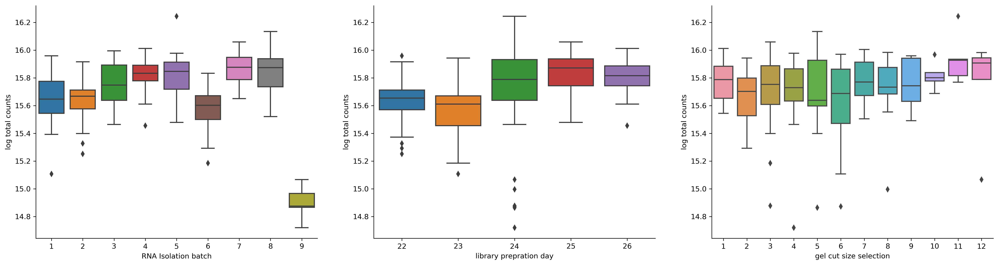

<Figure size 1800x1200 with 0 Axes>

<Figure size 1800x1200 with 0 Axes>

<Figure size 1800x1200 with 0 Axes>

In [77]:
fig, ax = plt.subplots(1,3,figsize=(24, 6))
for  i in range(3):
    show_batch_total_counts(ax[i],batchtable, original_mx, batchindex = i)
plt.tight_layout()

### PCA batch with other normal dataset

In [78]:
def show_batch_sns(data,sampleclass,batchinfo,batch_ind=0):
    X = np.log2(data + 0.001).T
    X = StandardScaler().fit_transform(X)
    method = 'UMAP'
    if method == 'PCA':
        transform = PCA()
    elif method == 'tSNE':
        transform = TSNE()
    elif method == 'UMAP':
        transform = umap.UMAP(n_neighbors=5,min_dist=0.3,metric='correlation')

    X_pca = transform.fit_transform(X)
    plot_table = pd.DataFrame(X_pca[:,:2])
    plot_table.index = data.columns
    plot_table = pd.concat((plot_table,sampleclass.loc[plot_table.index]),axis=1)
    plot_table.columns = ['dimension_1','dimension_2','class']
    plot_table = pd.concat((plot_table,batchinfo.loc[plot_table.index]),axis=1)
    #display(plot_table)
    batchnum = np.unique(plot_table.iloc[:,3+batch_ind]).shape[0]
    
    fig, ax = plt.subplots(1,figsize=(5, 5))
    sns.scatterplot(ax=ax,data=plot_table,x="dimension_1", y="dimension_2",style="class",
                    palette=list(np.array(Category20c[20]).reshape(4,-1).T.ravel())[:batchnum],
                    #palette=np.array(Category20c[20])[np.arange(0,20,3)],
                    hue=plot_table.columns[3+batch_ind],s=50,alpha=0.7)
    legend = ax.legend(prop=fontlegend,
                      #labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False)#,markerscale=markerscale)
    ax.legend_.get_frame()._linewidth=0.5
    legend.get_title().set_fontweight('normal')
    legend.get_title().set_fontsize(6.5)
    std_plot(ax,'Dimension 1','Dimension 2')

In [79]:
exosome_small_mx = pd.read_table('output/exosome_small/count_matrix/domains_combined.txt',index_col=0)
exosome_small_batch = pd.read_table('data/exosome_small/batch_info.txt',index_col=0)
exosome_small_class = pd.read_table('data/exosome_small/sample_classes.txt',index_col=0)

In [80]:
show_batch_sns(exosome_small_mx,exosome_small_class,exosome_small_batch)
embed_pdf_figure()

In [81]:
show_batch_sns(original_mx,sample_class,batchtable)
embed_pdf_figure()

### RNA batch by batch

In [82]:
def plot_rna_batch(ax,rnaname,typetable,batchtable,batchindex=1):
    '''
    typetable: table_ratio
    rnaname certain type pf rna
    '''
    counts = typetable.T.loc[rnaname].T
    sumtable = pd.DataFrame(counts)
    sumtable_whole = pd.concat((sumtable.loc[batchtable.index],batchtable),axis=1)
    batchname = batchtable.columns[batchindex]
    sns.boxplot(data=sumtable_whole,x=batchname,y=rnaname,ax=ax)
    ax.set_title('batch effect: '+batchname+ ' by '+rnaname,size=16)
    plt.tight_layout()
fig, ax = plt.subplots(4,3,figsize=(30, 24))
for i in range(4):
    for j in range(3):
        plot_rna_batch(ax[i,j],rnanames[i],table_ratio,batchtable,batchindex=j)

### RLE batch

In [83]:
def plotRLE(mat,batch,log=False,batchindex=1):
    if log is not True:
        log_mat = np.log2(mat+1)
    else:
        log_mat = mat
    feature_meds = log_mat.apply(np.median,1).tolist()
    for i in np.arange(len(feature_meds)):
        log_mat.iloc[i] = log_mat.iloc[i] - feature_meds[i]
    mat_rle = log_mat
    stack = pd.DataFrame(mat_rle.stack())
    stack = stack.reset_index()
    stack.rename(columns={stack.columns[2]: "counts",
                          stack.columns[1]: "sample"},
                 inplace=True)
    stack['class'] = None
    if batch is not None:
        for samplename in np.unique(stack['sample']):
            stack['class'].iloc[np.where(stack['sample'] == samplename)] \
            = batch[batch.index==samplename].iloc[0,batchindex]

        fig,ax = plt.subplots(figsize=(7,7))
        ax = sns.boxplot(x='class',y='counts',data=stack,fliersize=0.1,linewidth=0.5)
        std_plot(ax,batch.columns[batchindex],'RLE')
    else:
        fig,ax = plt.subplots(figsize=(7,3.5))
        ax = sns.boxplot(x='sample',y='counts',data=stack,fliersize=0,linewidth=0.5)
        std_plot(ax,'sample','RLE')
    embed_pdf_figure()


plotRLE(batch_table,batchtable,batchindex=1)

### PCA batch

In [84]:
rnatype_list = unique([name.split('|')[1] for name in original_mx.index])

def get_mx_RNA_spec(table,rnatype):
    name_filter = np.where(array([name.split('|')[1] for name in table.index]) == rnatype)
    return table.iloc[name_filter]
merge = pd.DataFrame()
for rnatype in tqdm(rnatype_list):
    original_mx_rna = get_mx_RNA_spec(original_mx,rnatype)
    impute_table_rna = get_mx_RNA_spec(impute_table,rnatype)
    normalize_table_rna = get_mx_RNA_spec(normalize_table,rnatype)
    batch_table_rna = get_mx_RNA_spec(batch_table,rnatype)
    fig,ucalist = visualize_effect_all(original_mx_rna, impute_table_rna, normalize_table_rna, batch_table_rna, sample_class,method='UMAP')
    ucalist.rename(columns={ ucalist.columns[0]: rnatype }, inplace=True)
    merge = pd.concat([merge,ucalist],axis=1)
    fig.savefig(savepath+rnatype+'_batch.eps')
    embed_pdf_figure(title=rnatype)
    
uca_rna_mx = merge
uca_rna_mx = uca_rna_mx.T.sort_values(by='Original matrix', ascending=False).T
uca_rna_mx.columns.name = 'rnatype'
uca_rna_stack = pd.DataFrame(uca_rna_mx.stack())
uca_rna_stack = uca_rna_stack.reset_index()
uca_rna_stack.rename(columns={ uca_rna_stack.columns[2]: "uca_score" }, inplace=True)
uca_rna_stack.rename(columns={ uca_rna_stack.columns[0]: "process" }, inplace=True)


HBox(children=(IntProgress(value=0, max=11), HTML(value='')))

In [85]:
fig,ax=plt.subplots(figsize=(7,4))
ax = sns.barplot(x="rnatype", y="uca_score", hue="process", data=uca_rna_stack)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45,horizontalalignment='right')
std_plot(ax,'RNA types','UCA scores',legendtitle='Processes',legendsort=False,borderpad=0.2,labelspacing=0.2)
fig.savefig(savepath+'UCAscores_of_RNA_batch_bar.eps')
fig.tight_layout()
embed_pdf_figure()

### feature batch by batch box

In [86]:
def featureplot_total_batch(ax,stack_batch,batchtable,batchindex=1):
    sns.boxplot(ax=ax,data=stack_batch,x=batchtable.columns[batchindex],y='counts',color='grey',linewidth=1,fliersize=0.1)
    std_plot(ax,batchtable.columns[batchindex],'feature counts')#,title='batch effect: '+batchtable.columns[batchindex]+ ' by '+'feature counts'
    
def stack_merge(exp_table,batch,log=False):
    if log is False:
        exp_table = np.log2(exp_table+1)
    stack = pd.DataFrame(exp_table.stack())
    stack = stack.reset_index()
    stack['rnaname'] = [featurename.split('|')[1] for featurename in stack.iloc[:,0].tolist()]
    stack.rename(columns={stack.columns[2]: "counts",
                          stack.columns[1]: "sample",
                          stack.columns[0]: "feature"},
                 inplace=True)
    stack = stack.set_index('sample')
    stack_batch = pd.concat([stack,batchtable],axis=1,join_axes=[stack.index])
    stack_batch = stack_batch.reset_index()    
    return(stack_batch)

stack_batch = stack_merge(batch_table,batchtable)
fig, ax = plt.subplots(1,3,figsize=(7, 2))
for i in arange(3):
    featureplot_total_batch(ax[i],stack_batch,batchtable,batchindex=i)
plt.tight_layout()
embed_pdf_figure()

In [87]:
def featureplot_rna_batch(ax,rnano,stack_batch,batchtable,batchindex=1):
    rnaname = unique(stack_batch['rnaname'])
    stack_batch_rna = stack_batch[stack_batch['rnaname']==rnaname[rnano]]
    sns.boxplot(ax=ax,data=stack_batch_rna,x=batchtable.columns[batchindex],y='counts',color='grey',linewidth=1,fliersize=0.1)
    std_plot(ax,batchtable.columns[batchindex],rnaname[rnano],title='batch effect: '+batchtable.columns[batchindex]+ ' by '+rnaname[rnano])

stack_batch = stack_merge(batch_table,batchtable)
fig, ax = plt.subplots(4,3,figsize=(7, 5.5))
for i in arange(4):
    for j in arange(3):
        featureplot_rna_batch(ax[i,j],i,stack_batch,batchtable,batchindex=j)
#featureplot_rna_batch(ax[0,0],rnanames[2],stack_batch,batchtable,batchindex=2)
#featureplot_rna_batch(ax[0,1],rnanames[2],stack_batch,batchtable,batchindex=2)
#featureplot_rna_batch(ax[1,1],rnanames[2],stack_batch,batchtable,batchindex=2)
plt.tight_layout()
embed_pdf_figure()

# Evaluation

In [17]:
def interactive_config_settings(dataset,sequencing_type,classifier,value_change,example_cancer,reads_preprocess,stage_info):
    if sequencing_type == 'short':
        exp_mx_name = 'domains_combined'
    elif sequencing_type =='long':
        exp_mx_name = 'featurecounts'
    elif sequencing_type =='domain_only':
        exp_mx_name = 'domains_long'
    elif sequencing_type =='transcript':
        exp_mx_name = 'transcript'
    return dataset,sequencing_type,classifier,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info

widget =interactive(interactive_config_settings,
           dataset= ['scirep','exorbase','exosome_small','pico_3v3'],
           sequencing_type=['short','long','domain_only','transcript'],
           classifier = ['logistic_regression','linear_svm','random_forest','decision_tree','logistic_regression_l1'],
           value_change = ['any','up','down'],
        example_cancer=['Normal-CRC','Normal-PAAD','Normal-PRAD','Normal-HCC'],
                   reads_preprocess=[True,False],
                   stage_info = ['No Stage','With Stage'])  # if start from preprocessing
display(widget)


interactive(children=(Dropdown(description='dataset', options=('scirep', 'exorbase', 'exosome_small', 'pico_3v3'), value='scirep'), Dropdown(description='sequencing_type', options=('short', 'long', 'domain_only', 'transcript'), value='short'), Dropdown(description='classifier', options=('logistic_regression', 'linear_svm', 'random_forest', 'decision_tree', 'logistic_regression_l1'), value='logistic_regression'), Dropdown(description='value_change', options=('any', 'up', 'down'), value='any'), Dropdown(description='example_cancer', options=('Normal-CRC', 'Normal-PAAD', 'Normal-PRAD', 'Normal-HCC'), value='Normal-CRC'), Dropdown(description='reads_preprocess', options=(True, False), value=True), Dropdown(description='stage_info', options=('No Stage', 'With Stage'), value='No Stage'), Output()), _dom_classes=('widget-interact',))

In [18]:
dataset,sequencing_type,classifier_use,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info = widget.result
dataset,sequencing_type,classifier_use,value_change,exp_mx_name,example_cancer,reads_preprocess,stage_info

('scirep',
 'short',
 'logistic_regression',
 'any',
 'domains_combined',
 'Normal-CRC',
 True,
 'No Stage')

In [19]:
if dataset=='scirep':
    if stage_info =='No Stage':
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    else:
        class_info = 'data/'+dataset+'/sample_classes.txt'

## feature recurrence

In [20]:
def compare_preprocess_methods(output_dir,preselected_methods_dir, title=None, criterion='roc_auc'):
    records = []
    pbar = tqdm(unit='directory')
    for preprocess_method in preselected_methods_dir:#os.listdir(output_dir):
        for compare_group in os.listdir(os.path.join(output_dir, preprocess_method)):
            for feature_selection_method in os.listdir(os.path.join(output_dir, preprocess_method, compare_group)):
                classifier, n_select, select_method, fold_change_direction  = feature_selection_method.split('.')
                record = {
                    'compare_group': compare_group,
                    'classifier': classifier,
                    'n_features': n_select,
                    'fold_change_direction': fold_change_direction,
                    'preprocess_method': preprocess_method
                }
                try:
                    metrics = pd.read_table(os.path.join(output_dir,
                        preprocess_method, compare_group, feature_selection_method,
                        'metrics.test.txt'), sep='\t', index_col=0)
                except:
                    continue
                for metric_name in metrics.columns:
                    record[metric_name] = metrics[metric_name].mean()
                #record['test_roc_auc_mean'] = metrics['test_roc_auc'].mean()
                pbar.update(1)
                records.append(record)
    pbar.close()
    records = pd.DataFrame.from_records(records)
    records['n_features'] = records.loc[:, 'n_features'].astype(np.int32)
    
    best_preprocess_methods = {}
    with embed_pdf_pages() as pdf:
        for compare_group, sub_df in records.groupby(['compare_group', 'fold_change_direction', 'classifier']):
            pivot = sub_df.pivot_table(
                index='preprocess_method', columns='n_features', values=criterion)
            #print(pivot.iloc[:, 0])
            #print(np.argsort(np.argsort(pivot.values, axis=0), axis=0)[:, 0])
            mean_ranks = np.mean(pivot.shape[0] - np.argsort(np.argsort(pivot.values, axis=0), axis=0), axis=1)
            mean_ranks = pd.Series(mean_ranks, index=pivot.index.values)
            mean_ranks = mean_ranks.sort_values()
            rename_index = ['{} (rank = {:.1f})'.format(name, value) for name, value in zip(mean_ranks.index, mean_ranks.values)]
            rename_index = pd.Series(rename_index, index=mean_ranks.index.values)
            sub_df = sub_df.copy()
            sub_df['preprocess_method'] = rename_index[sub_df['preprocess_method'].values].values
            sub_df['n_features'] = sub_df['n_features'].astype('int')
            sub_df = sub_df.sort_values(['preprocess_method', 'n_features'], ascending=True)
            sub_df['n_features'] = sub_df['n_features'].astype('str')
            fig, ax = plt.subplots(figsize=(12, 7))
            if sub_df['n_features'].unique().shape[0] > 1:
                # draw a line for each preprocess method
                for preprocess_method in rename_index.values:
                    tmp_df = sub_df[sub_df['preprocess_method'] == preprocess_method]
                    ax.plot(np.arange(tmp_df.shape[0]) + 1, tmp_df[criterion], label=preprocess_method)
                    ax.set_xticks(np.arange(tmp_df.shape[0]) + 1)
                    ax.set_xticklabels(tmp_df['n_features'])
                ax.set_xlabel('Number of features')
                ax.set_ylabel('Average {}'.format(criterion))
                ax.legend(title='Preprocess method', bbox_to_anchor=(1.04,0.5), 
                            loc="center left", borderaxespad=0)
                ax.set_ylim(0.5, 1)
                ax.set_title(compare_group)
            else:
                tmp_df = sub_df.copy()
                tmp_df = tmp_df.sort_values(criterion, ascending=False)
                ax.barh(tmp_df['preprocess_method'], tmp_df[criterion], color='gray')
                ax.set_ylabel('Preprocess method')
                ax.set_xlabel('Average {}'.format(criterion))
                ax.set_xlim(0, 1)
                ax.set_title(compare_group)
            
            #best_preprocess_methods[compare_group] = sub_df.iloc[0]['preprocess_method']
            best_preprocess_methods[compare_group] =best_preprocess_methods[compare_group] = mean_ranks.index[0]
            
            fig.tight_layout()
            pdf.savefig(fig)
            plt.close()
    return best_preprocess_methods
#use uca to presort methods
preselected_methods = np.loadtxt('output/'+dataset+'/select_preprocess_method/uca_score/'+exp_mx_name+'/selected_methods.txt',dtype='str')
preselected_methods_dir = np.array([preselected_methods[i]+'.'+exp_mx_name for i in range(preselected_methods.shape[0])])

best_preprocess_methods = compare_preprocess_methods('output/scirep/cross_validation',preselected_methods_dir)



HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

In [21]:
best_preprocess_methods['Normal-CRC','any','linear_svm']

'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'

## Compare Features: AUC line plot

In [154]:
cpm_table_origin_ = pd.read_table('output/'+dataset+'/matrix_processing/filter.'+exp_mx_name+'.txt')
cpm_table_origin =  cpm_table_origin_/cpm_table_origin_.sum(axis=0)*10e6
length_tmp = np.array([cpm_table_origin.index[i].split('|')[-1] for i in range(cpm_table_origin.index.shape[0])]).astype('int')-\
np.array([cpm_table_origin.index[i].split('|')[-2] for i in range(cpm_table_origin.index.shape[0])]).astype('int')
rpkm_table_origin = (cpm_table_origin_.T/length_tmp*1000).T


def calculate_fc(table,original_index,sample_class, class_compare,cpm_table_origin):
    samples_use = np.array(sample_class.index)[np.isin(sample_class.label,class_compare)]
    sample_class_use = sample_class.iloc[np.isin(sample_class.label,class_compare)]
    sample_class_1_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[0])]
    sample_class_2_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[1])]
    table_selected = table.loc[original_index]
    length = np.array([original_index[i].split('|')[-1] for i in range(original_index.shape[0])]).astype('int')-\
np.array([original_index[i].split('|')[-2] for i in range(original_index.shape[0])]).astype('int')
    #print (length)
    rpkmtable = (table_selected.T/length).T*1000
    #display(rpkmtable)
    #display(table_selected)
    rpkmtable_ = pd.concat((rpkmtable.loc[original_index,sample_class_1_use.index],
               rpkmtable.loc[original_index,sample_class_2_use.index]),axis=1)
    cpmtable_ = pd.concat((cpm_table_origin.loc[original_index,sample_class_1_use.index],
               cpm_table_origin.loc[original_index,sample_class_2_use.index]),axis=1)
    return np.mean(np.log2(rpkmtable.loc[:,sample_class_1_use.index]+0.001),axis=1) -\
np.mean(np.log2(rpkmtable.loc[:,sample_class_2_use.index]+0.001),axis=1),rpkmtable_,cpmtable_
def compare_features(path,sample_class,class_compare,compare_group,savepath=savepath,save_table=True):
    pbar = tqdm(unit='directory')
    feature_lists = {}
    for feature_selection_method in os.listdir(path):
        classifier, n_features, select_method,value_change  = feature_selection_method.split('.')
        if classifier==classifier_use:
            n_features = int(n_features)
            if n_features > 10:
                continue
            # feature importance
            feature_lists[n_features] = pd.read_table(os.path.join(path,
                feature_selection_method, 'feature_importances.txt'), header=None, index_col=0).iloc[:, 0]
            feature_lists[n_features].index = feature_lists[n_features].index.astype('str')
            pbar.update(1)
    # feature union set
    feature_set = reduce(np.union1d, [a.index.values for a in feature_lists.values()])
    # build feature importance matrix
    feature_matrix = pd.DataFrame(np.zeros((len(feature_set), len(feature_lists))),
                                  index=feature_set, columns=list(feature_lists.keys()))
    #print (feature_matrix.shape)
    for n_features, feature_importance in feature_lists.items():
        feature_matrix.loc[feature_importance.index.values, n_features] = feature_importance.values
    feature_matrix.columns = feature_matrix.columns.astype('int')
    feature_matrix.index = feature_matrix.index.astype('str')
    
    feature_matrix = feature_matrix.loc[:, feature_matrix.columns.sort_values().values]
    original_index = feature_matrix.index
    feature_info = feature_matrix.index.to_series().str.split('|', expand=True)
    feature_info.columns = ['gene_id', 'gene_type', 'gene_name', 'feature_id', 'transcript_id', 'start', 'end']

    feature_matrix.index = feature_info.loc[:, 'gene_name'].values \
        + '|' + feature_info.loc[:, 'gene_type'].values \
        + '|' + feature_info.loc[:, 'gene_id'].values \
    
    # build feature indicator matrix
    feature_indicator_matrix = pd.DataFrame(np.zeros((len(feature_set), len(feature_lists))),
                                  index=feature_set, columns=list(feature_lists.keys()))
    for n_features, feature_importance in feature_lists.items():
        feature_indicator_matrix.loc[feature_importance.index.values, n_features] = 1
    feature_indicator_matrix.columns = feature_indicator_matrix.columns.astype('int')
    feature_indicator_matrix = feature_indicator_matrix.loc[:, feature_indicator_matrix.columns.sort_values().values]
    
    feature_indicator_matrix.index = feature_info.loc[:, 'gene_name'].values \
        + '|' + feature_info.loc[:, 'gene_type'].values \
        + '|' + feature_info.loc[:, 'gene_id'].values
    #fig, ax = plt.subplots(figsize=(6, 8))
    #sns.heatmap(feature_indicator_matrix,
    #            cmap=sns.light_palette('green', as_cmap=True), cbar=False, ax=ax, linewidth=1)
    #ax.set_xlabel('Number of features')
    #ax.set_ylabel('Features')
    foldchange,rpkmtable,cpmtable = calculate_fc(processed_matrix, original_index,sample_class,class_compare,cpm_table_origin)
    foldchange.index = feature_matrix.index
    feature_matrix = pd.concat((feature_matrix,foldchange),axis=1)
    #display(feature_matrix) 
    if feature_matrix.shape[1]==2:
        feature_matrix.columns = np.concatenate((np.array([10]).astype('str'),np.array(['fold change'])))
    else:
        feature_matrix.columns = np.concatenate((np.arange(1,11).astype('str'),np.array(['fold change'])))
    #display (feature_matrix)
    feature_matrix.index = feature_info.loc[:, 'gene_name'].values \
        + '|' + feature_info.loc[:, 'gene_type'].values \
    + '|' + feature_info.loc[:, 'feature_id'].values \
        + '|' + feature_info.loc[:, 'transcript_id'].values
    #display (feature_matrix)
    display(feature_matrix.style\
        .background_gradient(cmap=sns.light_palette('green', as_cmap=True))\
        .set_precision(2)\
        .set_caption(path))
    pbar.close()
    if save_table:
        feature_matrix.to_csv(savepath+compare_group+'_feature_table.txt',sep='\t')
    return feature_matrix,feature_indicator_matrix,original_index,foldchange,rpkmtable,cpmtable


In [155]:
def scale(axis,table):
    '''
    axis: 0(by sample)/1(by feature)/2(both 0 and 1)
    '''
    scaler = StandardScaler()
    arr = np.array(table)
    if axis==0:
        return scaler.fit_transform(arr)
    elif axis==1:
        return scaler.fit_transform(arr.T).T
    elif axis==2:
        return scaler.fit_transform(scaler.fit_transform(arr).T).T
def clustermap(processed_matrix,featurename,sample_class, class_compare,compare_group,savepath=savepath,savefig=True):
    samples_use = np.array(sample_class.index)[np.isin(sample_class.label,class_compare)]
    #samples_use = np.loadtxt(output_feature_selection_path+'{}/{}'.format(preprocess_method,compare_group)+)
    #display(sample_class.loc[samples_use])
    sample_class_use = sample_class.loc[samples_use].iloc[np.isin(sample_class.loc[samples_use].label,class_compare)]
    cpm_table = processed_matrix
    cpm_table_use = cpm_table.loc[featurename,samples_use]
    #display(cpm_table_use)
    cpm_matrix= np.log2(np.array(cpm_table_use)+0.001)
    cpm_table_use.iloc[:,:] = RobustScaler().fit_transform(cpm_matrix.T).T
    rgblabel = np.repeat('r',samples_use.shape[0])
    rgblabel[np.where(sample_class_use.label==class_compare[-1])] = 'b'
    cpm_table_use.index = np.array([cpm_table_use.index[i].split('|')[2]+'|'+cpm_table_use.index[i].split('|')[1] for i in range(cpm_table_use.index.shape[0]) ])
    sns_plot = sns.clustermap(cpm_table_use,cmap='vlag',figsize=(70,20),col_colors=rgblabel)
    if savefig:
        sns_plot.savefig(savepath+compare_group+'_clustermap.eps', bbox_inches='tight')
    
   
    return cpm_table_use,sample_class_use

In [156]:
value_change, dataset,classifier_use

('any', 'scirep', 'logistic_regression')

In [157]:
df = pd.DataFrame.from_records([list(key) + [value] for key, value in best_preprocess_methods.items()])
df.columns = ['compare_group','value_change','classifier','preprocess_method']
tmpdict = {}
for i in df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['compare_group'].index:
    tmpdict[df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['compare_group'].loc[i]] = \
    df[(df['value_change']==value_change)&(df['classifier']==classifier_use)]['preprocess_method'].loc[i]
    

In [173]:
output_feature_selection_path

'output/scirep/cross_validation/'

In [178]:
#tmpdict.items()
compare_group = 'Normal-CRC'
preprocess_method = 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'
#output_feature_selection_path+'{}/{}'.format(preprocess_method,compare_group),sample_class,class_compare,compare_group)
#path,sample_class,class_compare,compare_group,savepath=savepath,save_table=True
path = output_feature_selection_path+'{}/{}'.format(preprocess_method,compare_group)
if dataset =='scirep':
    if compare_group=='Normal-CRC':
        class_compare = np.array(['Colorectal Cancer', 'Healthy Control'])
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    elif compare_group=='Normal-PAAD':
        class_compare = np.array(['Prostate Cancer', 'Healthy Control']) 
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    elif compare_group=='Normal-PRAD':
        class_compare = np.array(['Pancreatic Cancer', 'Healthy Control']) 
        class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
    elif compare_group=='Normal-CRC_S1':
        class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
    elif compare_group=='Normal-CRC_S1':
        class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
    elif compare_group=='Normal-CRC_S1':
        class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
    elif compare_group=='Normal-CRC_S1':
        class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
elif dataset =='lulab_hcc':
    if compare_group=='Normal-HCC':
        class_info = 'data_old/labels/sample_classes_hcc.txt'
        class_compare = np.array(['HCC', 'Normal']) 
    elif compare_group=='Normal-stage_A':
        class_compare = np.array(['stage_A', 'Normal']) 
elif dataset =='exorbase':
    if compare_group=='Normal-HCC':
        class_compare = np.array(['HCC', 'Healthy']) 
    elif compare_group=='Normal-CRC':
        class_compare = np.array(['CRC', 'Healthy']) 
    elif compare_group=='Normal-PAAD':
        class_compare = np.array(['PAAD', 'Healthy']) 
sample_class = pd.read_table(class_info,sep='\t',index_col=0)


In [179]:
sample_class.shape

(192, 1)

In [180]:
pbar = tqdm(unit='directory')
feature_lists = {}
for feature_selection_method in os.listdir(path):
    classifier, n_features, select_method,value_change  = feature_selection_method.split('.')
    if classifier==classifier_use:
        n_features = int(n_features)
        if n_features > 10:
            continue
        # feature importance
        feature_lists[n_features] = pd.read_table(os.path.join(path,
            feature_selection_method, 'feature_importances.txt'), header=None, index_col=0).iloc[:, 0]
        feature_lists[n_features].index = feature_lists[n_features].index.astype('str')
        pbar.update(1)
# feature union set
feature_set = reduce(np.union1d, [a.index.values for a in feature_lists.values()])
# build feature importance matrix
feature_matrix = pd.DataFrame(np.zeros((len(feature_set), len(feature_lists))),
                              index=feature_set, columns=list(feature_lists.keys()))
#print (feature_matrix.shape)
for n_features, feature_importance in feature_lists.items():
    feature_matrix.loc[feature_importance.index.values, n_features] = feature_importance.values
feature_matrix.columns = feature_matrix.columns.astype('int')
feature_matrix.index = feature_matrix.index.astype('str')

feature_matrix = feature_matrix.loc[:, feature_matrix.columns.sort_values().values]
original_index = feature_matrix.index
feature_info = feature_matrix.index.to_series().str.split('|', expand=True)
feature_info.columns = ['gene_id', 'gene_type', 'gene_name', 'feature_id', 'transcript_id', 'start', 'end']

feature_matrix.index = feature_info.loc[:, 'gene_name'].values \
    + '|' + feature_info.loc[:, 'gene_type'].values \
    + '|' + feature_info.loc[:, 'gene_id'].values \

# build feature indicator matrix
feature_indicator_matrix = pd.DataFrame(np.zeros((len(feature_set), len(feature_lists))),
                              index=feature_set, columns=list(feature_lists.keys()))
for n_features, feature_importance in feature_lists.items():
    feature_indicator_matrix.loc[feature_importance.index.values, n_features] = 1
feature_indicator_matrix.columns = feature_indicator_matrix.columns.astype('int')
feature_indicator_matrix = feature_indicator_matrix.loc[:, feature_indicator_matrix.columns.sort_values().values]

feature_indicator_matrix.index = feature_info.loc[:, 'gene_name'].values \
    + '|' + feature_info.loc[:, 'gene_type'].values \
    + '|' + feature_info.loc[:, 'gene_id'].values
#fig, ax = plt.subplots(figsize=(6, 8))
#sns.heatmap(feature_indicator_matrix,
#            cmap=sns.light_palette('green', as_cmap=True), cbar=False, ax=ax, linewidth=1)
#ax.set_xlabel('Number of features')
#ax.set_ylabel('Features')

HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

In [ ]:
def calculate_fc(table,original_index,sample_class, class_compare,cpm_table_origin):
    samples_use = np.array(sample_class.index)[np.isin(sample_class.label,class_compare)]
    sample_class_use = sample_class.iloc[np.isin(sample_class.label,class_compare)]
    sample_class_1_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[0])]
    sample_class_2_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[1])]
    table_selected = table.loc[original_index]
    length = np.array([original_index[i].split('|')[-1] for i in range(original_index.shape[0])]).astype('int')-\
np.array([original_index[i].split('|')[-2] for i in range(original_index.shape[0])]).astype('int')
    #print (length)
    rpkmtable = (table_selected.T/length).T*1000
    #display(rpkmtable)
    #display(table_selected)
    rpkmtable_ = pd.concat((rpkmtable.loc[original_index,sample_class_1_use.index],
               rpkmtable.loc[original_index,sample_class_2_use.index]),axis=1)
    cpmtable_ = pd.concat((cpm_table_origin.loc[original_index,sample_class_1_use.index],
               cpm_table_origin.loc[original_index,sample_class_2_use.index]),axis=1)
    return np.mean(np.log2(rpkmtable.loc[:,sample_class_1_use.index]+0.001),axis=1) -\
np.mean(np.log2(rpkmtable.loc[:,sample_class_2_use.index]+0.001),axis=1),rpkmtable_,cpmtable_


In [210]:
np.mean(np.log2(rpkmtable.loc[:,sample_class_1_use.index]+0.001),axis=1)-np.mean(np.log2(rpkmtable.loc[:,sample_class_2_use.index]+0.001),axis=1)


29255|tRNA|29255|peak_259|29255|20|72                                                               0.080613
ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134                                      0.135171
ENSG00000222440.1|snRNA|RNU2-26P|peak_818|ENST00000410508.1|80|120                                  0.150738
ENSG00000261971.6|lncRNA|MMP25-AS1|peak_1325|ENST00000572427.1|20|60                                0.138741
ENSG00000263426.2|srpRNA|RN7SL471P|peak_1353|ENST00000580476.2|180|299                              0.001553
ENSG00000273350.1|lncRNA|AC004832.5|peak_1467|ENST00000608677.1|60|100                              0.034827
G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100                                               0.086273
chr13_96512200_96512220_+|genomic|chr13_96512200_96512220_+|peak_2688|chr13|96512200|96512220       0.123656
chr3_115055200_115055240_-|genomic|chr3_115055200_115055240_-|peak_4078|chr3|115055200|115055240    0.064549
chr5_114925040_1149

In [197]:
calculate_fc(processed_matrix, original_index,sample_class,class_compare,cpm_table_origin)

,label
sample_id,
Sample_1S3,Colorectal Cancer
Sample_1S6,Colorectal Cancer
Sample_1S9,Colorectal Cancer
Sample_1S12,Colorectal Cancer
Sample_1S15,Colorectal Cancer
Sample_1S18,Colorectal Cancer
Sample_1S21,Colorectal Cancer
Sample_1S24,Colorectal Cancer
Sample_4S2,Colorectal Cancer


In [202]:
samples_use = np.array(sample_class.index)[np.isin(sample_class.label,class_compare)]
sample_class_use = sample_class.iloc[np.isin(sample_class.label,class_compare)]
sample_class_1_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[0])]
sample_class_2_use = sample_class_use.iloc[np.where(sample_class_use.label ==class_compare[1])]
table_selected = processed_matrix.loc[original_index]

In [204]:
original_index

Index(['29255|tRNA|29255|peak_259|29255|20|72',
       'ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134',
       'ENSG00000222440.1|snRNA|RNU2-26P|peak_818|ENST00000410508.1|80|120',
       'ENSG00000261971.6|lncRNA|MMP25-AS1|peak_1325|ENST00000572427.1|20|60',
       'ENSG00000263426.2|srpRNA|RN7SL471P|peak_1353|ENST00000580476.2|180|299',
       'ENSG00000273350.1|lncRNA|AC004832.5|peak_1467|ENST00000608677.1|60|100',
       'G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100',
       'chr13_96512200_96512220_+|genomic|chr13_96512200_96512220_+|peak_2688|chr13|96512200|96512220',
       'chr3_115055200_115055240_-|genomic|chr3_115055200_115055240_-|peak_4078|chr3|115055200|115055240',
       'chr5_114925040_114925080_+|genomic|chr5_114925040_114925080_+|peak_4471|chr5|114925040|114925080'],
      dtype='object')

In [203]:
table_selected

,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,...,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N49,Sample_Pan05,Sample_Pan06,Sample_PC6,Sample_PC12,Sample_PC26
29255|tRNA|29255|peak_259|29255|20|72,2.768776,3.448244,2.680833,2.593481,3.098084,2.568169,3.176896,3.138401,2.851063,2.421258,...,2.494804,3.515533,2.577499,2.406571,2.992979,2.919814,2.969185,3.269043,3.438729,2.888611
ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134,5.556860,4.984730,6.800558,5.989549,6.120825,3.533627,5.379593,4.228957,7.334453,24.644894,...,24.336355,7.108311,4.802781,7.459277,11.674726,6.806865,6.110717,7.321751,4.935878,6.063346
ENSG00000222440.1|snRNA|RNU2-26P|peak_818|ENST00000410508.1|80|120,1.956356,1.621915,2.498408,1.757675,1.472069,2.047132,1.129261,1.396559,1.952866,2.561109,...,3.410546,1.653782,1.378684,1.756967,1.877882,1.578941,2.075918,1.637431,1.553944,1.622510
ENSG00000261971.6|lncRNA|MMP25-AS1|peak_1325|ENST00000572427.1|20|60,1.246080,0.988260,1.424409,0.858440,1.113762,1.057607,1.084521,1.139068,0.908245,1.322953,...,0.859422,0.927152,0.901252,0.838487,0.638081,0.822613,1.073000,0.800953,0.840966,0.917744
ENSG00000263426.2|srpRNA|RN7SL471P|peak_1353|ENST00000580476.2|180|299,2.074551,2.417845,1.517364,2.345522,2.250945,2.258361,2.218318,1.908383,2.876222,1.975444,...,1.830472,2.445313,2.204686,2.091262,1.976518,2.658514,2.401308,2.238814,2.465860,1.983615
ENSG00000273350.1|lncRNA|AC004832.5|peak_1467|ENST00000608677.1|60|100,1.142415,1.029532,1.078424,0.867573,1.171599,1.259465,1.312100,1.894882,1.257828,1.068894,...,1.038470,1.040572,1.260744,1.510703,0.677375,0.884676,1.036785,1.146450,0.895911,1.220976
G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100,0.666588,0.788960,0.555656,0.408318,0.712007,1.070600,0.911602,0.499935,1.072734,0.506660,...,0.589482,0.739766,0.599561,0.880687,0.569916,0.925264,0.615771,0.983714,0.799353,0.902544
chr13_96512200_96512220_+|genomic|chr13_96512200_96512220_+|peak_2688|chr13|96512200|96512220,2.329477,2.410724,2.743658,3.604828,3.061583,3.299991,2.677224,2.789189,2.372289,2.494826,...,2.657900,2.576026,3.283704,3.259584,2.673214,2.816854,2.020388,2.508523,2.567677,2.859270
chr3_115055200_115055240_-|genomic|chr3_115055200_115055240_-|peak_4078|chr3|115055200|115055240,1.424870,1.055975,0.868014,1.050371,1.075572,0.956271,1.022267,1.187036,2.205367,0.532424,...,0.470498,1.472649,0.881381,1.410958,0.971904,1.542081,0.844836,1.189361,1.000888,0.747412
chr5_114925040_114925080_+|genomic|chr5_114925040_114925080_+|peak_4471|chr5|114925040|114925080,1.772313,1.364572,1.621043,1.180501,1.600152,1.825161,1.552537,1.468035,1.191716,1.356781,...,1.227743,1.636566,1.752568,1.277946,1.336808,1.909303,2.031776,1.789518,1.456633,1.721099


In [205]:
length = np.array([original_index[i].split('|')[-1] for i in range(original_index.shape[0])]).astype('int')-\
np.array([original_index[i].split('|')[-2] for i in range(original_index.shape[0])]).astype('int')
#print (length)
rpkmtable = (table_selected.T/length).T*1000
#display(rpkmtable)
#display(table_selected)


In [206]:
rpkmtable_ = pd.concat((rpkmtable.loc[original_index,sample_class_1_use.index],
           rpkmtable.loc[original_index,sample_class_2_use.index]),axis=1)
cpmtable_ = pd.concat((cpm_table_origin.loc[original_index,sample_class_1_use.index],
           cpm_table_origin.loc[original_index,sample_class_2_use.index]),axis=1)

In [198]:
table_selected

NameError: name 'table_selected' is not defined

In [184]:
cpm_table_origin

,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,...,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N49,Sample_Pan05,Sample_Pan06,Sample_PC6,Sample_PC12,Sample_PC26
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,456.174230,794.710608,385.676689,222.104025,756.211625,318.133003,640.643483,685.989349,969.866298,739.999634,...,652.078726,260.317106,343.830024,935.552455,1352.854304,649.633237,479.069704,419.640368,1259.173527,766.655711
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,3965.330759,10454.473352,3856.766887,2493.952383,6492.353460,3387.634459,6714.238250,7937.529237,9530.886415,13673.294907,...,10522.219872,2553.921874,3855.808126,8605.716813,12144.978785,5375.191135,4204.846742,3405.652784,11357.861982,7524.925932
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,370.742307,537.180133,264.927445,317.913604,347.086045,235.225614,278.348548,338.129502,493.027633,805.035232,...,448.359724,244.838791,426.717619,420.657162,593.187013,433.088824,369.403146,378.247271,768.738088,337.143776
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,91184.876293,88404.050465,92301.082292,80812.476846,40087.599823,48572.161241,47384.053839,71446.277182,78507.659810,79724.853723,...,56816.250976,53017.448141,66167.325188,51281.932215,100083.741197,57440.151665,46611.173464,84968.610472,115398.290988,88445.590152
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,5338.689216,9119.422727,5262.504350,3423.014971,4865.911606,3437.764508,5597.898572,7039.904876,8344.676648,9651.634186,...,7417.506704,3371.458298,4620.215947,7117.027505,9988.816728,4491.550227,4181.759046,4871.539376,14516.499747,13224.041276
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,3581.693067,6044.856437,2937.630853,1821.833668,3561.404635,2053.403927,2821.776812,3299.803374,5742.668127,9512.774397,...,4237.177312,2292.197649,3088.330394,4023.558440,6020.767364,3447.247336,2724.348198,3835.284590,8364.648869,3014.280887
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1524.879227,2567.405047,1326.439453,830.349688,1814.237201,1228.186198,1924.875936,2351.094700,2423.929884,3603.323635,...,2964.155953,1218.565478,1530.350598,2439.265232,3300.511935,1990.811532,1448.752961,1355.980782,3438.886587,2418.506268
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,120.894230,267.010125,131.562609,71.131354,145.876744,80.979310,145.801620,171.497337,223.702090,258.384670,...,192.154167,125.233635,165.775190,196.670881,248.912261,160.661983,141.412142,134.170730,323.064614,152.407461
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,1028.406920,1827.992394,805.595700,553.082572,995.986042,669.043345,1113.394191,1268.593778,1830.825000,2916.055566,...,1674.232144,541.741004,781.292331,1319.333827,1900.784542,991.913114,735.920329,772.195371,2533.916433,1303.930496
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,53.193461,126.395325,55.869053,26.129885,135.816278,48.201970,120.764978,117.980438,128.040012,166.983290,...,114.758739,57.691899,104.376972,128.382381,190.724980,118.750162,106.780597,42.820446,161.532307,146.249583


In [181]:
calculate_fc(processed_matrix, original_index,sample_class,class_compare,cpm_table_origin)

(29255|tRNA|29255|peak_259|29255|20|72                                                               0.080613
 ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134                                      0.135171
 ENSG00000222440.1|snRNA|RNU2-26P|peak_818|ENST00000410508.1|80|120                                  0.150738
 ENSG00000261971.6|lncRNA|MMP25-AS1|peak_1325|ENST00000572427.1|20|60                                0.138741
 ENSG00000263426.2|srpRNA|RN7SL471P|peak_1353|ENST00000580476.2|180|299                              0.001553
 ENSG00000273350.1|lncRNA|AC004832.5|peak_1467|ENST00000608677.1|60|100                              0.034827
 G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100                                               0.086273
 chr13_96512200_96512220_+|genomic|chr13_96512200_96512220_+|peak_2688|chr13|96512200|96512220       0.123656
 chr3_115055200_115055240_-|genomic|chr3_115055200_115055240_-|peak_4078|chr3|115055200|115055240    0.064549
 chr5_1149

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

Normal-CRC filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
29255|tRNA|peak_259|29255,0.73,0.081
RNU11|snRNA|peak_763|ENST00000387069.1,0.15,0.14
RNU2-26P|snRNA|peak_818|ENST00000410508.1,0.69,0.15
MMP25-AS1|lncRNA|peak_1325|ENST00000572427.1,1,0.14
RN7SL471P|srpRNA|peak_1353|ENST00000580476.2,0.14,0.0016
AC004832.5|lncRNA|peak_1467|ENST00000608677.1,0.26,0.035
G042353|tucpRNA|peak_1734|T184392,0.12,0.086
chr13_96512200_96512220_+|genomic|peak_2688|chr13,1.1,0.12
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.29,0.065
chr5_114925040_114925080_+|genomic|peak_4471|chr5,0.55,0.12


Normal-CRC_S1 filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
36073|tRNA|peak_394|36073,1.7,0.17
36093|tRNA|peak_409|36093,0.42,0.061
KIF5C|mRNA|peak_1053|ENST00000482151.1,0.022,0.098
AL138752.2|mRNA|peak_1233|ENST00000540557.1,1.3,0.18
chr18_57552240_57552280_-|genomic|peak_3271|chr18,0.69,0.057
chr19_3046300_3046340_+|genomic|peak_3309|chr19,1.7,0.37
chr3_70187400_70187440_-|genomic|peak_4032|chr3,0.48,0.14
chr5_114925040_114925080_+|genomic|peak_4471|chr5,1.9,0.21
chr6_109035900_109035940_+|genomic|peak_4709|chr6,0.18,0.15
chr6_152243720_152243760_+|genomic|peak_4754|chr6,0.28,0.18


Normal-CRC_S2 filter.viper_count.Norm_TMM.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
HELLPAR|lncRNA|peak_1607|ENST00000626826.1,0.00037,-0.27
chr10_60018860_60018900_+|genomic|peak_2208|chr10,0.00016,0.073
chr12_120742260_120742280_-|genomic|peak_2593|chr12,0.00022,0.32
chr19_56410940_56410960_+|genomic|peak_3397|chr19,0.00021,0.69
chr3_76083680_76083720_-|genomic|peak_4044|chr3,0.00027,-0.012
chr3_187709400_187709440_+|genomic|peak_4149|chr3,0.00024,0.078
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.00019,0.32
chr8_64467860_64467900_+|genomic|peak_5039|chr8,0.00019,0.27
chr9_38730940_38730980_-|genomic|peak_5179|chr9,0.00019,0.15
chr9_132566260_132566280_+|genomic|peak_5263|chr9,0.00022,0.26


Normal-CRC_S3 filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
30959|tRNA|peak_299|30959,1.1,0.035
Y_RNA|Y_RNA|peak_537|ENST00000362602.1,0.75,0.13
Y_RNA|Y_RNA|peak_644|ENST00000365403.1,0.35,-0.027
EVI5L|mRNA|peak_1416|ENST00000601766.1,1.8,0.12
chr18_57552240_57552280_-|genomic|peak_3271|chr18,1.8,0.057
chr19_797800_797840_+|genomic|peak_3300|chr19,0.21,0.1
chr19_52374400_52374440_+|genomic|peak_3392|chr19,0.27,-0.036
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.47,-0.013
chr8_142314840_142314880_+|genomic|peak_5130|chr8,0.51,-0.084
chrX_119284820_119284860_-|genomic|peak_5405|chrX,0.64,0.003


Normal-CRC_S4 filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
30795|tRNA|peak_279|30795,0.013,-0.056
36073|tRNA|peak_394|36073,0.011,0.17
RNU12|snRNA|peak_532|ENST00000362512.1,0.015,0.017
RNU11|snRNA|peak_763|ENST00000387069.1,0.017,-0.076
Y_RNA|Y_RNA|peak_1163|ENST00000516445.1,0.014,0.079
chr10_48345720_48345760_-|genomic|peak_2191|chr10,0.017,0.35
chr14_73863080_73863120_-|genomic|peak_2785|chr14,0.018,0.18
chr16_58510640_58510680_+|genomic|peak_3027|chr16,0.023,0.4
chr21_22621000_22621040_+|genomic|peak_3829|chr21,0.017,0.48
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.016,0.35


Normal-PAAD filter.viper_count.Norm_SCnorm.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
28612|tRNA|peak_250|28612,0.00015,0.17
RABL6|mRNA|peak_904|ENST00000435930.1,0.00023,0.18
AC112719.2|lncRNA|peak_1115|ENST00000501239.2,0.00019,-0.018
chr1_28791240_28791280_+|genomic|peak_1876|chr1,0.00019,0.32
chr12_20499940_20499980_-|genomic|peak_2491|chr12,0.00017,-0.06
chr16_15266760_15266800_+|genomic|peak_2976|chr16,0.00016,-0.04
chr16_KI270853v1_alt_2150640_2150680_-|genomic|peak_3090|chr16_KI270853v1_alt,0.00017,-0.019
chr21_46009340_46009380_-|genomic|peak_3865|chr21,0.00015,0.061
chr8_144581140_144581180_+|genomic|peak_5133|chr8,0.00014,0.4
chrX_130264180_130264220_+|genomic|peak_5412|chrX,0.00018,0.11


Normal-PRAD filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined


HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

,10,fold change
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p,0.41,0.28
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p,0.33,0.18
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p,0.53,0.38
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019,0.47,0.34
LINC01341|lncRNA|peak_861|ENST00000419361.1,0.3,0.17
AC084082.1|lncRNA|peak_1178|ENST00000517961.3,0.48,0.24
LINC00926|lncRNA|peak_1494|ENST00000613170.1,0.27,0.15
G008279|tucpRNA|peak_1664|T036557,0.36,0.07
G029527|tucpRNA|peak_1697|T126465,0.52,0.34
G042353|tucpRNA|peak_1734|T184392,0.087,0.22


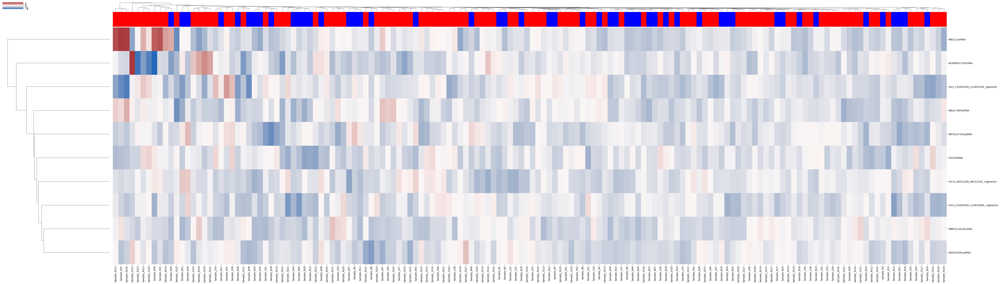

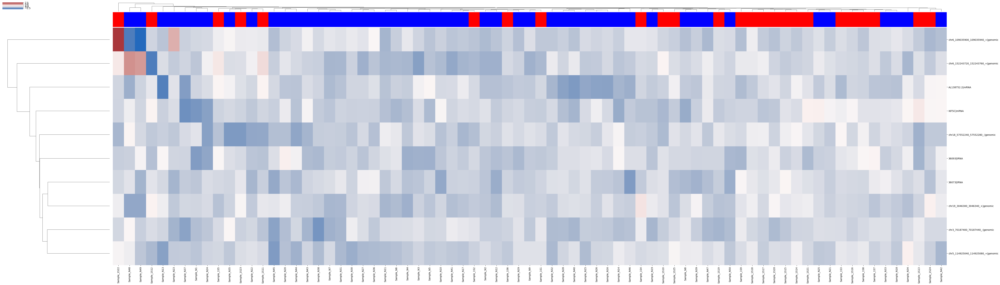

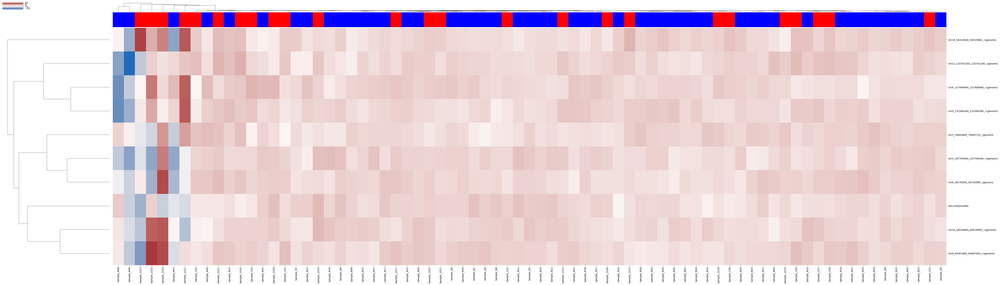

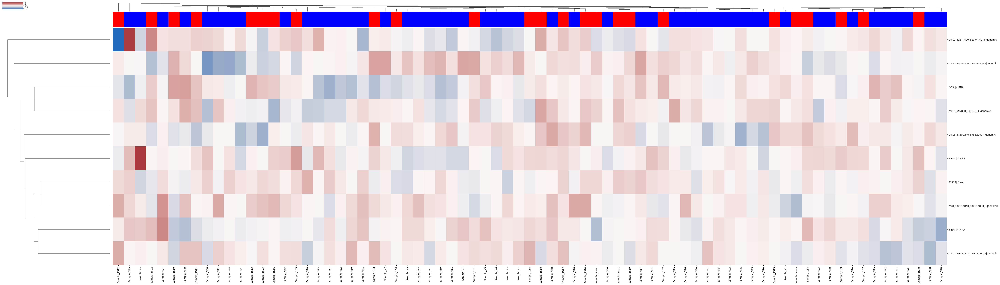

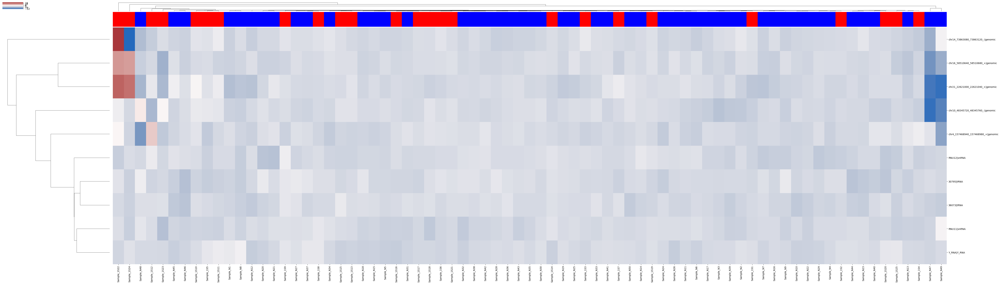

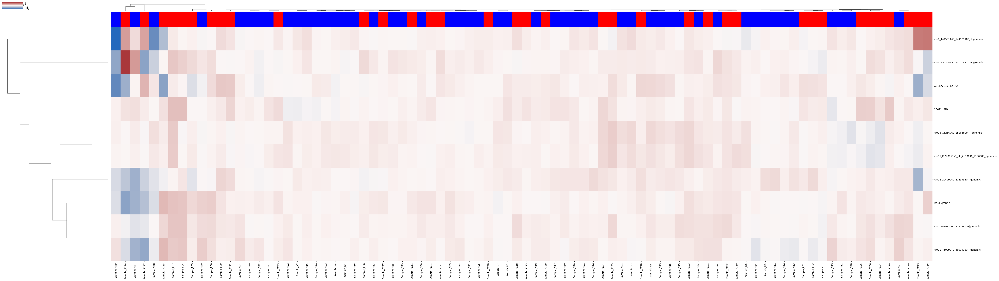

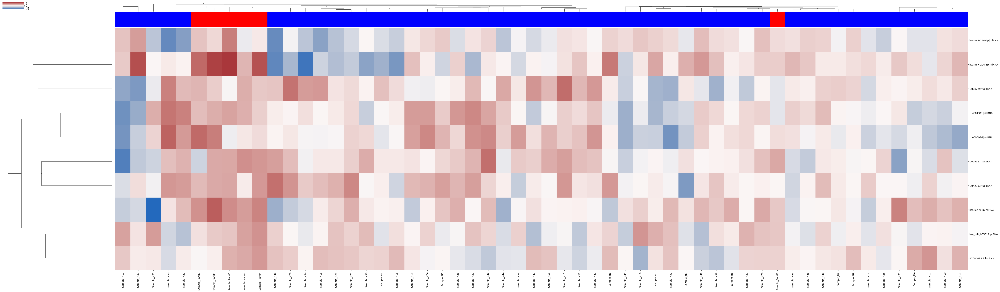

In [158]:
output_feature_selection_path = 'output/'+dataset+'/cross_validation/'
feature_matrix,feature_indicator_matrix,original_index,foldchange,rpkmtable,cpm_table_use,sample_class_use,cpmtable = {},{},{},{},{},{},{},{}
for compare_group, preprocess_method in tqdm(tmpdict.items()):
    print (compare_group,preprocess_method)
    #compare_group = compare_group[0]            
    class_info = 'data/'+dataset+'/sample_classes.txt'
    if dataset =='scirep':
        if compare_group=='Normal-CRC':
            class_compare = np.array(['Colorectal Cancer', 'Healthy Control'])
            class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
        elif compare_group=='Normal-PAAD':
            class_compare = np.array(['Prostate Cancer', 'Healthy Control']) 
            class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
        elif compare_group=='Normal-PRAD':
            class_compare = np.array(['Pancreatic Cancer', 'Healthy Control']) 
            class_info = 'data/'+dataset+'/sample_classes.no_stage.txt'
        elif compare_group=='Normal-CRC_S1':
            class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
        elif compare_group=='Normal-CRC_S1':
            class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
        elif compare_group=='Normal-CRC_S1':
            class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
        elif compare_group=='Normal-CRC_S1':
            class_compare = np.array([ 'Colorectal Cancer Stage 1', 'Healthy Control'])
    elif dataset =='lulab_hcc':
        if compare_group=='Normal-HCC':
            class_info = 'data_old/labels/sample_classes_hcc.txt'
            class_compare = np.array(['HCC', 'Normal']) 
        elif compare_group=='Normal-stage_A':
            class_compare = np.array(['stage_A', 'Normal']) 
    elif dataset =='exorbase':
        if compare_group=='Normal-HCC':
            class_compare = np.array(['HCC', 'Healthy']) 
        elif compare_group=='Normal-CRC':
            class_compare = np.array(['CRC', 'Healthy']) 
        elif compare_group=='Normal-PAAD':
            class_compare = np.array(['PAAD', 'Healthy']) 
    sample_class = pd.read_table(class_info,sep='\t',index_col=0)
    processed_matrix = pd.read_table('output/'+dataset+'/matrix_processing/'+preprocess_method+'.txt',sep='\t',index_col=0)
    feature_matrix[compare_group],feature_indicator_matrix[compare_group],\
    original_index[compare_group],foldchange[compare_group],rpkmtable[compare_group],cpmtable[compare_group] = compare_features(output_feature_selection_path+'{}/{}'.format(preprocess_method,compare_group),sample_class,class_compare,compare_group)
    features =  feature_matrix[compare_group].index
    cpm_table_use[compare_group],sample_class_use[compare_group] =  clustermap(processed_matrix,original_index[compare_group],sample_class,class_compare,compare_group)
    

In [169]:
def weight_bar_plt(weight=None,recurrence=None,rpkm=None,de=None,area_=(6.0,8.0),nameshort=True):
    weight.rename(columns={ weight.columns[0]: "weight" }, inplace=True)
    recurrence.rename(columns={ recurrence.columns[0]: "recurrence" }, inplace=True)
    de['name_cut'] = [featurename.split('|')[2] + '|' +\
                      featurename.split('|')[1] + '|' +\
                      featurename.split('|')[3] + '|' +\
                      featurename.split('|')[4]\
                      for featurename in de.index]
    de = de.set_index('name_cut')
    rpkm['name_cut'] = [featurename.split('|')[2] + '|' +\
                        featurename.split('|')[1] + '|' +\
                        featurename.split('|')[3] + '|' +\
                        featurename.split('|')[4]\
                        for featurename in rpkm.index]
    rpkm = rpkm.set_index('name_cut')
    weight = weight.sort_values('weight',ascending=False)
    index = weight.index
    plot_mx = pd.DataFrame({'weight':weight['weight'],
                  'rpkm':rpkm.loc[index].mean(axis=1),
                  'recurrence':recurrence.loc[index]['recurrence'],
                  'fc':de.loc[index]['log2FoldChange'],
                  'qvalue':de.loc[index]['padj']})
    plot_mx['-log10(qvalue)'] = -np.log10(plot_mx['qvalue'])
    plot_mx['log2RPKM'] = np.log2(plot_mx['rpkm'])

    if nameshort is True:
        plot_mx['nameshort'] = [i.split('|')[0] for i in index]
        plot_mx = plot_mx.set_index('nameshort')
        plot_mx.index.name=''
    display(plot_mx)
    fig, (ax_,ax, ax1) = plt.subplots(1,3, figsize=(7,3),gridspec_kw = {'width_ratios':[(1.5-nameshort)*2,2,2]})
    ax_.axis('off')
    im = ax.scatter(plot_mx['weight'],plot_mx.index,s=((plot_mx['log2RPKM']/area_[0]-0.5)*area_[1])**2,c=plot_mx['recurrence'],cmap='BuGn')
    cbar =fig.colorbar(im, ax=ax)
    cbar.outline.set_visible(False)
    interval = np.max(plot_mx.log2RPKM) - np.min(plot_mx.log2RPKM)
    ratiointer = interval/4
    pws = set(np.round(np.arange(np.min(plot_mx.log2RPKM),np.max(plot_mx.log2RPKM),ratiointer),0).astype(int))
    for pw in pws:
        ax.scatter([], [], s=((pw/area_[0]-0.5)*area_[1])**2, c="k",label=str(pw))
    ax = std_plot(ax,'Feature Weight','Feature Name',None,'log(RPKM)',
                      borderpad=1,labelspacing=1.7,handletextpad=1,cbar=cbar,cbarlabel='Feature Recurrency',)
                      #xlim=[0,0.25],ylim=[-0.5,nums_retain-0.5])


    plot = ax1.scatter(plot_mx.index, plot_mx['fc'], c=plot_mx['-log10(qvalue)'], cmap='Reds')
    ax1.clear()
    sns.barplot(ax=ax1,data=plot_mx[::-1],y=plot_mx[::-1].index,x='fc',palette='Reds',hue='-log10(qvalue)',dodge=False)
    ax1.get_legend().remove()
    cbar = fig.colorbar(plot,ax=ax1)
    cbar.outline.set_visible(False)
    ax1 = std_plot(ax1,'Fold Change','',None,moveyaxis=True,cbar=cbar,cbarlabel='-log10(q value)')
    ax1.set_yticks([])
    #fig.tight_layout()
    with embed_pdf_data() as data:
        fig.savefig(data, format='pdf', metadata={'Title': '123'})

In [170]:
selected_features = {}
count = 0
scalefactor=np.array([0.6,0.6,0.5,0.5,0.5,0.5,0.5])*300
for compare_group, preprocess_method in tqdm(tmpdict.items()):  
    if sequencing_type =='long':
        tmptable = rpkmtable[compare_group]
    else:
        tmptable = cpmtable[compare_group]
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0) 
    #display(detable)
    with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
        feature_selection_matrix = f['feature_selection'][:]
    tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
    tmprecurrencedf.index = filtered_mx.index                                 
    detable=detable.fillna(1)
    weight_bar_plt(feature_matrix[compare_group],tmprecurrencedf,tmptable,detable,(6.0,8.0),False)
    #selected_features[compare_group] = weight_bar_plt(feature_matrix[compare_group],detable,tmprecurrencedf,
    #                10,original_index=original_index[compare_group],rpkmtable=tmptable,
    #                                compare_group=compare_group,scalefactor=scalefactor[count],area_=(8.0,9.0),namelength=3)
    count+=1

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
chr13_96512200_96512220_+|genomic|peak_2688|chr13,0.078703,0.499512,0.06,130.391968,1.064659,0.301454,7.026711
MMP25-AS1|lncRNA|peak_1325|ENST00000572427.1,0.260026,0.150494,0.06,146.310177,1.035603,0.822481,7.192886
29255|tRNA|peak_259|29255,0.180901,0.180224,0.00,97.460394,0.733960,0.744188,6.606744
RNU2-26P|snRNA|peak_818|ENST00000410508.1,0.506274,0.070627,0.00,143.990516,0.686676,1.151028,7.169830
chr5_114925040_114925080_+|genomic|peak_4471|chr5,0.107934,1.000000,0.56,82.258802,0.546016,-0.000000,6.362098
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.186125,0.406158,0.14,110.375953,0.290121,0.391305,6.786282
AC004832.5|lncRNA|peak_1467|ENST00000608677.1,-0.168168,0.705892,0.00,174.574983,0.255618,0.151262,7.447703
RNU11|snRNA|peak_763|ENST00000387069.1,0.463055,0.007568,0.14,163.083014,0.154387,2.121014,7.349463
RN7SL471P|srpRNA|peak_1353|ENST00000580476.2,0.046957,0.687842,0.04,111.611695,0.141689,0.162511,6.802344
G042353|tucpRNA|peak_1734|T184392,0.129872,1.000000,0.46,73.229053,0.122057,-0.000000,6.194344


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
chr5_114925040_114925080_+|genomic|peak_4471|chr5,0.156619,0.674371,0.86,81.257370,1.869635,0.171101,6.344427
36073|tRNA|peak_394|36073,0.256107,0.550617,0.08,108.376704,1.733907,0.259150,6.759911
chr19_3046300_3046340_+|genomic|peak_3309|chr19,1.550549,0.000075,0.00,105.950539,1.656398,4.126899,6.727247
AL138752.2|mRNA|peak_1233|ENST00000540557.1,0.284615,0.550617,0.38,110.541739,1.330048,0.259150,6.788447
chr18_57552240_57552280_-|genomic|peak_3271|chr18,0.145377,0.700725,0.22,132.935203,0.687072,0.154452,7.054579
chr3_70187400_70187440_-|genomic|peak_4032|chr3,0.102248,0.815331,0.06,80.464705,0.480645,0.088666,6.330284
36093|tRNA|peak_409|36093,0.071499,0.885743,0.04,125.832000,0.420300,0.052692,6.975355
chr6_152243720_152243760_+|genomic|peak_4754|chr6,0.028768,0.980946,0.04,74.046214,0.276168,0.008355,6.210354
chr6_109035900_109035940_+|genomic|peak_4709|chr6,-0.195614,0.775596,0.02,115.621829,0.175563,0.110364,6.853270
KIF5C|mRNA|peak_1053|ENST00000482151.1,0.112742,0.632641,0.06,143.330273,0.022483,0.198842,7.163200


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
HELLPAR|lncRNA|peak_1607|ENST00000626826.1,-0.433844,0.661196,0.30,226.586620,0.000371,0.179670,7.823919
chr3_76083680_76083720_-|genomic|peak_4044|chr3,-0.135277,0.929534,0.08,173.791295,0.000271,0.031735,7.441212
chr3_187709400_187709440_+|genomic|peak_4149|chr3,-0.376773,0.716554,0.04,224.161145,0.000244,0.144751,7.808392
chr12_120742260_120742280_-|genomic|peak_2593|chr12,-0.335454,0.763674,0.14,149.132175,0.000218,0.117092,7.220448
chr9_132566260_132566280_+|genomic|peak_5263|chr9,-0.623594,0.620597,0.04,95.748189,0.000216,0.207190,6.581173
chr19_56410940_56410960_+|genomic|peak_3397|chr19,-0.420081,0.647392,0.02,90.327483,0.000208,0.188832,6.497093
chr8_64467860_64467900_+|genomic|peak_5039|chr8,-0.557636,0.620597,0.00,316.374911,0.000193,0.207190,8.305491
chr9_38730940_38730980_-|genomic|peak_5179|chr9,-0.414948,0.669892,0.00,278.266530,0.000189,0.173995,8.120324
chr4_157468940_157468980_+|genomic|peak_4332|chr4,-0.572796,0.620597,0.02,90.685596,0.000188,0.207190,6.502802
chr10_60018860_60018900_+|genomic|peak_2208|chr10,-0.502043,0.620597,0.02,112.846933,0.000157,0.207190,6.818223


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
chr18_57552240_57552280_-|genomic|peak_3271|chr18,0.670766,0.011867,0.54,132.935203,1.806534,1.925656,7.054579
EVI5L|mRNA|peak_1416|ENST00000601766.1,0.440613,0.070683,0.00,2565.941895,1.763982,1.150686,11.325273
30959|tRNA|peak_299|30959,-0.055185,0.899354,0.02,127.008056,1.115790,0.046069,6.988776
Y_RNA|Y_RNA|peak_537|ENST00000362602.1,0.579931,0.030840,0.42,107.270660,0.746445,1.510891,6.745112
chrX_119284820_119284860_-|genomic|peak_5405|chrX,0.266425,0.267017,0.22,98.029058,0.643203,0.573460,6.615138
chr8_142314840_142314880_+|genomic|peak_5130|chr8,0.105315,0.591808,0.02,113.925066,0.512338,0.227819,6.831941
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.379270,0.182833,0.32,102.524308,0.474448,0.737946,6.679822
Y_RNA|Y_RNA|peak_644|ENST00000365403.1,0.046655,0.776031,0.98,3791.690088,0.354214,0.110121,11.888625
chr19_52374400_52374440_+|genomic|peak_3392|chr19,-0.060762,0.932629,0.08,80.932836,0.273649,0.030291,6.338653
chr19_797800_797840_+|genomic|peak_3300|chr19,0.226633,0.339118,0.00,76.222373,0.211144,0.469650,6.252143


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
chr16_58510640_58510680_+|genomic|peak_3027|chr16,-0.455285,3.651327e-01,0.08,253.366310,0.023052,0.437549,7.985081
chr14_73863080_73863120_-|genomic|peak_2785|chr14,-0.387520,4.302029e-01,0.18,1312.868892,0.017867,0.366327,10.358507
RNU11|snRNA|peak_763|ENST00000387069.1,1.163702,1.462975e-09,0.88,132.291435,0.016988,8.834763,7.047576
chr21_22621000_22621040_+|genomic|peak_3829|chr21,-0.306565,5.349400e-01,0.12,180.175637,0.016793,0.271695,7.493260
chr10_48345720_48345760_-|genomic|peak_2191|chr10,-0.492751,3.284793e-01,0.04,104.794685,0.016754,0.483492,6.711422
chr4_157468940_157468980_+|genomic|peak_4332|chr4,-0.408956,4.144715e-01,0.00,90.685596,0.015947,0.382505,6.502802
RNU12|snRNA|peak_532|ENST00000362512.1,0.450281,9.836401e-04,0.12,827.877363,0.014866,3.007164,9.693273
Y_RNA|Y_RNA|peak_1163|ENST00000516445.1,0.397228,2.306737e-02,0.20,148.511336,0.014159,1.637002,7.214429
30795|tRNA|peak_279|30795,0.148828,5.397429e-01,0.20,110.177254,0.013226,0.267813,6.783683
36073|tRNA|peak_394|36073,0.332803,9.934295e-02,0.00,108.376704,0.011423,1.002863,6.759911


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
RABL6|mRNA|peak_904|ENST00000435930.1,-0.364567,0.866587,0.16,151.851618,0.000233,0.062188,7.246518
AC112719.2|lncRNA|peak_1115|ENST00000501239.2,-0.097173,0.998985,0.10,222.839323,0.000190,0.000441,7.799860
chr1_28791240_28791280_+|genomic|peak_1876|chr1,-0.709777,0.563554,0.14,470.409764,0.000187,0.249065,8.877774
chrX_130264180_130264220_+|genomic|peak_5412|chrX,-0.418672,0.846530,0.08,136.515150,0.000179,0.072358,7.092917
chr12_20499940_20499980_-|genomic|peak_2491|chr12,0.006391,0.998985,0.04,451.094513,0.000168,0.000441,8.817286
chr16_KI270853v1_alt_2150640_2150680_-|genomic|peak_3090|chr16_KI270853v1_alt,-0.429140,0.497070,0.00,1003.762315,0.000166,0.303582,9.971202
chr16_15266760_15266800_+|genomic|peak_2976|chr16,-0.493028,0.429217,0.00,1465.980042,0.000157,0.367323,10.517650
chr21_46009340_46009380_-|genomic|peak_3865|chr21,-0.171879,0.998985,0.04,251.944097,0.000155,0.000441,7.976960
28612|tRNA|peak_250|28612,0.362963,0.051607,0.00,4171.280738,0.000146,1.287288,12.026275
chr8_144581140_144581180_+|genomic|peak_5133|chr8,-0.011093,0.998985,0.02,109.613878,0.000137,0.000441,6.776287


,fc,qvalue,recurrence,rpkm,weight,-log10(qvalue),log2RPKM
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p,0.381312,0.000214,0.62,1944.728854,0.526680,3.668685,10.925353
G029527|tucpRNA|peak_1697|T126465,0.487559,0.011296,0.22,127.443655,0.520591,1.947087,6.993716
AC084082.1|lncRNA|peak_1178|ENST00000517961.3,0.342249,0.007349,0.32,96.223142,0.478766,2.133788,6.588312
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019,0.546792,0.000005,0.00,771.130413,0.467274,5.293272,9.590831
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p,0.255742,0.002458,0.10,781.736348,0.413975,2.609365,9.610538
G008279|tucpRNA|peak_1664|T036557,0.369814,0.167452,0.00,84.179165,0.364707,0.776108,6.395391
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p,0.239778,0.006319,0.24,292.597814,0.329500,2.199328,8.192775
LINC01341|lncRNA|peak_861|ENST00000419361.1,0.355382,0.068746,0.00,302.907677,0.296339,1.162753,8.242734
LINC00926|lncRNA|peak_1494|ENST00000613170.1,0.355212,0.059524,0.02,384.264373,0.274670,1.225311,8.585955
G042353|tucpRNA|peak_1734|T184392,0.271875,0.556447,0.00,66.678908,0.086971,0.254577,6.059159


In [164]:
selected_features = {}
count = 0
scalefactor=np.array([0.6,0.6,0.5,0.5,0.5,0.5,0.5])*300
for compare_group, preprocess_method in tqdm(tmpdict.items()): 
    preprocess_method = preprocess_method[np.where(np.array([preprocess_method[i].split('.')[-1] for i in range(preprocess_method.shape[0])])==exp_mx_name)][0]
    
    if sequencing_type =='long':
        tmptable = rpkmtable[compare_group]
    else:
        tmptable = cpmtable[compare_group]
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0) 
    #display(detable)
    with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
        feature_selection_matrix = f['feature_selection'][:]
    tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
    tmprecurrencedf.index = filtered_mx.index                                 
    detable=detable.fillna(1)
    weight_bar_plt(feature_matrix[compare_group],tmprecurrencedf,tmptable,detable,(6.0,8.0),False)
    #selected_features[compare_group] = feature_weight_bar(feature_matrix[compare_group],detable,tmprecurrencedf,
            #        10,original_index=original_index[compare_group],rpkmtable=tmptable,
           #                         compare_group=compare_group,scalefactor=scalefactor[count],area_=(8.0,9.0),namelength=3)
    count+=1
    

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

IndexError: tuple index out of range

## bar plot of feature importance

In [33]:
filtered_mx = pd.read_table('output/'+dataset+'/matrix_processing/filter.'+exp_mx_name+'.txt')

In [34]:
filtered_mx.index =  np.array([filtered_mx.index[i].split('|')[2]+'|'+filtered_mx.index[i].split('|')[1]+'|'+filtered_mx.index[i].split('|')[3]+'|'+filtered_mx.index[i].split('|')[4] for i in range(filtered_mx.index.shape[0])])


In [58]:
feature_matrix

{'Normal-CRC':                                                          10  fold change
 29255|tRNA|peak_259|29255                          0.733960     0.080613
 RNU11|snRNA|peak_763|ENST00000387069.1             0.154387     0.135171
 RNU2-26P|snRNA|peak_818|ENST00000410508.1          0.686676     0.150738
 MMP25-AS1|lncRNA|peak_1325|ENST00000572427.1       1.035603     0.138741
 RN7SL471P|srpRNA|peak_1353|ENST00000580476.2       0.141689     0.001553
 AC004832.5|lncRNA|peak_1467|ENST00000608677.1      0.255618     0.034827
 G042353|tucpRNA|peak_1734|T184392                  0.122057     0.086273
 chr13_96512200_96512220_+|genomic|peak_2688|chr13  1.064659     0.123656
 chr3_115055200_115055240_-|genomic|peak_4078|chr3  0.290121     0.064549
 chr5_114925040_114925080_+|genomic|peak_4471|chr5  0.546016     0.115137,
 'Normal-CRC_S1':                                                          10  fold change
 36073|tRNA|peak_394|36073                          1.733907     0.173185
 36093

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

,10,fold change,0
29255|tRNA|peak_259|29255,0.733960,0.080613,0.00
RNU11|snRNA|peak_763|ENST00000387069.1,0.154387,0.135171,0.14
RNU2-26P|snRNA|peak_818|ENST00000410508.1,0.686676,0.150738,0.00
MMP25-AS1|lncRNA|peak_1325|ENST00000572427.1,1.035603,0.138741,0.06
RN7SL471P|srpRNA|peak_1353|ENST00000580476.2,0.141689,0.001553,0.04
AC004832.5|lncRNA|peak_1467|ENST00000608677.1,0.255618,0.034827,0.00
G042353|tucpRNA|peak_1734|T184392,0.122057,0.086273,0.46
chr13_96512200_96512220_+|genomic|peak_2688|chr13,1.064659,0.123656,0.06
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.290121,0.064549,0.14
chr5_114925040_114925080_+|genomic|peak_4471|chr5,0.546016,0.115137,0.56


,10,fold change,0
36073|tRNA|peak_394|36073,1.733907,0.173185,0.08
36093|tRNA|peak_409|36093,0.420300,0.061145,0.04
KIF5C|mRNA|peak_1053|ENST00000482151.1,0.022483,0.097581,0.06
AL138752.2|mRNA|peak_1233|ENST00000540557.1,1.330048,0.180947,0.38
chr18_57552240_57552280_-|genomic|peak_3271|chr18,0.687072,0.057272,0.22
chr19_3046300_3046340_+|genomic|peak_3309|chr19,1.656398,0.369693,0.00
chr3_70187400_70187440_-|genomic|peak_4032|chr3,0.480645,0.141518,0.06
chr5_114925040_114925080_+|genomic|peak_4471|chr5,1.869635,0.206507,0.86
chr6_109035900_109035940_+|genomic|peak_4709|chr6,0.175563,0.147697,0.02
chr6_152243720_152243760_+|genomic|peak_4754|chr6,0.276168,0.179666,0.04


,10,fold change,0
HELLPAR|lncRNA|peak_1607|ENST00000626826.1,0.000371,-0.268983,0.30
chr10_60018860_60018900_+|genomic|peak_2208|chr10,0.000157,0.072937,0.02
chr12_120742260_120742280_-|genomic|peak_2593|chr12,0.000218,0.320087,0.14
chr19_56410940_56410960_+|genomic|peak_3397|chr19,0.000208,0.687524,0.02
chr3_76083680_76083720_-|genomic|peak_4044|chr3,0.000271,-0.011609,0.08
chr3_187709400_187709440_+|genomic|peak_4149|chr3,0.000244,0.078204,0.04
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.000188,0.318215,0.02
chr8_64467860_64467900_+|genomic|peak_5039|chr8,0.000193,0.273682,0.00
chr9_38730940_38730980_-|genomic|peak_5179|chr9,0.000189,0.147219,0.00
chr9_132566260_132566280_+|genomic|peak_5263|chr9,0.000216,0.262090,0.04


,10,fold change,0
30959|tRNA|peak_299|30959,1.115790,0.035192,0.02
Y_RNA|Y_RNA|peak_537|ENST00000362602.1,0.746445,0.126638,0.42
Y_RNA|Y_RNA|peak_644|ENST00000365403.1,0.354214,-0.027044,0.98
EVI5L|mRNA|peak_1416|ENST00000601766.1,1.763982,0.121538,0.00
chr18_57552240_57552280_-|genomic|peak_3271|chr18,1.806534,0.057272,0.54
chr19_797800_797840_+|genomic|peak_3300|chr19,0.211144,0.101943,0.00
chr19_52374400_52374440_+|genomic|peak_3392|chr19,0.273649,-0.035574,0.08
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.474448,-0.012559,0.32
chr8_142314840_142314880_+|genomic|peak_5130|chr8,0.512338,-0.083889,0.02
chrX_119284820_119284860_-|genomic|peak_5405|chrX,0.643203,0.003036,0.22


,10,fold change,0
30795|tRNA|peak_279|30795,0.013226,-0.056222,0.20
36073|tRNA|peak_394|36073,0.011423,0.173185,0.00
RNU12|snRNA|peak_532|ENST00000362512.1,0.014866,0.017283,0.12
RNU11|snRNA|peak_763|ENST00000387069.1,0.016988,-0.075979,0.88
Y_RNA|Y_RNA|peak_1163|ENST00000516445.1,0.014159,0.078956,0.20
chr10_48345720_48345760_-|genomic|peak_2191|chr10,0.016754,0.347183,0.04
chr14_73863080_73863120_-|genomic|peak_2785|chr14,0.017867,0.176536,0.18
chr16_58510640_58510680_+|genomic|peak_3027|chr16,0.023052,0.398785,0.08
chr21_22621000_22621040_+|genomic|peak_3829|chr21,0.016793,0.476365,0.12
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.015947,0.347702,0.00


,10,fold change,0
28612|tRNA|peak_250|28612,0.000146,0.167034,0.00
RABL6|mRNA|peak_904|ENST00000435930.1,0.000233,0.181275,0.16
AC112719.2|lncRNA|peak_1115|ENST00000501239.2,0.000190,-0.017923,0.10
chr1_28791240_28791280_+|genomic|peak_1876|chr1,0.000187,0.315756,0.14
chr12_20499940_20499980_-|genomic|peak_2491|chr12,0.000168,-0.059785,0.04
chr16_15266760_15266800_+|genomic|peak_2976|chr16,0.000157,-0.040246,0.00
chr16_KI270853v1_alt_2150640_2150680_-|genomic|peak_3090|chr16_KI270853v1_alt,0.000166,-0.018735,0.00
chr21_46009340_46009380_-|genomic|peak_3865|chr21,0.000155,0.061282,0.04
chr8_144581140_144581180_+|genomic|peak_5133|chr8,0.000137,0.398728,0.02
chrX_130264180_130264220_+|genomic|peak_5412|chrX,0.000179,0.110197,0.08


,10,fold change,0
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p,0.413975,0.281335,0.10
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p,0.329500,0.177194,0.24
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p,0.526680,0.380481,0.62
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019,0.467274,0.341868,0.00
LINC01341|lncRNA|peak_861|ENST00000419361.1,0.296339,0.166934,0.00
AC084082.1|lncRNA|peak_1178|ENST00000517961.3,0.478766,0.243728,0.32
LINC00926|lncRNA|peak_1494|ENST00000613170.1,0.274670,0.153891,0.02
G008279|tucpRNA|peak_1664|T036557,0.364707,0.069979,0.00
G029527|tucpRNA|peak_1697|T126465,0.520591,0.338020,0.22
G042353|tucpRNA|peak_1734|T184392,0.086971,0.216770,0.00


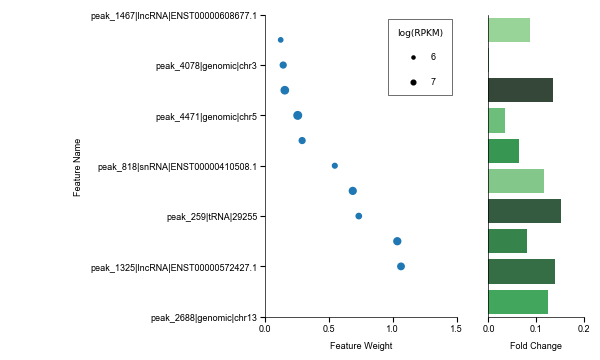

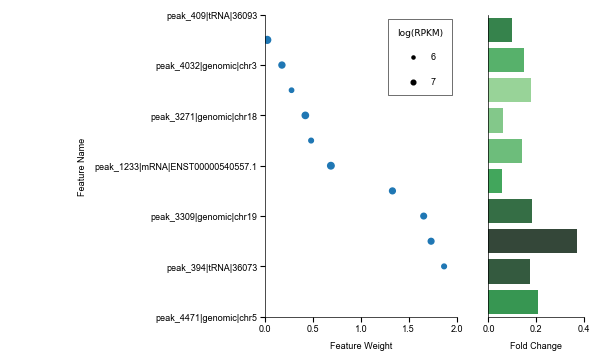

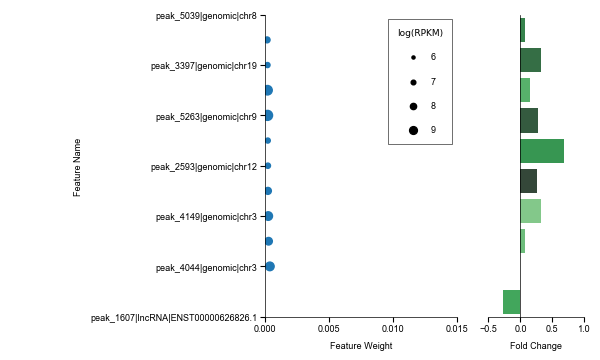

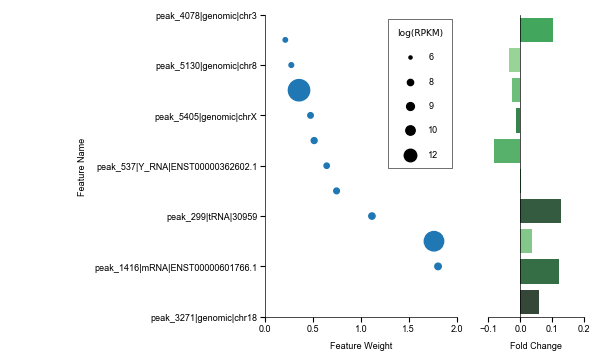

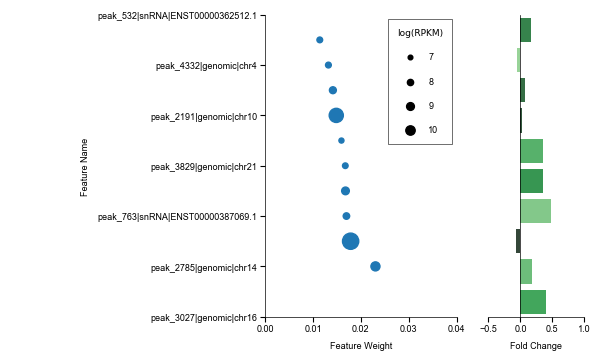

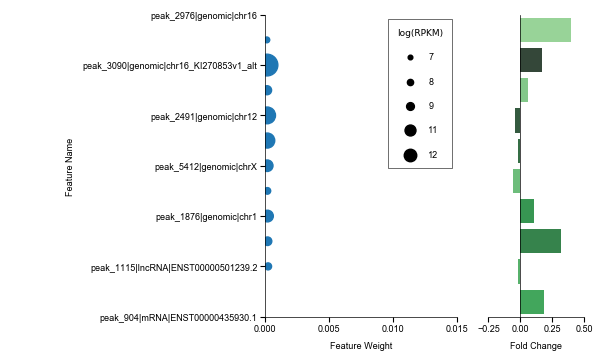

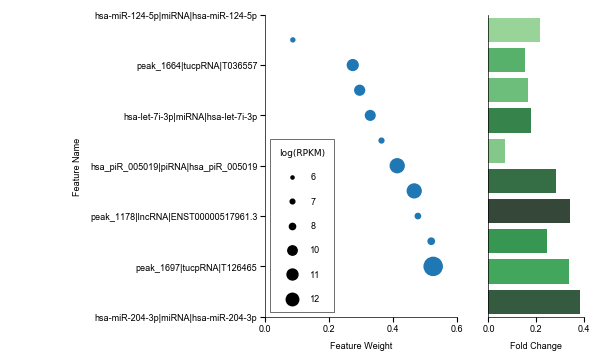

In [43]:
def feature_weight_bar_(feature_weight_table,detable,nums_retain=10,rpkmtable=rpkmtable,
                        original_index=original_index, savepath=savepath,savefig=True,
                        compare_group=compare_group,scalefactor=0.1,area_=(8.0,9.0),namelength=2):
    feature_weight_table = pd.concat(( feature_weight_table,(feature_weight_table.iloc[:,:-1] !=0).sum(axis=1)),axis=1)
    #display(feature_weight_table)
    display(feature_weight_table)
    selected_table = feature_weight_table.iloc[:,nums_retain-1:]
    #display(selected_table,rpkmtable)
    rpkm = np.array(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1))
    selected_feature = original_index[np.where(selected_table.iloc[:,0]!=0)]
    #print (selected_feature)
    #display(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1))
    
    #print (selected_feature.shape[0])
    nums_retain = min(selected_feature.shape[0],nums_retain)
    
    selected_table = selected_table.iloc[np.where(selected_table.iloc[:,0]!=0)]
    #display(selected_table)
    featurename = np.array(selected_table.index)#np.array([selected_table.index[i].split('|')[0] for  i in range(selected_table.shape[0])])
    #display(selected_table)
    #print (featurename)
    #feature_weight = np.array(feature_weight_table.sum(axis=1))
    feature_weight = np.array(selected_table.iloc[:,0])
    fc = np.array(selected_table.iloc[:,1])
    fc = fc[np.argsort(feature_weight)]
    recurrence = np.array(selected_table.iloc[:,2])
    recurrence = recurrence[np.argsort(-feature_weight)]
    #rpkm = np.array(rpkmtable.mean(axis=1))
    rpkm = rpkm[np.argsort(feature_weight)]
    deselected = -np.log10(detable.loc[selected_feature].iloc[np.argsort(feature_weight)].padj)
    #print (deselected)
    featurename = featurename[np.argsort(feature_weight)]
    #display(selected_table,featurename,rpkm)
    selected_feature = selected_feature[np.argsort(feature_weight)]
    feature_weight = np.sort(feature_weight)
    if namelength == 2:
        featurename = np.array([featurename[i].split('|')[0]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
    if namelength == 3:
        featurename = np.array([featurename[i].split('|')[0]+'|'+featurename[i].split('|')[1]+'|'+featurename[i].split('|')[2] for i in range(len(featurename))])

    dataframe = pd.DataFrame(np.concatenate((featurename.reshape(-1,1),feature_weight.reshape(-1,1)),axis=1),columns=['name','weight'])
    #display(dataframe)
    dataframe.weight  =  pd.to_numeric(dataframe.weight)
    dataframe_= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),fc.reshape(-1,1)),axis=1),columns=['name','fc'])
    dataframe_.fc  =  pd.to_numeric(dataframe_.fc)
    #dataframe__= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),recurrence.reshape(-1,1)),axis=1),columns=['name','recurrence'])
    #dataframe__.recurrence  =  pd.to_numeric(dataframe__.recurrence)
    dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),np.log2(rpkm).reshape(-1,1)),axis=1),columns=['name','rpkm'])
    dataframe_rpkm.rpkm  =  pd.to_numeric(dataframe_rpkm.rpkm)
    dataframe_de= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),deselected.reshape(-1,1)),axis=1),columns=['name','DE_padj'])
    dataframe_de.DE_padj  =  pd.to_numeric(dataframe_de.DE_padj)
    #display(dataframe_rpkm)
    
    #display(dataframe_)
    dataframe = dataframe.iloc[::-1]
    dataframe_rpkm = dataframe_rpkm.iloc[::-1]
    #dataframe_de =  dataframe_de.iloc[::-1]
    #display(dataframe_de)
    fig, (ax, ax1,ax2) = plt.subplots(1,3, figsize=(7,4),gridspec_kw = {'width_ratios':[2, 1,1]})
    #scalefactor=0.1
    #print (dataframe_rpkm.shape)
    #print (recurrence)
    #cmaps = sns.cubehelix_palette(10, start=0.1,rot=-0.2)
    #ax.scatter(dataframe.weight, np.arange(nums_retain),
     #           c = np.array(sns.cubehelix_palette(10, start=0.1,rot=-0.2))[recurrence-1], s=(dataframe_rpkm.rpkm)*scalefactor)
    #cmap = plt.get_cmap("viridis")
    cmap = plt.cm.BuGn#"viridis"
    # extract all colors from the .jet map
    cmaplist = [cmap(i) for i in range(cmap.N)]
    # force the first color entry to be grey
    cmaplist[0] = (.5,.5,.5,1.0)
    # create the new map
    cmaps = cmap.from_list('Custom cmap', cmaplist, cmap.N)
    # define the bins and normalize
    bounds = np.linspace(0,recurrence.max(),recurrence.max()+1)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    #display(dataframe,dataframe_rpkm,np.log2(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1)))
    im = ax.scatter(dataframe.weight, np.arange(nums_retain),cmap=cmaps,norm=norm,
            c = recurrence-1, s=(((dataframe_rpkm.rpkm)/area_[0]-0.5)*area_[1])**2.5)
    #display(dataframe.weight,np.arange(nums_retain),dataframe_rpkm.rpkm)
    cbar =fig.colorbar(im, ax=ax)#,drawedges=True
    cbar.outline.set_visible(False)
    #cbar.set_label('Feature Recurrency',weight='bold')
    #ax.set_xlabel("weight",fontsize=30,fontdict=dict(weight='bold'))
    #ax.set_ylabel("name",fontsize=30,fontdict=dict(weight='bold'))
    ax.set_yticks(np.arange(10))
    ax.set_yticklabels(featurename[::-1])
    if sequencing_type =='short':
        mattype = 'Log CPM'
    elif sequencing_type =='long':
        mattype = 'Log RPKM'
    #make a legend:
   # pws = np.round(np.array([np.min(dataframe_rpkm.rpkm),np.percentile(dataframe_rpkm.rpkm,0.2),
   #                np.percentile(dataframe_rpkm.rpkm,0.4),np.percentile(dataframe_rpkm.rpkm,0.6),
   #                np.percentile(dataframe_rpkm.rpkm,0.8),np.max(dataframe_rpkm.rpkm)]),2)
    interval = np.max(dataframe_rpkm.rpkm) - np.min(dataframe_rpkm.rpkm)
    ratiointer = interval/4
    #pws = np.round(np.arange(np.min(dataframe_rpkm.rpkm),np.max(dataframe_rpkm.rpkm)+ratiointer,ratiointer),0).astype(int)
    pws = set(np.round(np.arange(np.min(dataframe_rpkm.rpkm),np.max(dataframe_rpkm.rpkm)+ratiointer,ratiointer),0).astype(int))
    for pw in pws:
        ax.scatter([], [], s=((pw/area_[0]-0.5)*area_[1])**2, c="k",label=str(pw))
        
    #h,l = ax.get_legend_handles_labels()
    
    #ax.set_yticklabels(np.arange(5,11)/10,fontticklabel)
    #ax.set_xticklabels(np.concatenate((np.arange(1,10),np.arange(10,60,10))).astype('str'),fontticklabel)
    
    #mpl.rcParams['title_fontsize']=6
    #ax.legend(h[1:], l[1:], labelspacing=2, title=mattype, borderpad=1,  fontsize=20,
    #            frameon=True, framealpha=0.6, edgecolor="k", facecolor="w",prop={'size':25,'weight':'bold'})
    sns.barplot(ax=ax1,data=dataframe_,y='name',x='fc',color='g',saturation=1)
    sns.barplot(ax=ax2,data=dataframe_de,y='name',x='DE_padj',color='r',saturation=1)

    #ax = std_plot(ax,'Feature Weight','Feature Name',None,'log CPM',borderpad=2)
    ax = std_plot(ax,'Feature Weight','Feature Name',None,'log(RPKM)',
                  borderpad=1,labelspacing=1.7,handletextpad=1,cbar=cbar,cbarlabel='Feature Recurrency',
                  xlim=[0,0.25],ylim=[-0.5,nums_retain-0.5])
    #cbar.set_linewiths(5)
    
    
    ax1 = std_plot(ax1,'Fold Change','',None,moveyaxis=True)
    #print(ax1.get_xticklabels())
    ax2 = std_plot(ax2,'DE adjusted P-value','',None,None)
    ax1.set_yticks([])
    ax2.set_yticks([])
    #ax1.get_yaxis().set_ticks([])
    #ax2.get_yaxis().set_ticks([])
    fig.tight_layout()
    if savefig:
        fig.savefig(savepath+'weight_fc_barplot_'+compare_group+'.eps', bbox_inches='tight')
    return  selected_feature


plt.rcParams['figure.dpi'] = 100
selected_features = {}
count = 0
scalefactor=np.array([0.6,0.6,0.5,0.5,0.5,0.5,0.5])*300
for compare_group, preprocess_method in tqdm(tmpdict.items()):  
    if sequencing_type =='long':
        tmptable = rpkmtable[compare_group]
    else:
        tmptable = cpmtable[compare_group]
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0) 
    #display(detable)
    with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
        feature_selection_matrix = f['feature_selection'][:]
    tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
    tmprecurrencedf.index = filtered_mx.index                                 
    detable=detable.fillna(1)
    selected_features[compare_group] = feature_weight_bar(feature_matrix[compare_group],detable,tmprecurrencedf,
                    10,original_index=original_index[compare_group],rpkmtable=tmptable,
                                    compare_group=compare_group,scalefactor=scalefactor[count],area_=(8.0,9.0),namelength=3)
    count+=1

In [104]:
compare_group = 'Normal-CRC'
preprocess_method = 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'
if sequencing_type =='long':
    tmptable = rpkmtable[compare_group]
else:
    tmptable = cpmtable[compare_group]
detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                   ,index_col=0) 

In [105]:
with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
    feature_selection_matrix = f['feature_selection'][:]
tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
tmprecurrencedf.index = filtered_mx.index                                 
detable=detable.fillna(1)


In [106]:
feature_selection_matrix

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [60]:
feature_weight_table = feature_matrix[compare_group]
nums_retain = 10


In [103]:
feature_weight_table

,10,fold change
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p,0.526680,0.380481
G029527|tucpRNA|peak_1697|T126465,0.520591,0.338020
AC084082.1|lncRNA|peak_1178|ENST00000517961.3,0.478766,0.243728
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019,0.467274,0.341868
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p,0.413975,0.281335
G008279|tucpRNA|peak_1664|T036557,0.364707,0.069979
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p,0.329500,0.177194
LINC01341|lncRNA|peak_861|ENST00000419361.1,0.296339,0.166934
LINC00926|lncRNA|peak_1494|ENST00000613170.1,0.274670,0.153891
G042353|tucpRNA|peak_1734|T184392,0.086971,0.216770


In [102]:
original_index[compare_group]

Index(['29255|tRNA|29255|peak_259|29255|20|72',
       'ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134',
       'ENSG00000222440.1|snRNA|RNU2-26P|peak_818|ENST00000410508.1|80|120',
       'ENSG00000261971.6|lncRNA|MMP25-AS1|peak_1325|ENST00000572427.1|20|60',
       'ENSG00000263426.2|srpRNA|RN7SL471P|peak_1353|ENST00000580476.2|180|299',
       'ENSG00000273350.1|lncRNA|AC004832.5|peak_1467|ENST00000608677.1|60|100',
       'G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100',
       'chr13_96512200_96512220_+|genomic|chr13_96512200_96512220_+|peak_2688|chr13|96512200|96512220',
       'chr3_115055200_115055240_-|genomic|chr3_115055200_115055240_-|peak_4078|chr3|115055200|115055240',
       'chr5_114925040_114925080_+|genomic|chr5_114925040_114925080_+|peak_4471|chr5|114925040|114925080'],
      dtype='object')

In [92]:
weight_index

Index(['hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p',
       'G029527|tucpRNA|peak_1697|T126465',
       'AC084082.1|lncRNA|peak_1178|ENST00000517961.3',
       'hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019',
       'hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p',
       'G008279|tucpRNA|peak_1664|T036557',
       'hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p',
       'LINC01341|lncRNA|peak_861|ENST00000419361.1',
       'LINC00926|lncRNA|peak_1494|ENST00000613170.1',
       'G042353|tucpRNA|peak_1734|T184392'],
      dtype='object')

In [97]:
feature_weight_table = feature_weight_table.sort_values('10',ascending=False)
weight_index = feature_weight_table.index
recurrence = tmprecurrencedf.loc[weight_index]

In [98]:
weight_index

Index(['hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p',
       'G029527|tucpRNA|peak_1697|T126465',
       'AC084082.1|lncRNA|peak_1178|ENST00000517961.3',
       'hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019',
       'hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p',
       'G008279|tucpRNA|peak_1664|T036557',
       'hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p',
       'LINC01341|lncRNA|peak_861|ENST00000419361.1',
       'LINC00926|lncRNA|peak_1494|ENST00000613170.1',
       'G042353|tucpRNA|peak_1734|T184392'],
      dtype='object')

In [ ]:
feature_weight_table = pd.concat(( feature_weight_table,(feature_weight_table.iloc[:,:-1] !=0).sum(axis=1)),axis=1)


In [51]:
feature_weight_table = feature_matrix[compare_group]
nums_retain = 10
feature_weight_table = pd.concat(( feature_weight_table,(feature_weight_table.iloc[:,:-1] !=0).sum(axis=1)),axis=1)
#display(feature_weight_table)
#display(feature_weight_table)
selected_table = feature_weight_table.iloc[:,nums_retain-1:]
#display(selected_table,rpkmtable)
rpkm = np.array(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1))
selected_feature = original_index[np.where(selected_table.iloc[:,0]!=0)]
#print (selected_feature)
#display(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1))

#print (selected_feature.shape[0])
nums_retain = min(selected_feature.shape[0],nums_retain)

selected_table = selected_table.iloc[np.where(selected_table.iloc[:,0]!=0)]
#display(selected_table)
featurename = np.array(selected_table.index)#np.array([selected_table.index[i].split('|')[0] for  i in range(selected_table.shape[0])])
#display(selected_table)
#print (featurename)
#feature_weight = np.array(feature_weight_table.sum(axis=1))
feature_weight = np.array(selected_table.iloc[:,0])
fc = np.array(selected_table.iloc[:,1])
fc = fc[np.argsort(feature_weight)]
recurrence = np.array(selected_table.iloc[:,2])
recurrence = recurrence[np.argsort(-feature_weight)]
#rpkm = np.array(rpkmtable.mean(axis=1))
rpkm = rpkm[np.argsort(feature_weight)]
deselected = -np.log10(detable.loc[selected_feature].iloc[np.argsort(feature_weight)].padj)
#print (deselected)
featurename = featurename[np.argsort(feature_weight)]
#display(selected_table,featurename,rpkm)
selected_feature = selected_feature[np.argsort(feature_weight)]
feature_weight = np.sort(feature_weight)
if namelength == 2:
    featurename = np.array([featurename[i].split('|')[0]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
if namelength == 3:
    featurename = np.array([featurename[i].split('|')[0]+'|'+featurename[i].split('|')[1]+'|'+featurename[i].split('|')[2] for i in range(len(featurename))])

dataframe = pd.DataFrame(np.concatenate((featurename.reshape(-1,1),feature_weight.reshape(-1,1)),axis=1),columns=['name','weight'])
#display(dataframe)
dataframe.weight  =  pd.to_numeric(dataframe.weight)
dataframe_= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),fc.reshape(-1,1)),axis=1),columns=['name','fc'])
dataframe_.fc  =  pd.to_numeric(dataframe_.fc)
#dataframe__= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),recurrence.reshape(-1,1)),axis=1),columns=['name','recurrence'])
#dataframe__.recurrence  =  pd.to_numeric(dataframe__.recurrence)
dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),np.log2(rpkm).reshape(-1,1)),axis=1),columns=['name','rpkm'])
dataframe_rpkm.rpkm  =  pd.to_numeric(dataframe_rpkm.rpkm)
dataframe_de= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),deselected.reshape(-1,1)),axis=1),columns=['name','DE_padj'])
dataframe_de.DE_padj  =  pd.to_numeric(dataframe_de.DE_padj)
#display(dataframe_rpkm)

#display(dataframe_)
dataframe = dataframe.iloc[::-1]
dataframe_rpkm = dataframe_rpkm.iloc[::-1]

AttributeError: 'dict' object has no attribute 'iloc'

In [47]:
detable

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,449.696774,-0.231833,0.113238,-2.047310,4.062763e-02,2.699405e-01
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,5116.053370,0.018668,0.127050,0.146935,8.831831e-01,9.598961e-01
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,282.131709,-0.000492,0.075307,-0.006539,9.947829e-01,9.979220e-01
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53401.516981,-0.011722,0.077721,-0.150824,8.801147e-01,9.586964e-01
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4782.025408,-0.098171,0.101219,-0.969891,3.321009e-01,6.021510e-01
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2705.918752,-0.072431,0.086772,-0.834724,4.038732e-01,6.552595e-01
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1517.051888,0.007529,0.097731,0.077036,9.385952e-01,9.800092e-01
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,118.263252,-0.190484,0.089104,-2.137782,3.253444e-02,2.534595e-01
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,924.421334,-0.092882,0.103343,-0.898777,3.687715e-01,6.336638e-01
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,69.805318,-0.136517,0.111012,-1.229747,2.187917e-01,4.995117e-01


In [44]:
tmpdict.items()

dict_items([('Normal-CRC', 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'), ('Normal-CRC_S1', 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'), ('Normal-CRC_S2', 'filter.viper_count.Norm_TMM.Batch_RUV.domains_combined'), ('Normal-CRC_S3', 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'), ('Normal-CRC_S4', 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined'), ('Normal-PAAD', 'filter.viper_count.Norm_SCnorm.Batch_RUV.domains_combined'), ('Normal-PRAD', 'filter.viper_count.Norm_CPM_top.Batch_RUV.domains_combined')])

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

,10,fold change
29255|tRNA|peak_259|29255,0.73396,0.0806129
RNU11|snRNA|peak_763|ENST00000387069.1,0.154387,0.135171
RNU2-26P|snRNA|peak_818|ENST00000410508.1,0.686676,0.150738
MMP25-AS1|lncRNA|peak_1325|ENST00000572427.1,1.0356,0.138741
RN7SL471P|srpRNA|peak_1353|ENST00000580476.2,0.141689,0.00155264
AC004832.5|lncRNA|peak_1467|ENST00000608677.1,0.255618,0.0348271
G042353|tucpRNA|peak_1734|T184392,0.122057,0.0862729
chr13_96512200_96512220_+|genomic|peak_2688|chr13,1.06466,0.123656
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.290121,0.0645493
chr5_114925040_114925080_+|genomic|peak_4471|chr5,0.546016,0.115137


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,449.697,-0.231833,0.113238,-2.04731,0.0406276,0.269941
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,5116.05,0.0186682,0.12705,0.146935,0.883183,0.959896
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,282.132,-0.000492413,0.0753075,-0.0065387,0.994783,0.997922
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53401.5,-0.0117222,0.0777215,-0.150824,0.880115,0.958696
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4782.03,-0.0981715,0.101219,-0.969891,0.332101,0.602151
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2705.92,-0.072431,0.0867724,-0.834724,0.403873,0.65526
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1517.05,0.00752873,0.0977305,0.0770356,0.938595,0.980009
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,118.263,-0.190484,0.0891035,-2.13778,0.0325344,0.253459
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,924.421,-0.092882,0.103343,-0.898777,0.368772,0.633664
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,69.8053,-0.136517,0.111012,-1.22975,0.218792,0.499512


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,Sample_4S8,Sample_4S11,Sample_4S14,Sample_4S17,Sample_4S20,Sample_4S23,Sample_2S1,Sample_2S4,Sample_2S7,Sample_2S10,Sample_2S13,Sample_2S16,Sample_2S19,Sample_2S22,Sample_4S3,Sample_4S6,Sample_4S9,Sample_4S12,Sample_4S15,Sample_4S18,Sample_4S21,Sample_4S24,Sample_2S2,Sample_2S5,Sample_2S8,Sample_2S11,Sample_2S14,Sample_2S17,Sample_2S20,Sample_2S23,Sample_2S3,Sample_2S6,Sample_2S9,Sample_2S12,Sample_2S15,Sample_2S18,Sample_2S21,Sample_2S24,Sample_3S1,Sample_3S4,Sample_3S7,Sample_3S10,Sample_3S13,Sample_3S16,Sample_3S19,Sample_3S22,Sample_2S25,Sample_3S2,Sample_3S5,Sample_3S8,Sample_3S11,Sample_3S14,Sample_3S17,Sample_3S20,Sample_3S23,Sample_1S1,Sample_1S4,Sample_1S7,Sample_1S10,Sample_1S13,Sample_1S16,Sample_1S19,Sample_1S22,Sample_3S3,Sample_3S6,Sample_3S9,Sample_3S12,Sample_3S15,Sample_3S18,Sample_3S21,Sample_3S24,Sample_3S25,Sample_1S2,Sample_1S5,Sample_1S8,Sample_1S11,Sample_1S14,Sample_1S17,Sample_1S20,Sample_1S23,Sample_1S25,Sample_4S1,Sample_4S4,Sample_4S7,Sample_4S10,Sample_4S13,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
29255|tRNA|29255|peak_259|29255|20|72,116.058,90.0567,115.343,107.423,115.695,136.894,117.819,81.4916,82.4166,50.9738,44.8293,82.1306,113.656,99.5222,94.9838,108.696,68.3206,117.906,112.104,105.493,112.988,81.2785,188.224,53.1796,194.538,83.9231,99.4071,93.1404,122.381,168.283,109.592,99.4478,96.031,64.8184,68.6206,90.8941,86.5263,76.6601,131.075,125.802,57.2393,79.9052,73.2803,134.355,148.643,84.3973,95.563,104.315,98.8074,61.3437,91.8463,67.3257,88.5708,95.9961,124.765,57.718,104.697,101.53,55.8564,164.087,122.425,169.497,90.0681,74.2106,72.5864,133.344,88.5338,90.9123,74.5775,96.9587,115.692,108.256,97.7504,101.039,74.9818,99.3358,102.147,190.873,126.106,61.3857,101.796,71.0637,105.569,73.5263,137.235,65.2067,157.42,158.021,93.5648,122.572,67.0389,101.198,96.5795,91.2081,153.509,83.6399,64.941,144.933,87.4925,71.02,61.7785,84.8516,76.4884,69.9912,107.216,108.713,99.097,91.724,91.5932,92.0349,65.0823,45.6354,93.0406,99.5382,96.9974,141.725,85.5378,80.1187,56.1356,56.4438,110.237,115.342,102.719,72.1315,82.1361,69.0693,89.678,69.4231,105.456,142.029,119.98,96.5557,99.5443,66.0199,76.2949,94.8556,85.4373,119.311,90.1157,74.3467,89.053,87.2338,73.6226,83.8944,108.299,120.081,112.772,35.5436,88.4629,98.5951
ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134,166.028,150.094,156.794,169.844,122.402,109.9,98.6738,90.0057,195.739,1054.63,83.7601,108.665,125.356,135.712,124.836,270.531,147.51,180.326,162.731,164.498,116.378,107.14,174.224,89.0758,879.944,293.731,608.419,182.4,144.138,121.012,105.979,279.697,143.067,187.448,129.072,149.573,160.362,85.9522,110.25,75.4811,179.184,121.456,214.956,189.678,113.187,90.3408,129.378,86.1206,237.138,228.335,125.245,194.355,107.63,130.059,93.8828,71.8268,196.307,167.034,140.675,209.352,159.902,153.424,95.5268,77.011,96.4038,160.655,157.022,120.134,110.999,114.712,101.23,122.315,121.155,268.385,149.964,114.618,419.936,188.905,98.4831,124.024,116.602,108.466,170.774,157.556,202.333,104.634,201.821,158.021,95.8751,135.922,104.675,174.796,219.987,163.89,165.956,486.632,838.006,166.04,102.842,127.017,183.993,188.371,128.566,143.238,117.937,93.3818,135.132,73.0926,149.602,149.824,123.866,141.627,114.186,100.737,92.3784,161.501,164.817,121.719,118.286,160.865,144.769,110.272,93.4857,86.3213,158.188,146.956,1

,10,fold change
36073|tRNA|peak_394|36073,1.73391,0.173185
36093|tRNA|peak_409|36093,0.4203,0.0611446
KIF5C|mRNA|peak_1053|ENST00000482151.1,0.022483,0.0975812
AL138752.2|mRNA|peak_1233|ENST00000540557.1,1.33005,0.180947
chr18_57552240_57552280_-|genomic|peak_3271|chr18,0.687072,0.0572716
chr19_3046300_3046340_+|genomic|peak_3309|chr19,1.6564,0.369693
chr3_70187400_70187440_-|genomic|peak_4032|chr3,0.480645,0.141518
chr5_114925040_114925080_+|genomic|peak_4471|chr5,1.86964,0.206507
chr6_109035900_109035940_+|genomic|peak_4709|chr6,0.175563,0.147697
chr6_152243720_152243760_+|genomic|peak_4754|chr6,0.276168,0.179666


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,465.741,-0.31175,0.148269,-2.10259,0.0355014,0.550617
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,4895.08,-0.151409,0.135238,-1.11958,0.262892,0.662965
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,275.258,-0.10309,0.092173,-1.11844,0.263378,0.662965
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53008.2,-0.0452796,0.101548,-0.445892,0.655675,0.876666
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,5042.5,0.0404406,0.136076,0.297191,0.76632,0.923178
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2728.17,-0.102443,0.109811,-0.932899,0.350872,0.709961
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1475.71,-0.100196,0.10518,-0.95261,0.340788,0.705597
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,123.741,-0.178251,0.113517,-1.57026,0.116355,0.555673
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,936.39,-0.123001,0.124765,-0.985859,0.324202,0.697069
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,70.9314,-0.206717,0.147466,-1.4018,0.160976,0.608131


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_1S1,Sample_1S4,Sample_1S7,Sample_1S10,Sample_1S13,Sample_1S16,Sample_1S19,Sample_1S22,Sample_1S2,Sample_1S5,Sample_1S8,Sample_1S11,Sample_1S14,Sample_1S17,Sample_1S20,Sample_1S23,Sample_1S25,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
36073|tRNA|36073|peak_394|36073|0|40,164.416,82.157,234.29,171.296,154.26,198.592,110.456,59.5984,141.377,80.1816,134.745,90.1868,94.2274,105.569,75.9197,85.3595,141.277,87.0311,175.942,97.0519,148.002,163.118,72.7726,78.8832,77.6239,92.6678,142.551,102.527,143.238,113.917,118.469,65.3139,73.0926,111.438,98.456,109.17,75.5345,84.5823,87.5456,96.9974,87.3421,131.436,97.0669,146.354,71.9659,136.8,139.424,50.7823,48.4818,95.8255,64.6606,123.307,85.0079,82.3073,133.152,113.495,39.7582,171.763,88.9248,116.101,99.9372,77.8987,122.41,99.1273,38.3725,119.174,80.6501,157.471,152.18,93.6968,138.093,126.868,13.8225,76.6678,168.097
36093|tRNA|36093|peak_409|36093|0|40,151.521,90.0567,91.9136,75.4863,160.967,217.873,139.911,133.792,123.705,111.92,125.004,74.5775,125.637,172.092,170.116,110.141,108.674,127.546,117.881,56.1081,156.075,238.306,169.803,190.533,71.7433,51.0344,98.4279,104.154,53.7141,164.844,154.707,193.69,137.586,99.2259,111.298,98.6732,114.875,174.803,151.106,138.568,342.777,70.9338,86.2817,78.1889,76.1992,119.534,163.506,160.426,165.548,77.573,74.9476,100.888,58.0887,154.326,210.084,226.989,154.773,64.411,88.9248,51.4161,66.0602,128.156,201.434,172.507,170.278,78.5762,75.7123,59.3071,39.0206,154.539,177.119,164.929,137.238,57.5009,71.1178
ENSG00000168280.16|mRNA|KIF5C|peak_1053|ENST00000482151.1|2440|2480,228.893,134.295,219.872,213.394,122.402,148.462,147.274,132.576,171.901,108.579,193.189,123.14,151.583,135.938,109.662,122.532,192.509,130.547,251.597,186.522,107.638,115.967,87.7892,92.2326,105.851,72.5226,130.672,107.409,144.865,163.504,101.744,47.2963,118.955,158.761,122,142.761,125.891,138.151,71.9553,112.394,112.062,214.888,152.534,194.47,124.176,103.596,145.761,71.5569,108.788,142.978,179.286,171.349,124.678,78.4491,153.864,128.087,83.7763,189.329,142.819,174.151,228.67,100.514,133.256,133.886,117.516,189.892,169.53,253.589,200.956,102.215,105.071,143.784,91.8211,156.284,332.961
ENSG00000255872.3|mRNA|AL138752.2|peak_1233|ENST00000540557.1|600|620,149.909,66.3575,164.003,317.914,75.4535,150.39,85.4191,72.9776,170.295,85.1929,120.134,81.515,73.7432,85.3228,98.4144,97.7504,156.802,115.541,197.055,147.094,100.91,160.57,78.5483,132.281,96.4419,84.6097,95.0338,40.6853,112.311,75.0511,62.7191,39.4136,70.2262,108.385,130.561,100.773,69.2399,47.93,45.5717,95.4577,126.893,206.543,107.852,92.2228,74.7881,74.3769,101.399,51.9365,83.9563,115.599,105.808,84.8739,102.01,42.4397,115.398,121.601,51.1177,284.97,107.788,139.321,169.385,57.7958,133.256,114.576,76.7449,134.889,113.568,163.606,216.564,70.5768,91.5614,150.832,37.5183,112.053,198.807
chr18_57552240_57552280_-|genomic|chr18_57552240_57552280_-|peak_3271|chr18|57552240|57552280,294.982,222.772,129.76,133.553,78.807,179.311,70.6917,85.1405,199.213,235.533,123.381,104.062,43.6997,92.5535,105.444,111.518,156.802,187.567,218.168,101.601,133.202,161.844,79.7034,110.436,132.902,206.824,176.491,136.703,131.844,64.3295,59.9316,60.8095,42.9956,204.558,226.877,176.352,84.9763,57.7979,76.7523,70.8235,62.6227,287.908,223.408,152.368,86.0768,77.0332,105.202,80.7901,57.9417,153.625,146.956,139.321,83.5911,91.3096,91.7268,184.834,76.6766,386.466,281.595,116.101,138

,10,fold change
HELLPAR|lncRNA|peak_1607|ENST00000626826.1,0.000370724,-0.268983
chr10_60018860_60018900_+|genomic|peak_2208|chr10,0.000156933,0.0729366
chr12_120742260_120742280_-|genomic|peak_2593|chr12,0.000218129,0.320087
chr19_56410940_56410960_+|genomic|peak_3397|chr19,0.000207955,0.687524
chr3_76083680_76083720_-|genomic|peak_4044|chr3,0.000271101,-0.0116093
chr3_187709400_187709440_+|genomic|peak_4149|chr3,0.000244279,0.078204
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.000188276,0.318215
chr8_64467860_64467900_+|genomic|peak_5039|chr8,0.000193039,0.273682
chr9_38730940_38730980_-|genomic|peak_5179|chr9,0.000189312,0.147219
chr9_132566260_132566280_+|genomic|peak_5263|chr9,0.000215995,0.26209


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,480.521,-0.152999,0.147044,-1.0405,0.298107,0.757568
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,5035.68,-0.0166609,0.136731,-0.121851,0.903017,0.984226
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,283.887,0.0402736,0.0869766,0.463039,0.643336,0.924835
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53140.5,-0.0270698,0.100481,-0.269401,0.787621,0.959591
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4956.7,-0.0263765,0.124114,-0.212518,0.831703,0.966171
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2768.27,-0.0295877,0.104485,-0.283177,0.777041,0.959591
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1498.43,-0.0239653,0.0991288,-0.241759,0.808967,0.960507
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,124.735,-0.132643,0.102823,-1.29001,0.197046,0.664804
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,947.048,-0.0642264,0.123606,-0.519604,0.60334,0.916342
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,72.7382,-0.0789093,0.136608,-0.577635,0.563511,0.888528


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_1S1,Sample_1S4,Sample_1S7,Sample_1S10,Sample_1S13,Sample_1S16,Sample_1S19,Sample_1S22,Sample_1S2,Sample_1S5,Sample_1S8,Sample_1S11,Sample_1S14,Sample_1S17,Sample_1S20,Sample_1S23,Sample_1S25,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
ENSG00000281344.1|lncRNA|HELLPAR|peak_1607|ENST00000626826.1|25920|25960,261.132,176.953,261.323,8.70996,214.623,296.924,173.784,1.21629,191.18,188.761,300.335,241.076,142.024,192.338,149.027,5.50707,294.973,189.068,358.922,230.498,165.493,123.613,137.459,1.21359,276.388,307.55,456.502,494.734,340.19,280.101,181.189,115.989,237.909,169.447,269.684,319.113,426.455,274.893,113.929,157.043,131.837,248.268,308.149,372.901,400.751,183.286,158.436,88.8691,122.978,337.671,290.973,315.475,303.195,254.638,130.193,132.951,186.012,306.44,208.839,333.375,487.829,134.438,223.126,137.748,1.19914,269.778,363.748,411.06,448.737,215.381,316.713,135.326,1.97465,296.351,8.08157
chr10_60018860_60018900_+|genomic|chr10_60018860_60018900_+|peak_2208|chr10|60018860|60018900,114.447,99.5363,108.134,1.45166,107.312,144.606,82.4736,0,86.7539,120.272,173.708,124.874,94.2274,93.9997,74.5137,0,147.487,67.5242,142.513,86.4368,100.91,48.4258,84.3239,1.21359,150.543,141.016,171.4,201.799,157.887,144.741,98.9568,66.44,164.817,90.0666,130.561,151.159,185.689,163.526,100.737,86.2199,49.4389,116.832,174.104,244.591,143.932,83.674,83.6544,55.3989,82.7738,127.767,158.713,144.125,140.263,155.612,85.8089,56.7473,126.374,169.811,90.2721,122.735,193.099,82.9244,161.147,96.5525,3.59742,133.58,189.281,188.147,161.936,100.998,174.117,93.0367,1.97465,153.336,6.46525
chr12_120742260_120742280_-|genomic|chr12_120742260_120742280_-|peak_2593|chr12|120742260|120742280,201.49,162.734,214.465,5.80664,115.695,177.383,79.5282,0,163.869,155.352,256.503,251.482,87.3994,133.046,129.345,0,167.669,165.059,260.394,186.522,69.9646,57.3463,72.7726,2.42717,176.418,196.08,200.25,299.444,258.805,138.04,103.138,73.1966,161.95,111.438,184.07,264.528,253.355,122.644,91.1434,100.077,126.893,189.852,208.001,274.663,189.087,79.6895,79.8519,64.6321,82.7738,212.945,223.373,275.44,225.271,159.47,53.2607,134.572,100.816,183.474,126.65,194.054,303.199,84.1809,147.201,93.9778,0,137.508,235.367,298.581,304.361,99.781,166.612,112.772,1.97465,162.182,1.61631
chr19_56410940_56410960_+|genomic|chr19_56410940_56410960_+|peak_3397|chr19|56410940|56410960,159.58,110.596,126.156,0,92.2209,142.678,54.4915,0,102.819,78.5111,112.017,123.14,35.506,60.7382,46.3953,0,91.597,100.536,147.791,110.7,37.6732,54.7976,46.2049,0,114.084,104.755,191.765,196.917,120.45,73.7109,47.3878,42.7919,88.8577,70.2214,119.859,134.363,132.185,71.895,51.568,52.3478,59.3267,104.314,134.045,172.416,111.477,46.4856,74.7819,41.5492,59.1242,138.415,114.626,144.125,120.428,105.456,35.5071,108.63,61.0573,134.678,67.3673,116.101,159.222,52.7701,85.2219,63.081,1.19914,98.2202,120.152,224.958,197.054,77.8778,132.089,70.4823,4.93662,88.4629,1.61631
chr3_76083680_76083720_-|genomic|chr3_76083680_76083720_-|peak_4044|chr3|76083680|76083720,214.386,243.311,144.178,2.90332,206.24,235.226,116.347,0,91.5736,150.34,186.695,277.498,113.346,154.738,139.186,1.37677,173.879,282.101,211.13,251.728,113.02,105.772,97.0302,1.21359,149.367,173.248,313.951,281.542,260.432,206.39,137.982,93.4665,184.881,103.806,169.087,224.639,283.254,224.143,139.114,117.013,112.062,221.147,280.416,278.673,231.42,127.503,136.889,91.1774,108.788,264.661,210.1

,10,fold change
30959|tRNA|peak_299|30959,1.11579,0.0351917
Y_RNA|Y_RNA|peak_537|ENST00000362602.1,0.746445,0.126638
Y_RNA|Y_RNA|peak_644|ENST00000365403.1,0.354214,-0.0270444
EVI5L|mRNA|peak_1416|ENST00000601766.1,1.76398,0.121538
chr18_57552240_57552280_-|genomic|peak_3271|chr18,1.80653,0.0572716
chr19_797800_797840_+|genomic|peak_3300|chr19,0.211144,0.101943
chr19_52374400_52374440_+|genomic|peak_3392|chr19,0.273649,-0.0355736
chr3_115055200_115055240_-|genomic|peak_4078|chr3,0.474448,-0.012559
chr8_142314840_142314880_+|genomic|peak_5130|chr8,0.512338,-0.0838895
chrX_119284820_119284860_-|genomic|peak_5405|chrX,0.643203,0.00303583


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,463.931,-0.291554,0.158847,-1.83544,0.0664401,0.318949
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,5245.7,0.179509,0.174178,1.03061,0.302724,0.645823
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,280.754,0.0216109,0.0996615,0.216842,0.828331,0.928524
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53715.5,0.0469427,0.104001,0.451366,0.651725,0.849842
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4717.26,-0.225295,0.114491,-1.96779,0.0490922,0.267017
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2692.2,-0.126252,0.112776,-1.11949,0.262929,0.608063
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1541.5,0.122371,0.130795,0.935592,0.349484,0.68513
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,121.867,-0.211724,0.118219,-1.79095,0.0733019,0.335177
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,946.867,-0.0390154,0.137845,-0.283039,0.777147,0.907545
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,70.2603,-0.208883,0.143153,-1.45917,0.14452,0.493017


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_1S1,Sample_1S4,Sample_1S7,Sample_1S10,Sample_1S13,Sample_1S16,Sample_1S19,Sample_1S22,Sample_1S2,Sample_1S5,Sample_1S8,Sample_1S11,Sample_1S14,Sample_1S17,Sample_1S20,Sample_1S23,Sample_1S25,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
30959|tRNA|30959|peak_299|30959|20|73,116.058,72.6773,122.551,123.391,139.17,202.448,220.912,139.874,114.065,83.5225,89.2889,57.2339,176.164,167.753,192.611,93.6201,119.542,108.039,107.325,69.7561,189.712,286.732,159.407,179.611,58.806,79.2377,108.61,73.2336,68.3635,187.628,192.339,231.977,134.72,109.912,77.0525,67.1817,61.3717,159.297,169.095,209.391,290.042,68.8475,67.7928,70.1695,63.4993,135.472,177.449,182.355,159.635,86.6992,76.4171,84.8739,69.4231,104.17,213.043,202.669,133.474,87.8332,80.8407,72.9777,60.9786,157.054,199.884,212.416,131.905,68.0994,88.8797,87.9382,66.3351,120.467,213.143,138.145,86.8845,60.4496,85.6646
ENSG00000199472.1|Y_RNA|Y_RNA|peak_537|ENST00000362602.1|0|40,117.67,86.8968,84.7047,88.5513,62.0395,119.541,53.0188,116.764,97.9998,182.079,92.5358,71.1088,75.1088,127.261,63.2664,129.416,138.172,204.073,96.7681,86.4368,117.056,121.064,114.357,172.329,136.43,169.219,149.339,260.386,117.195,67.0099,107.319,85.5838,54.4611,164.868,479.438,96.5738,125.891,49.3397,113.929,70.8235,47.791,148.127,77.0372,72.1743,115.71,116.878,79.8519,76.1735,56.7592,71.4888,123.443,92.8808,120.428,93.8818,94.6857,66.4754,63.8972,154.196,86.2301,139.321,91.4679,67.8473,71.2765,64.3683,69.5501,61.5514,82.296,106.344,54.6289,66.9263,111.075,198.76,63.1887,104.681,67.8852
ENSG00000202273.1|Y_RNA|Y_RNA|peak_644|ENST00000365403.1|0|40,3688.08,4638.71,4006.35,3023.81,3368.58,3279.66,2924.87,3335.08,4059.76,4628.81,4255.02,3767.03,3168.23,3300.11,2657.19,4112.4,4674.55,4088.96,5095.28,4427.99,3449.79,2764.09,2339.12,2905.33,4042.33,4119.01,4164.52,3795.13,4440.37,3044.93,3489.97,2632.83,2899.34,4274.35,4426.24,4730.01,3321.94,3288.84,2676.74,2785.21,2420.86,4913.21,4486.65,5180.51,3761.98,3406.73,3109.15,2577.2,3017.7,4703.05,4696.71,4270.92,4219.23,2673.7,4544.91,1916.44,2709.24,5476.89,4673.94,4857.99,5003.64,2891.05,3018.41,3493.91,3260.46,5510.81,4506.53,4834.55,4748.81,3023.85,2835.4,2796.74,2706.25,4679.69,7359.07
ENSG00000142459.8|mRNA|EVI5L|peak_1416|ENST00000601766.1|360|380,3041.7,1260.79,4399.24,5856,1675.07,3568.87,1658.31,1185.89,4038.88,1789.05,3615.39,2969.23,1648.3,1973.99,1843.16,1884.79,4405.97,1869.67,6094.63,3475.67,1773.33,2881.34,1158.59,2115.28,2251.09,2228.06,2267.24,1632.3,3789.29,1631.02,1541.5,720.705,1268.37,2428.75,2908.73,3445.16,2884.47,1467.5,793.907,1613.54,2338.46,4045.31,2238.7,3368.14,1954.37,1794.34,2163.61,744.423,1349.21,2559.91,1760.53,3473.42,2653.66,1288.62,1788.67,3117.86,1168.61,6068.3,2123.42,4204.51,4500.56,1544.15,2372.27,1712.2,1479.74,3419.37,2523.2,5421.49,5860.9,1446.82,1801.21,2359.75,719.759,3102.1,4923.29
chr18_57552240_57552280_-|genomic|chr18_57552240_57552280_-|peak_3271|chr18|57552240|57552280,294.982,222.772,129.76,133.553,78.807,179.311,70.6917,85.1405,199.213,235.533,123.381,104.062,43.6997,92.5535,105.444,111.518,156.802,187.567,218.168,101.601,133.202,161.844,79.7034,110.436,132.902,206.824,176.491,136.703,131.844,64.3295,59.9316,60.8095,42.9956,204.558,226.877,176.352,84.9763,57.7979,76.7523,70.8235,62.6227,287.908,223.408,152.368,86.0768,77.0332,105.202,80.7901,57.9417,153.625,146.956,139.321,83.5911,91.3096,91.7268,184.834,76.6766,386.466,281.5

,10,fold change
30795|tRNA|peak_279|30795,0.0132258,-0.0562217
36073|tRNA|peak_394|36073,0.011423,0.173185
RNU12|snRNA|peak_532|ENST00000362512.1,0.0148663,0.017283
RNU11|snRNA|peak_763|ENST00000387069.1,0.0169884,-0.0759792
Y_RNA|Y_RNA|peak_1163|ENST00000516445.1,0.0141593,0.0789564
chr10_48345720_48345760_-|genomic|peak_2191|chr10,0.0167543,0.347183
chr14_73863080_73863120_-|genomic|peak_2785|chr14,0.0178667,0.176536
chr16_58510640_58510680_+|genomic|peak_3027|chr16,0.0230521,0.398785
chr21_22621000_22621040_+|genomic|peak_3829|chr21,0.0167933,0.476365
chr4_157468940_157468980_+|genomic|peak_4332|chr4,0.0159473,0.347702


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,475.738,-0.161986,0.163521,-0.990615,0.321874,0.564582
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,5082.76,0.0575717,0.155068,0.371268,0.710438,0.846178
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,282.094,0.0471342,0.0982623,0.479677,0.631457,0.795042
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,53043.8,-0.0017382,0.116139,-0.0149666,0.988059,0.992032
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4750.61,-0.183233,0.108565,-1.68777,0.091456,0.297361
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2751.04,-0.0217012,0.117793,-0.184232,0.853831,0.920729
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1508.25,0.0389534,0.11887,0.327698,0.74314,0.86959
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,121.166,-0.231522,0.118746,-1.94973,0.0512082,0.256168
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,925.179,-0.133791,0.128676,-1.03975,0.298457,0.536541
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,72.7465,-0.0457278,0.153581,-0.297743,0.7659,0.878259


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_1S1,Sample_1S4,Sample_1S7,Sample_1S10,Sample_1S13,Sample_1S16,Sample_1S19,Sample_1S22,Sample_1S2,Sample_1S5,Sample_1S8,Sample_1S11,Sample_1S14,Sample_1S17,Sample_1S20,Sample_1S23,Sample_1S25,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
30795|tRNA|30795|peak_279|30795|0|40,83.82,165.894,145.98,52.2598,139.17,86.7635,134.02,103.385,80.3277,95.2156,95.7826,124.874,128.368,92.5535,60.4545,77.0989,122.647,78.0279,133.716,121.315,154.729,50.9745,46.2049,61.8929,130.549,95.3538,132.369,97.6448,156.259,151.442,115.682,102.475,106.056,96.1728,62.0701,157.457,206.146,145.2,112.73,100.077,29.6634,104.314,144.83,142.344,149.576,203.208,84.9219,81.9442,62.6716,120.162,98.4605,126.51,131.762,140.18,130.193,27.563,44.018,83.9295,95.6615,140.98,94.8556,130.669,110.014,78.5294,69.5501,137.508,103.693,137.02,91.6985,131.419,121.582,63.4341,50.3535,141.541,255.378
36073|tRNA|36073|peak_394|36073|0|40,164.416,82.157,234.29,171.296,154.26,198.592,110.456,59.5984,141.377,80.1816,134.745,90.1868,94.2274,105.569,75.9197,85.3595,141.277,87.0311,175.942,97.0519,148.002,163.118,72.7726,78.8832,77.6239,92.6678,142.551,102.527,143.238,113.917,118.469,65.3139,73.0926,111.438,98.456,109.17,75.5345,84.5823,87.5456,96.9974,87.3421,131.436,97.0669,146.354,71.9659,136.8,139.424,50.7823,48.4818,95.8255,64.6606,123.307,85.0079,82.3073,133.152,113.495,39.7582,171.763,88.9248,116.101,99.9372,77.8987,122.41,99.1273,38.3725,119.174,80.6501,157.471,152.18,93.6968,138.093,126.868,13.8225,76.6678,168.097
ENSG00000276027.1|snRNA|RNU12|peak_532|ENST00000362512.1|20|150,1178.32,788.391,1202.09,1499.57,575.123,1068.16,652.425,678.692,954.293,816.85,792.236,676.401,599.505,845.997,850.581,910.043,872.5,744.266,1006.39,738.504,940.485,1033.51,546.372,894.414,609.23,923.992,802.697,930.88,882.214,684.841,641.129,629.491,617.704,1082.33,903.227,948.942,531.888,651.284,829.884,823.708,873.421,1030.63,771.913,807.952,485.417,628.219,816.264,588.614,741.417,751.393,827.362,672.585,766.488,709.9,742.691,1225.74,758.246,1301.88,1048.23,786.169,845.232,467.392,799.537,809.754,600.769,980.893,999.073,1085.93,1034.05,713.069,764.013,1267.27,489.712,765.204,775.83
ENSG00000274978.1|snRNA|RNU11|peak_763|ENST00000387069.1|0|134,166.028,150.094,156.794,169.844,122.402,109.9,98.6738,90.0057,160.655,157.022,120.134,110.999,114.712,101.23,122.315,121.155,170.774,157.556,202.333,104.634,201.821,158.021,95.8751,135.922,104.675,183.993,188.371,128.566,143.238,117.937,93.3818,135.132,73.0926,149.602,149.824,123.866,141.627,114.186,100.737,92.3784,161.501,164.817,121.719,118.286,160.865,144.769,110.272,93.4857,86.3213,158.188,146.956,134.517,110.51,109.314,180.495,132.951,93.7158,158.1,163.029,139.321,138.896,110.566,108.464,133.886,88.7363,137.508,159.654,124.749,122.915,120.467,130.588,132.507,96.7577,119.425,168.097
ENSG00000252254.1|Y_RNA|Y_RNA|peak_1163|ENST00000516445.1|0|40,166.028,110.596,200.047,293.235,78.807,163.887,94.2556,110.683,197.606,153.681,163.967,126.608,88.765,99.7842,136.374,141.807,198.719,184.566,234.003,185.005,108.983,163.118,150.166,188.106,198.764,224.283,147.642,175.761,177.419,97.8345,91.988,136.258,103.19,212.191,297.508,142.761,132.185,71.895,106.734,110.854,168.092,194.025,150.993,136.329,143.932,123.519,133.087,115.414,83.9563,152.104,132.26,150.531,136.013,118.317,116.878,205.911,106.495,195.185,161.681,175.81,176.16,82.9244,117.761,139.036,100.728,125.722,123.444,190.

,10,fold change
28612|tRNA|peak_250|28612,0.000146266,0.167034
RABL6|mRNA|peak_904|ENST00000435930.1,0.000232832,0.181275
AC112719.2|lncRNA|peak_1115|ENST00000501239.2,0.000190289,-0.0179227
chr1_28791240_28791280_+|genomic|peak_1876|chr1,0.000187407,0.315756
chr12_20499940_20499980_-|genomic|peak_2491|chr12,0.000168349,-0.0597855
chr16_15266760_15266800_+|genomic|peak_2976|chr16,0.000157284,-0.0402457
chr16_KI270853v1_alt_2150640_2150680_-|genomic|peak_3090|chr16_KI270853v1_alt,0.000166471,-0.0187349
chr21_46009340_46009380_-|genomic|peak_3865|chr21,0.000154548,0.0612821
chr8_144581140_144581180_+|genomic|peak_5133|chr8,0.000136777,0.398728
chrX_130264180_130264220_+|genomic|peak_5412|chrX,0.0001793,0.110197


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,437.749,-0.239451,0.253871,-0.943202,0.345578,0.8496
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,4398.35,-0.450406,0.200391,-2.24763,0.0245998,0.276027
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,258.574,0.324174,0.140721,2.30367,0.0212411,0.261704
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,46734.7,-0.341023,0.16631,-2.05053,0.0403129,0.361354
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4319.41,-0.560613,0.166367,-3.36973,0.000752407,0.040677
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2462.25,-0.181265,0.166073,-1.09148,0.275063,0.786543
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1328.45,-0.239617,0.144888,-1.6538,0.0981672,0.483844
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,114.435,-0.0905547,0.183319,-0.493973,0.621325,0.998985
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,836.237,-0.441289,0.184496,-2.39187,0.016763,0.254385
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,67.2687,0.143524,0.242585,0.591645,0.554088,0.998985


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0.02
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_PC1,Sample_PC7,Sample_PC13,Sample_PC18,Sample_PC21,Sample_PC27,Sample_PC31,Sample_PC36,Sample_PC2,Sample_PC8,Sample_PC14,Sample_PC19,Sample_PC22,Sample_PC28,Sample_PC32,Sample_PC3,Sample_PC9,Sample_PC15,Sample_PC20,Sample_PC23,Sample_PC29,Sample_PC33,Sample_PC4,Sample_PC10,Sample_PC16,Sample_PC24,Sample_PC30,Sample_PC34,Sample_PC5,Sample_PC11,Sample_PC17,Sample_PC25,Sample_PC35,Sample_PC6,Sample_PC12,Sample_PC26,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
28612|tRNA|28612|peak_250|28612|0|71,4710,5798.02,4165.45,3817.93,4708.27,4297.72,4352.55,5735.38,3882.38,3789.94,3918.08,3567.08,3790.88,4035.17,4089.7,4218.21,3857.91,5159.67,4851.69,4796.31,4361.29,4064.26,7230.27,3937.92,4664.04,5518.65,3646.43,4433.64,5352.22,3667.16,3588.74,4358.99,4728.08,4785.9,4336.07,5038.68,3854.44,4364.77,2742.19,3886.95,4051.42,4041.9,3992.03,4058.79,3616.4,4327.78,3472.46,3542.25,3880.92,3747.67,4469.58,5215.81,4208.04,3881.14,3528.52,3091.71,4554.26,4322.14,3794.83,3893.92,3714.38,3318.27,3431.79,3031.95,3661.39,4519.76,4883.51,3821.05,5248.52,3896.52,3950.75,3638.39,3955.24,4386.6,4505.78,3876.82,4067.63,3747.76,3650.46,3837.68,4277.2,3941.65,4467.17,2470.28,4089.93,4545.07
ENSG00000196642.18|mRNA|RABL6|peak_904|ENST00000435930.1|2180|2220,224.054,260.674,4.28691,114.618,81.1353,87.6078,67.6562,103.711,306.873,94.5297,1.3492,134.806,108.589,105.07,64.6176,294.906,180.036,9.81459,220.746,94.3453,84.91,43.8051,929.044,193.085,8.80562,99.0676,106.737,79.3902,449.171,120.766,2.55336,74.0156,29.6552,271.196,297.764,130.855,181.306,205.341,314.091,192.069,99.1747,78.0504,39.4136,110.355,131.284,211.894,224.639,173.1,90.2211,65.959,117.013,110.414,212.801,209.541,188.455,163.687,74.3769,96.3293,46.1658,61.4891,208.382,171.939,270.636,171.433,108.028,69.5348,244.824,88.0361,257.644,114.524,220.592,282.873,55.283,136.355,102.989,3.59742,168.939,232.075,400.834,343.382,80.3115,132.089,133.916,1.97465,178.4,3.23263
ENSG00000245928.2|lncRNA|AC112719.2|peak_1115|ENST00000501239.2|140|180,323.092,157.984,1.42897,374.802,144.106,178.917,163.799,133.343,540.097,120.788,2.6984,196.934,264.512,216.393,185.629,466.934,284.628,1.40208,296.431,170.842,216.135,115.389,211.93,335.359,4.40281,155.886,244.502,212.521,121.355,138.439,8.93675,200.899,113.464,218.384,572.175,232.46,256.515,368.256,397.089,348.328,255.978,200.701,103.601,318.168,140.443,226.877,323.312,380.82,314.364,134.317,153.964,100.526,204.456,297.364,437.056,378.174,188.599,153.366,105.027,119.431,231.198,296.851,371.523,260.691,285.503,121.316,84.3102,187.432,292.777,191.323,333.375,421.769,167.105,269.611,158.346,3.59742,254.063,335.768,380.384,347.284,216.598,331.723,107.133,1.97465,277.184,1.61631
chr1_28791240_28791280_+|genomic|chr1_28791240_28791280_+|peak_1876|chr1|28791240|28791280,863.743,750.425,2.85794,438.988,192.545,213.467,187.538,253.516,1078.44,201.313,6.746,473.579,275.649,282.687,183.279,937.38,497.241,9.81459,938.171,196.34,262.449,139.963,2212.95,535.219,5.87041,281.177,291.665,214.964,1095.35,301.914,1.27668,240.551,143.119,874.964,1097.64,332.525,640.616,989.37,1225.44,880.586,243.916,206.276,143.015,312.435,424.382,794.069,762.093,468.943,249.518,161.899,264.818,245.547,753.15,764.209,906.189,400.751,183.286,206.601,120.031,224.672,722.494,615.746,807.102,688.564,270.071,159.782,436.143,228.61,966.165,459.445,708.215,896.047,164.592,384.273,230.439,1.19914,602.418,720.913,1161.6,1217.44,189.827,387.26,311.532,0.987324,530.777,6.46525
chr12_20499940_20499980_-|genomic|chr1

,10,fold change
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p,0.413975,0.281335
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p,0.3295,0.177194
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p,0.52668,0.380481
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019,0.467274,0.341868
LINC01341|lncRNA|peak_861|ENST00000419361.1,0.296339,0.166934
AC084082.1|lncRNA|peak_1178|ENST00000517961.3,0.478766,0.243728
LINC00926|lncRNA|peak_1494|ENST00000613170.1,0.27467,0.153891
G008279|tucpRNA|peak_1664|T036557,0.364707,0.0699791
G029527|tucpRNA|peak_1697|T126465,0.520591,0.33802
G042353|tucpRNA|peak_1734|T184392,0.0869712,0.21677


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,491.089,-0.0427484,0.139017,-0.307505,0.758459,0.996983
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,4678.91,-0.283175,0.123065,-2.30103,0.0213901,0.167452
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,293.058,0.139543,0.0844929,1.65154,0.098629,0.43989
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,54447.3,0.0661089,0.085206,0.775872,0.437825,0.906512
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,4786.17,-0.147378,0.109312,-1.34823,0.177584,0.613053
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2759.46,-0.0325262,0.0946465,-0.343659,0.731103,0.996983
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,1410.68,-0.238938,0.0891124,-2.68131,0.0073335,0.0830218
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p|hsa-let-7e-3p|0|22,124.038,-0.126083,0.0957901,-1.31624,0.188094,0.629278
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p|hsa-let-7e-5p|0|22,895.524,-0.256462,0.110053,-2.33034,0.0197882,0.161759
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p|hsa-let-7f-1-3p|0|22,73.6514,-0.024576,0.123281,-0.199349,0.841989,0.996983


,0
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p,0
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p,0
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p,0
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p,0
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p,0
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p,0
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p,0
hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3p,0
hsa-let-7e-5p|miRNA|hsa-let-7e-5p|hsa-let-7e-5p,0
hsa-let-7f-1-3p|miRNA|hsa-let-7f-1-3p|hsa-let-7f-1-3p,0


sample_id,Sample_Pan01,Sample_Pan02,Sample_Pan03,Sample_Pan04,Sample_Pan05,Sample_Pan06,Sample_N1,Sample_N7,Sample_N13,Sample_N19,Sample_N25,Sample_N31,Sample_N37,Sample_N43,Sample_N2,Sample_N8,Sample_N14,Sample_N20,Sample_N26,Sample_N32,Sample_N38,Sample_N44,Sample_N3,Sample_N9,Sample_N15,Sample_N21,Sample_N27,Sample_N33,Sample_N39,Sample_N45,Sample_N4,Sample_N10,Sample_N16,Sample_N22,Sample_N28,Sample_N34,Sample_N40,Sample_N46,Sample_N5,Sample_N11,Sample_N17,Sample_N23,Sample_N29,Sample_N35,Sample_N41,Sample_N47,Sample_N6,Sample_N12,Sample_N18,Sample_N24,Sample_N30,Sample_N36,Sample_N42,Sample_N48,Sample_N50,Sample_N49
hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p|hsa-let-7i-3p|0|22,632.055,686.884,957.353,913.863,771.876,582.964,654.046,804.394,722.571,743.86,587.007,348.439,434.675,484.418,876.241,943.893,764.192,838.747,490.577,598.428,654.347,528.997,1011.85,832.002,940.271,883.346,540.561,621.07,659.016,593.607,940.002,972.849,807.102,818.91,691.896,513.374,890.121,691.509,1299.93,1065.75,975.247,1146.74,601.83,608.949,688.741,583.981,1174.71,1073.14,1374.29,1238.9,568.265,553.872,892.306,665.456,838.923,998.882
hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p|hsa-miR-124-5p|0|22,207.587,255.829,322.663,341.67,349.265,245.307,295.462,344.498,299.444,283.22,187.628,181.189,279.273,243.642,331.262,348.877,262.429,165.232,210.046,243.449,297.151,319.705,358.842,374.401,218.528,173.565,224.459,291.523,221.596,297.986,307.25,335.06,243.412,273.442,271.357,213.043,569.094,299.607,538.71,382.646,311.814,293.036,182.182,240.171,279.359,250.62,366.689,325.892,474.457,431.178,221.465,238.66,389.062,229.059,258.017,284.471
hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p|hsa-miR-204-3p|0|21,1403.53,1727.72,2680.59,2959.76,2242.28,1431.44,2164.93,2287.6,1928.48,2091.6,1056.08,1176.33,1699.29,1467.58,2260.82,2942.98,2099.43,1710.54,1002.3,1223.24,1801.38,2368.13,2169.74,2297.25,1840.45,1604.42,956.274,1813.78,1336.5,1740.62,2298.29,2221.98,1465.28,1967.93,1441.66,949.816,3613.99,1807.58,2996.09,2656.96,2139.57,2556.02,964.939,1659.5,1838.36,1763.93,2337.64,2175.91,3315.06,3137.26,940.618,1274.36,2280.81,1961.81,1831.18,1823.2
hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019|hsa_piR_005019|0|28,917.1,504.649,698.513,1041.47,726.472,611.824,748.057,1121.74,935.762,864.309,1003.81,1102.46,583.321,527.413,731.219,674.209,768.391,498.842,703.443,679.978,769.82,639.41,803.221,736.476,916.213,406.396,957.603,1081.17,472.045,472.993,660.131,664.241,1032.9,546.884,681.607,769.321,878.772,346.465,893.947,627.863,734.753,877.415,771.449,932.793,504.648,468.864,883.982,768.645,1378.38,1194.03,898.029,879.59,775.306,220.173,704.754,1390.03
ENSG00000227953.6|lncRNA|LINC01341|peak_861|ENST00000419361.1|300|340,192.095,164.712,304.935,354.019,254.964,132.754,225.626,251.161,159.486,463.895,187.628,197.914,97.9709,176.282,348.054,361.719,342.207,322.595,160.706,110.331,246.343,388.92,486.105,332.801,382.925,277.986,225.787,295.325,135.035,212.847,293.561,257.173,360.314,317.363,168.473,229.317,619.356,190.272,755.365,344.92,404.694,616.562,147.002,251.017,217.565,215.845,405.977,334.122,584.891,856.503,131.419,199.634,387.653,149.086,308.146,423.474
ENSG00000253190.3|lncRNA|AC084082.1|peak_1178|ENST00000517961.3|140|180,127.031,70.0902,70.915,119.379,104.78,92.3508,110.127,108.61,102.527,97.6621,139.381,115.682,92.3404,88.8577,106.859,87.7542,100.773,70.8136,124.054,113.929,63.1253,84.0462,114.746,109.393,122.295,87.4879,86.3303,115.342,78.4818,76.8614,132.33,88.1736,137.72,66.5895,97.7399,118.357,82.6889,55.3775,91.7369,105.093,69.6605,77.9171,125.643,92.9694,115.863,65.9527,68.0994,130.028,49.0818,74.1392,116.817,87.0584,53.5666,51.3408,113.527,139.003
ENSG00000247982.6|lncRNA|LINC00926|peak_1494|ENST00000613170.1|160|200,216.882,248.82,432.582,436.349,247.978,202.017,308.893,361.468,221.328,559.929,233.194,228.576,149.772,217.845,409.116,451.613,417.786,399.703,221.324,121.125,298.69,481.206,588.333,445.275,481.162,314.674,272.273,380.247

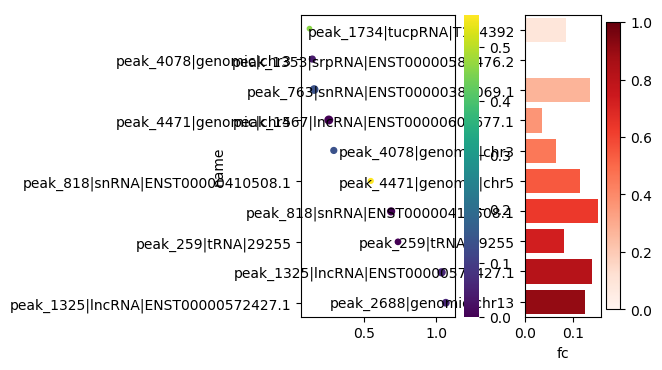

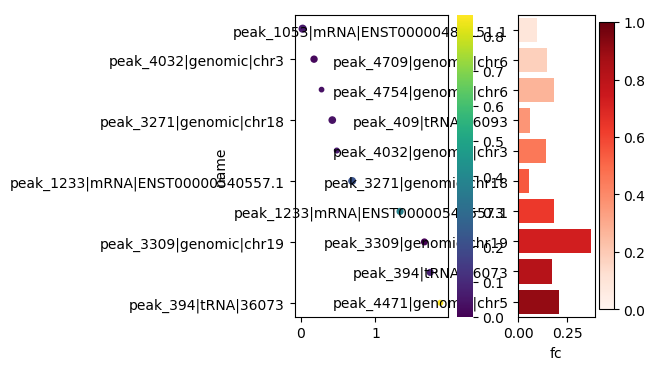

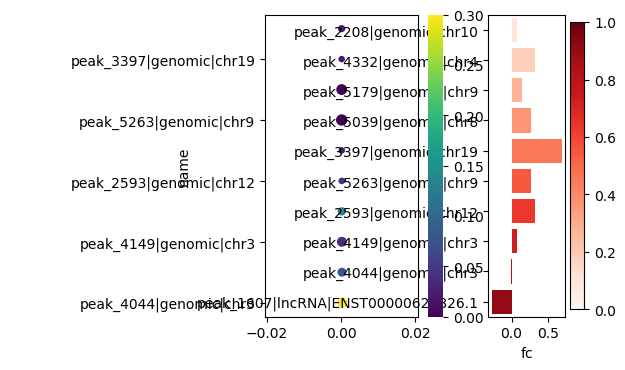

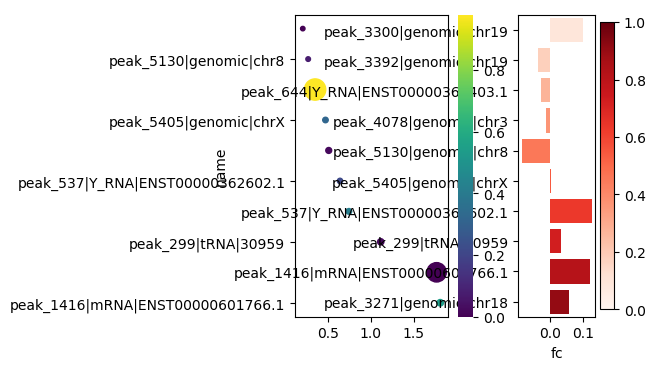

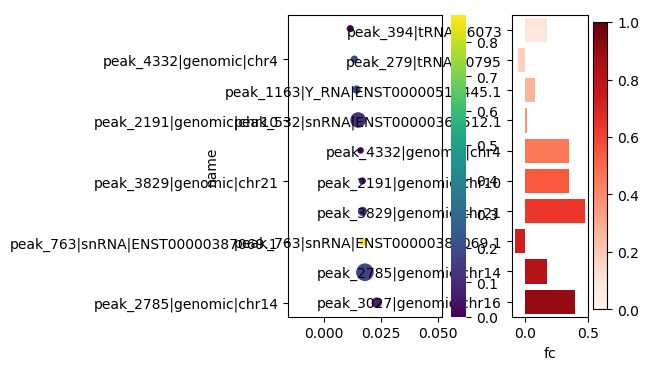

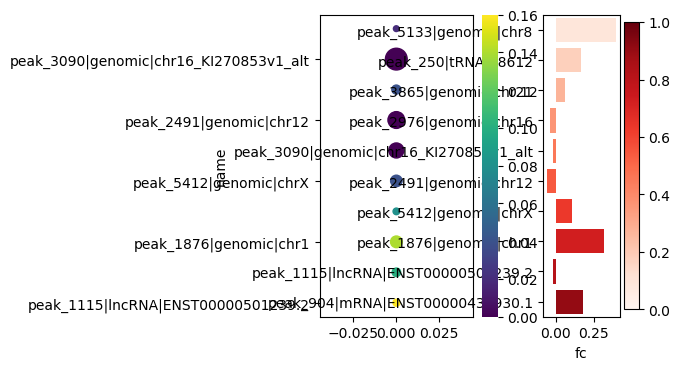

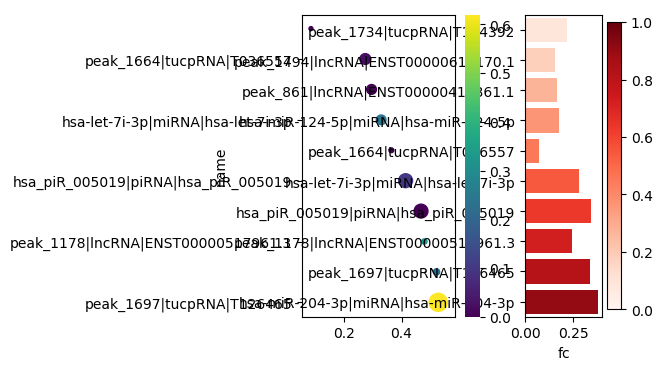

In [152]:
def feature_weight_bar(feature_weight_table,detable,recurrencedf,nums_retain=10,rpkmtable=rpkmtable,
                        original_index=original_index, savepath=savepath,savefig=True,
                        compare_group=compare_group,scalefactor=0.1,area_=(8.0,9.0),namelength=2):
    #feature_weight_table = pd.concat(( feature_weight_table,(feature_weight_table.iloc[:,:-1] !=0).sum(axis=1)),axis=1)
    
    feature_weight_table = pd.concat(( feature_weight_table,recurrencedf.loc[feature_weight_table.index]),axis=1)
    #display(feature_weight_table)
    if feature_weight_table.shape[1] >=nums_retain:
        selected_table = feature_weight_table.iloc[:,nums_retain-1:]
    else:
        selected_table = feature_weight_table
    
    rpkm = np.array(rpkmtable.iloc[np.where(selected_table.iloc[:,0]!=0)].mean(axis=1))
    selected_feature = original_index[np.where(selected_table.iloc[:,0]!=0)]
    nums_retain = min(selected_feature.shape[0],nums_retain)
    selected_table = selected_table.iloc[np.where(selected_table.iloc[:,0]!=0)]
    featurename = np.array(selected_table.index)#np.array([selected_table.index[i].split('|')[0] for  i in range(selected_table.shape[0])])

    feature_weight = np.array(selected_table.iloc[:,0])
    fc = np.array(selected_table.iloc[:,1])
    fc = fc[np.argsort(feature_weight)]
    
    recurrence = np.array(selected_table.iloc[:,2])
    #display_dataframe(pd.DataFrame(selected_table.iloc[:,2]))
    #print (recurrence)
    recurrence = recurrence[np.argsort(-feature_weight)]
    rpkm = rpkm[np.argsort(feature_weight)]
    deselected = -np.log10(detable.loc[selected_feature].iloc[np.argsort(feature_weight)].padj)
    featurename = featurename[np.argsort(feature_weight)]
    selected_feature = selected_feature[np.argsort(feature_weight)]
    feature_weight = np.sort(feature_weight)
    if namelength == 2:
        featurename = np.array([featurename[i].split('|')[2]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
    if namelength == 3:
        featurename = np.array([featurename[i].split('|')[2]+'|'+featurename[i].split('|')[1]+'|'+featurename[i].split('|')[3] for i in range(len(featurename))])

    dataframe= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),feature_weight.reshape(-1,1)),axis=1),columns=['name','weight'])
    dataframe.weight  =  pd.to_numeric(dataframe.weight)
    dataframe_= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),fc.reshape(-1,1)),axis=1),columns=['name','fc'])
    dataframe_.fc  =  pd.to_numeric(dataframe_.fc)
    dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),np.log2(rpkm).reshape(-1,1)),axis=1),columns=['name','rpkm'])
    dataframe_rpkm.rpkm  =  pd.to_numeric(dataframe_rpkm.rpkm)
    dataframe_de= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),deselected.reshape(-1,1)),axis=1),columns=['name','DE_padj'])
    dataframe_de.DE_padj  =  pd.to_numeric(dataframe_de.DE_padj)
    dataframe = dataframe.iloc[::-1]
    dataframe_rpkm = dataframe_rpkm.iloc[::-1]
    fig, (ax_,ax, ax1) = plt.subplots(1,3, figsize=(7,4),gridspec_kw = {'width_ratios':[2,2, 1]})
    ax_.axis('off')
    #print (feature_weight_table.shape[1] ,nums_retain)
    #if feature_weight_table.shape[1] >=nums_retain:
        #print ('yes')
    cmap = plt.cm.BuGn#"viridis"
    #cmaplist = [cmap(i) for i in range(cmap.N)]
    #cmaplist[0] = (.5,.5,.5,1.0)
    #cmaps = cmap.from_list('Custom cmap', cmaplist, cmap.N)
    #bounds = np.linspace(0,recurrence.max(),recurrence.max()+1)
    #norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    im = ax.scatter(dataframe.weight, np.arange(nums_retain),cmap='viridis',#norm=norm,
        c = recurrence, s=(((dataframe_rpkm.rpkm)/area_[0]-0.5)*area_[1])**2.5)
    cbar =fig.colorbar(im, ax=ax)#,drawedges=True
    cbar.outline.set_visible(False)
    #else:
      #  im = ax.scatter(dataframe.weight, np.arange(nums_retain),
      #      s=(((dataframe_rpkm.rpkm)/area_[0]-0.5)*area_[1])**2.5)

    ax.set_yticklabels(featurename[::-1])
    if sequencing_type =='short':
        mattype = 'Log CPM'
    elif sequencing_type =='long':
        mattype = 'Log RPKM'
    interval = np.max(dataframe_rpkm.rpkm) - np.min(dataframe_rpkm.rpkm)
    ratiointer = interval/4
    pws = set(np.round(np.arange(np.min(dataframe_rpkm.rpkm),np.max(dataframe_rpkm.rpkm)+ratiointer,ratiointer),0).astype(int))
    for pw in pws:
        ax.scatter([], [], s=((pw/area_[0]-0.5)*area_[1])**2, c="k",label=str(pw))
        

    pal = sns.color_palette("Greens_d", dataframe_de.DE_padj.shape[0])
    rank = dataframe_de.DE_padj.argsort().argsort()   # http://stackoverflow.com/a/6266510/1628638
    
    dataframe_plot = pd.concat([dataframe_.set_index('name'),dataframe_de.set_index('name')],axis=1)
    dataframe_plot = dataframe_plot.reset_index()
    dataframe_plot['-log10(qvalue)']=-np.log10(dataframe_plot.DE_padj)
    #display_dataframe(pd.DataFrame(recurrence))
    #display_dataframe(dataframe)
    #display_dataframe(dataframe_rpkm)
    #display_dataframe(dataframe_plot)
    #display()
    #norm = plt.Normalize(dataframe_plot['-log10(qvalue)'].min(), dataframe_plot['-log10(qvalue)'].max())
    sm = plt.cm.ScalarMappable(cmap="Reds")
    sm.set_array([])
    #plot = ax1.scatter(dataframe_plot['name'], dataframe_plot['fc'], c=dataframe_plot['-log10(qvalue)'], cmap='Reds')
    #plt.clf()
    #cbar = fig.colorbar(plot,ax=ax1)
    sns.barplot(ax=ax1,data=dataframe_plot,y='name',x='fc',palette='Reds',saturation=1) #,hue='-log10(qvalue)'
    #ax1.get_legend().remove()
    ax1.figure.colorbar(sm)

    
    #sns.barplot(ax=ax2,data=dataframe_de,y='name',x='DE_padj',color='r',saturation=1)
    #display(dataframe.weight)
    #if feature_weight_table.shape[1] >=nums_retain:
   #     ax = std_plot(ax,'Feature Weight','Feature Name',None,'log(RPKM)',
   #               borderpad=1,labelspacing=1.7,handletextpad=1,cbar=cbar,cbarlabel='Feature Recurrency',
   #               xlim=[0,np.ceil(np.max(dataframe.weight)*1000000000)/1000000000.+0.01],ylim=[-0.5,nums_retain-0.5])
    #else:
    #    ax = std_plot(ax,'Feature Weight','Feature Name',None,'log(RPKM)',
    #              borderpad=1,labelspacing=1.7,handletextpad=1,cbar=None,cbarlabel='Feature Recurrency',
    #              xlim=[0,np.ceil(np.max(dataframe.weight)*1000000000)/1000000000.+0.01],ylim=[-0.5,nums_retain-0.5])
 
    #ax1 = std_plot(ax1,'Fold Change','',None,moveyaxis=True)
    #ax2 = std_plot(ax2,'DE adjusted P-value','',None,None)
    #ax1.set_yticks([])
    #ax2.set_yticks([])
    if savefig:
        fig.savefig(savepath+'weight_fc_barplot_'+compare_group+'.eps')#, bbox_inches='tight')
    return  selected_feature




plt.rcParams['figure.dpi'] = 100
selected_features = {}
count = 0
scalefactor=np.array([0.6,0.6,0.5,0.5,0.5,0.5,0.5])*300
for compare_group, preprocess_method in tqdm(tmpdict.items()):  
    if sequencing_type =='long':
        tmptable = rpkmtable[compare_group]
    else:
        tmptable = cpmtable[compare_group]
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0) 
    #display(detable)
    with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
        feature_selection_matrix = f['feature_selection'][:]
    tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
    tmprecurrencedf.index = filtered_mx.index                                 
    detable=detable.fillna(1)
    selected_features[compare_group] = feature_weight_bar(feature_matrix[compare_group],detable,tmprecurrencedf,
                    10,original_index=original_index[compare_group],rpkmtable=tmptable,
                                    compare_group=compare_group,scalefactor=scalefactor[count],area_=(8.0,9.0),namelength=3)
    count+=1
    display_dataframe(feature_matrix[compare_group])
    display_dataframe(detable)
    display_dataframe(tmprecurrencedf)
    display_dataframe(tmptable)
    


In [211]:
def weight_bar_plt(weight=None,recurrence=None,rpkm=None,de=None,area_=(6.0,8.0),nameshort=True,savefig=True):
    weight.rename(columns={ weight.columns[0]: "weight" }, inplace=True)
    recurrence.rename(columns={ recurrence.columns[0]: "recurrence" }, inplace=True)
    de['name_cut'] = [featurename.split('|')[2] + '|' +\
                      featurename.split('|')[1] + '|' +\
                      featurename.split('|')[3] + '|' +\
                      featurename.split('|')[4]\
                      for featurename in de.index]
    de = de.set_index('name_cut')
    rpkm['name_cut'] = [featurename.split('|')[2] + '|' +\
                        featurename.split('|')[1] + '|' +\
                        featurename.split('|')[3] + '|' +\
                        featurename.split('|')[4]\
                        for featurename in rpkm.index]
    rpkm = rpkm.set_index('name_cut')
    weight = weight.sort_values('weight',ascending=False)
    index = weight.index
    plot_mx = pd.DataFrame({'weight':weight['weight'],
                  'rpkm':rpkm.loc[index].mean(axis=1),
                  'recurrence':recurrence.loc[index]['recurrence'],
                  'fc':de.loc[index]['log2FoldChange'],
                  'qvalue':de.loc[index]['padj']})
    plot_mx['-log10(qvalue)'] = -np.log10(plot_mx['qvalue'])
    plot_mx['log2RPKM'] = np.log2(plot_mx['rpkm'])

    if nameshort is True:
        plot_mx['nameshort'] = [i.split('|')[0] for i in index]
        plot_mx = plot_mx.set_index('nameshort')
        plot_mx.index.name=''
    fig, (ax_,ax, ax1) = plt.subplots(1,3, figsize=(7,3),gridspec_kw = {'width_ratios':[(1.5-nameshort)*2,2,2]})
    ax_.axis('off')
    im = ax.scatter(plot_mx['weight'],plot_mx.index,s=((plot_mx['log2RPKM']/area_[0]-0.5)*area_[1])**2,c=plot_mx['recurrence'],cmap='BuGn')
    cbar =fig.colorbar(im, ax=ax)
    cbar.outline.set_visible(False)
    interval = np.max(plot_mx.log2RPKM) - np.min(plot_mx.log2RPKM)
    ratiointer = interval/4
    pws = set(np.round(np.arange(np.min(plot_mx.log2RPKM),np.max(plot_mx.log2RPKM),ratiointer),0).astype(int))
    for pw in pws:
        ax.scatter([], [], s=((pw/area_[0]-0.5)*area_[1])**2, c="k",label=str(pw))
    ax = std_plot(ax,'Feature Weight','Feature Name',None,'log(RPKM)',
                      borderpad=1,labelspacing=1.7,handletextpad=1,cbar=cbar,cbarlabel='Feature Recurrency',)
                      #xlim=[0,0.25],ylim=[-0.5,nums_retain-0.5])


    plot = ax1.scatter(plot_mx.index, plot_mx['fc'], c=plot_mx['-log10(qvalue)'], cmap='Reds')
    ax1.clear()
    sns.barplot(ax=ax1,data=plot_mx[::-1],y=plot_mx[::-1].index,x='fc',palette='Reds',hue='-log10(qvalue)',dodge=False)
    ax1.get_legend().remove()
    cbar = fig.colorbar(plot,ax=ax1)
    cbar.outline.set_visible(False)
    ax1 = std_plot(ax1,'Fold Change','',None,moveyaxis=True,cbar=cbar,cbarlabel='-log10(q value)')
    ax1.set_yticks([])
    #fig.tight_layout()
    with embed_pdf_data() as data:
        fig.savefig(data, format='pdf', metadata={'Title': '123'})
    if savefig:
        fig.savefig(savepath+compare_group+'_weight_bar.eps', bbox_inches='tight')

selected_features = {}
count = 0
scalefactor=np.array([0.6,0.6,0.5,0.5,0.5,0.5,0.5])*300
for compare_group, preprocess_method in tqdm(tmpdict.items()): 
    preprocess_method = preprocess_method[np.where(np.array([preprocess_method[i].split('.')[-1] for i in range(preprocess_method.shape[0])])==exp_mx_name)][0]
    
    if sequencing_type =='long':
        tmptable = rpkmtable[compare_group]
    else:
        tmptable = cpmtable[compare_group]
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0) 
    #display(detable)
    #print ('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5')
    with h5py.File('output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust.'+value_change+'/cross_validation.h5') as f:
        feature_selection_matrix = f['feature_selection'][:]
    tmprecurrencedf = pd.DataFrame(feature_selection_matrix.mean(axis=0))
    tmprecurrencedf.index = filtered_mx.index                                 
    detable=detable.fillna(1)
    weight_bar_plt(feature_matrix[compare_group],tmprecurrencedf,tmptable,detable,(6.0,8.0),False)
    #selected_features[compare_group] = feature_weight_bar(feature_matrix[compare_group],detable,tmprecurrencedf,
            #        10,original_index=original_index[compare_group],rpkmtable=tmptable,
           #                         compare_group=compare_group,scalefactor=scalefactor[count],area_=(8.0,9.0),namelength=3)
    count+=1

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

IndexError: tuple index out of range

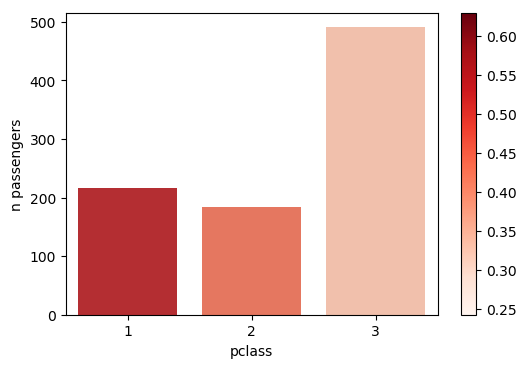

In [139]:

import matplotlib.pyplot as plt
import seaborn as sns
titanic = sns.load_dataset("titanic")
g = titanic.groupby('pclass')
survival_rates = g['survived'].mean()
n = g.size()

norm = plt.Normalize(survival_rates.min(), survival_rates.max())
sm = plt.cm.ScalarMappable(cmap="Reds", norm=norm)
sm.set_array([])

ax = sns.barplot(x=n.index, y=n, hue=survival_rates, palette='Reds', 
                 dodge=False)

ax.set_ylabel('n passengers')
ax.get_legend().remove()
ax.figure.colorbar(sm)

plt.show()

In [115]:
titanic = sns.load_dataset("titanic")
titanic

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
0,0,3,male,22.0,1,0,7.2500,S,Third,man,True,NaN,Southampton,no,False
1,1,1,female,38.0,1,0,71.2833,C,First,woman,False,C,Cherbourg,yes,False
2,1,3,female,26.0,0,0,7.9250,S,Third,woman,False,NaN,Southampton,yes,True
3,1,1,female,35.0,1,0,53.1000,S,First,woman,False,C,Southampton,yes,False
4,0,3,male,35.0,0,0,8.0500,S,Third,man,True,NaN,Southampton,no,True
5,0,3,male,NaN,0,0,8.4583,Q,Third,man,True,NaN,Queenstown,no,True
6,0,1,male,54.0,0,0,51.8625,S,First,man,True,E,Southampton,no,True
7,0,3,male,2.0,3,1,21.0750,S,Third,child,False,NaN,Southampton,no,False
8,1,3,female,27.0,0,2,11.1333,S,Third,woman,False,NaN,Southampton,yes,False
9,1,2,female,14.0,1,0,30.0708,C,Second,child,False,NaN,Cherbourg,yes,False


In [85]:
original_index[compare_group]

Index(['hsa-let-7i-3p|miRNA|hsa-let-7i-3p|hsa-let-7i-3p|hsa-let-7i-3p|0|22',
       'hsa-miR-124-5p|miRNA|hsa-miR-124-5p|hsa-miR-124-5p|hsa-miR-124-5p|0|22',
       'hsa-miR-204-3p|miRNA|hsa-miR-204-3p|hsa-miR-204-3p|hsa-miR-204-3p|0|21',
       'hsa_piR_005019|piRNA|hsa_piR_005019|hsa_piR_005019|hsa_piR_005019|0|28',
       'ENSG00000227953.6|lncRNA|LINC01341|peak_861|ENST00000419361.1|300|340',
       'ENSG00000253190.3|lncRNA|AC084082.1|peak_1178|ENST00000517961.3|140|180',
       'ENSG00000247982.6|lncRNA|LINC00926|peak_1494|ENST00000613170.1|160|200',
       'G008279|tucpRNA|G008279|peak_1664|T036557|1260|1280',
       'G029527|tucpRNA|G029527|peak_1697|T126465|980|1020',
       'G042353|tucpRNA|G042353|peak_1734|T184392|20080|20100'],
      dtype='object')

## ROC: selected feature classification result

In [65]:
def find_metrics_best_for_shuffle(fpr,tpr):
    '''
    used for shuffle roc plot
    '''
    a = 1 - fpr 
    b = tpr
    Sensitivity = b
    Specificity = a
    arith_mean = (Sensitivity+Specificity)*0.5
    geo_mean = (Sensitivity*Specificity)**0.5
    harmo_mean = 2/(1/Sensitivity+1/Specificity)
    eucilid_mean = ((1-Sensitivity)**2+(1-Specificity)**2)**0.5
    auc = sklearn.metrics.auc(a,b)
    thres = 1
    uni,counts= np.unique(np.concatenate((np.argsort(-arith_mean)[:thres],np.argsort(-geo_mean)[:thres],np.argsort(-harmo_mean)[:thres],
                np.argsort(-eucilid_mean)[:thres])),return_counts=True)
    #print (np.max(counts))
    if np.where(counts ==np.max(counts))[0].shape[0] >1:
        ind =1
    else:
        ind =0
    return auc,Sensitivity[uni[np.where(counts ==np.max(counts))][ind]],Specificity[uni[np.where(counts ==np.max(counts))][ind]]
def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), scipy.stats.sem(a)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h

def get_probs_split(filename,interpolatednum=10000,confidence=0.95):
    '''
    get probs from split
    use interpolation to calculate CI
    '''
    xvals = np.linspace(0, 1, interpolatednum)
    with h5py.File(filename,'r') as f:
        predictions =  f['predictions'][:]
        train_index =  f['train_index'][:]
        label = f['labels'][:]
    probs,labels,interpolatedvalue = {},{},{}
    for i in range(predictions.shape[0]):
        probs[i] = predictions[i][~train_index[i]]
        labels[i] = label[~train_index[i]]
        interpolatedvalue[i] = np.interp(xvals,plot_roc( probs[i],labels[i])[1],plot_roc( probs[i],labels[i])[2] )
    interarray = np.array([interpolatedvalue[i]  for i in range(predictions.shape[0])])
    mean,minimum,maximum = np.ndarray([interpolatednum]),np.ndarray([interpolatednum]),np.ndarray([interpolatednum])
    for i in range(interpolatednum):
        mean[i],minimum[i],maximum[i] = mean_confidence_interval(interarray[:,i],confidence)
    return np.concatenate((np.zeros(1),mean,np.ones(1))),np.concatenate((np.zeros(1),minimum,np.ones(1))),\
np.concatenate((np.zeros(1),maximum,np.ones(1))),interpolatednum+2
def plot_roc(prob,label):
    fpr, tpr, _ = roc_curve(label, prob)
    roc_auc = sklearn.metrics.auc(fpr, tpr)
    return roc_auc,fpr, tpr
def find_metrics_best(label,expressionlevel):
    posinum = np.sum(label)
    neganum = label.shape[0] - np.sum(label)
    a,b,c= roc_curve(label,expressionlevel) #fpr tpr threshold
    fp = a*neganum
    tp = b*posinum
    tn = (1-a)*neganum
    fn = (1-b)*posinum
    #Sensitivity = tp/(tp+fn) 
    #Specificity = tn/(tn+fp) 
    Sensitivity = b
    Specificity = 1 - a
    PPV = tp/(tp+fp) 
    NPV = tn/(tn+fn) 
    arith_mean = (Sensitivity+Specificity)*0.5
    geo_mean = (Sensitivity*Specificity)**0.5
    harmo_mean = 2/(1/Sensitivity+1/Specificity)
    eucilid_mean = ((1-Sensitivity)**2+(1-Specificity)**2)**0.5
    mcc_mean = (tp*tn-fp*fn)/(((tp+fp)*(tp+fn)*(tn+fp)*(tn+fn))**0.5)
    F1_score = 2*tp/(2*tp+fn+fp)
    auc = sklearn.metrics.auc(a,b)
    acc = (tp+tn)/(tp+tn+fn+fp)
    distoleftup = (a**2+(1-b)**2)**0.5# to the left up
    #print ("AUC:" +str(auc)) 
    thres = int(label.shape[0]/10.) if int(label.shape[0]/10.)>0 else 1
    uni,counts= np.unique(np.concatenate((np.argsort(-arith_mean)[:thres],np.argsort(-geo_mean)[:thres],np.argsort(-harmo_mean)[:thres],
                np.argsort(-eucilid_mean)[:thres],np.argsort(-mcc_mean)[:thres],np.argsort(-F1_score)[:thres])),return_counts=True)
    #print (np.max(counts))
    if np.where(counts ==np.max(counts))[0].shape[0] >1:
        ind =1
    else:
        ind =0
    return auc,Sensitivity[uni[np.where(counts ==np.max(counts))][ind]],Specificity[uni[np.where(counts ==np.max(counts))][ind]]
def get_auc_stats(root_path,sample_path):
    '''
    sample_path:hccpath,stagepath
    '''
    auc_metrics_jack = {}
    auc_metrics_split = {}
    for i in os.listdir(root_path+sample_path):
        #print (i)
        try:
            print (i, ' file found')
            if i.split('.')[-1] == 'shuffle_split':
                auc_metrics_split[i] = h5py.File(root_path+sample_path+i+'/evaluation.shuffle_split.h5')
            else:
                with h5py.File(root_path+sample_path+i+'/evaluation.leave_one_out.h5','r') as f:
                    predictions =  f['predictions'][:]
                    train_index =  f['train_index'][:]
                    auc_metrics_jack[i]  = predictions[~train_index]
        except:
            print (i, ' file not found')
            print ('files in the directory: ',os.listdir(root_path+sample_path+i))
    return auc_metrics_jack,auc_metrics_split
def get_speci_sensi(filename,spe_criteria=0.99):
    mean,minimum,maximum,interpolatednum = get_probs_split(filename)
    total_nums = mean.shape[0]
    index = round(total_nums *(1-spe_criteria))
    return mean[index],minimum[index],maximum[index]

In [66]:
def plot_shuffle(ax,filename,show_metrics=False,savefigure=False,title=None,
                 spe_criter=0.99,savepath=savepath,savefig=True,
                 compare_group=None,markers_file=None,marker_roc_ind = np.array([0]),markername=None):
    '''
    samplepath: hccpath
    filename: 'logistic_regression.100.robust.stratified_shuffle_split/evaluation.stratified_shuffle_split.h5'
    '''  
    if markers_file is not None:
        markers_auc = {}
        for i in range(markers_file.shape[0]):
            mean,_,_,interpolatednum = get_probs_split(markers_file[i])
            xvals = np.linspace(0, 1, interpolatednum)  
            auc,sen,spe = find_metrics_best_for_shuffle(xvals,mean) #tpr,1-fpr
            if np.isin(i,marker_roc_ind):
               # print (markername[marker_roc_ind[i]],marker_roc_ind[i])
                ax.plot(xvals,mean,linewidth=2.5,color='gray',label=markername[i]+' AUC: '+str(np.round(auc,3)))
            markers_auc[i],_,_ = find_metrics_best_for_shuffle(xvals,mean)
    mean,minimum,maximum,interpolatednum = get_probs_split(filename)
    xvals = np.linspace(0, 1, interpolatednum)
    ax.fill_between(xvals,minimum,maximum,where=(minimum<=maximum),color='b',alpha=0.1)   
    auc,sen,spe = find_metrics_best_for_shuffle(xvals,mean) #tpr,1-fpr
    candidatevalue = auc
    numind = np.ceil((1-spe)/(1./(interpolatednum-2))).astype('int')
    ax.plot(xvals,mean,linewidth=2.5,color=Category20c[20][1],label='candidate AUC: '+str(np.round(auc,3)))
    ax.plot(xvals,minimum,linewidth=1,color='b')
    ax.plot(xvals,maximum,linewidth=1,color='b')
    h,l = ax.get_legend_handles_labels()
    legend = ax.legend(h,l)
    sen_criter = get_speci_sensi(filename,spe_criteria=spe_criter)[0]
    if show_metrics:
        if sen+0.2<=0.95:
            ax.annotate('Specificity '+str('%0.4s'%(spe)), xy=( 1-spe,sen), xytext=(1-spe, sen+0.2),size=6.5,
            arrowprops=dict(facecolor='black', shrink=0.05,width=1.5,headwidth=2.5),
            )
        else:
            ax.annotate('Specificity '+str('%0.4s'%(spe)), xy=( 1-spe,sen), xytext=(1-spe+0.05, sen-0.2),size=6.5,
            arrowprops=dict(facecolor='black', shrink=0.05,width=1.5,headwidth=2.5),
            )
        ax.annotate('Sensitivity '+str('%0.4s'%sen), xy=( 1-spe,sen), xytext=(1-spe+0.1, sen-0.1),size=6.5,
            arrowprops=dict(facecolor='black', shrink=0.1,width=1.5,headwidth=2.5),
            )
    ax.annotate('Sensitivity '+str('%0.4s'%sen_criter), xy=( 1-spe_criter,sen_criter), xytext=(1-spe_criter+0.1, sen_criter),size=6.5,
        arrowprops=dict(facecolor='black', shrink=0.8,width=1.5,headwidth=2.5),
        )
    ax = std_plot(ax,'False Positive Rate','True Positive Rate',title,'Marker',legendsort=False,borderpad=0.4,handletextpad=0.4)
    ax.plot([0,1],[0,1], linewidth=2,alpha=0.6,color='gray',linestyle='--')
    #ax.set_yticklabels(np.arange(0,12,2)/10,fontticklabel)
    #ax.set_xticklabels(np.arange(0,12,2)/10,fontticklabel)
    if savefig:
        fig.savefig(savepath+compare_group+'_ROC.eps', bbox_inches='tight')
    #return mean,minimum,maximum,interpolatednum
    
    return markers_auc,candidatevalue

In [67]:
def return_marker_file(dataset,compare_group,num,de=True):
    marker_file = np.array(['output/'+dataset+'/evaluate_features/result/'+compare_group+'/control_markers_'+str(i)+
                            '/'+classifier_use+'/evaluation.stratified_shuffle_split.h5' for i in control_markers[compare_group].keys() ])
    if de==True:
        marker_file = np.concatenate((marker_file,np.array(['output/'+dataset+'/evaluate_features/result/'+dataset+'.de_selected_mx/'+compare_group+
                                                            '/'+classifier_use+'/evaluation.stratified_shuffle_split.h5'])))
    return marker_file

In [72]:
control_markers = {}
control_markers['Normal-CRC'] = {}
#control_markers['Normal-CRC'][0] = np.array(['hsa-miR-92a-3p','hsa-miR-92b-3p',
 #                                            'hsa-miR-92b-5p','hsa-miR-21-3p',
  #                                          'hsa-miR-21-5p','hsa-miR-139-3p',
    #                                        'hsa-miR-139-5p','hsa-miR-431-3p','hsa-miR-431-5sp'])
control_markers['Normal-CRC'][1] =np.array(['hsa-miR-20a-5p'])
control_markers['Normal-CRC'][2] =np.array(['hsa-miR-26a-5p'])
control_markers['Normal-CRC'][3] =np.array(['hsa-miR-124-5p'])
control_markers['Normal-CRC'][4] =np.array(['hsa-miR-183-5p'])
control_markers['Normal-CRC'][5] =np.array(['hsa-miR-221-3p','hsa-miR-221-5p'])
control_markers['Normal-CRC'][6] =np.array(['hsa-miR-200c-3p'])
control_markers['Normal-CRC'][7] =np.array(['hsa-miR-25-3p'])
control_markers['Normal-CRC'][8] =np.array(['hsa-miR-331-3p'])
control_markers['Normal-CRC'][9] =np.array(['hsa-miR-103a-3p'])
control_markers['Normal-CRC'][10] =np.array(['hsa-miR-127-3p'])
control_markers['Normal-CRC'][11] =np.array(['hsa-miR-151a-5p'])
control_markers['Normal-CRC'][12] =np.array(['hsa-miR-17-5p'])
control_markers['Normal-CRC'][13] =np.array(['hsa-miR-181a-5p'])
control_markers['Normal-CRC'][14] =np.array(['hsa-miR-19b-3p'])
control_markers['Normal-CRC'][15] =np.array(['hsa-miR-15b-5p','hsa-miR-15b-3p'])
control_markers['Normal-CRC'][16] =np.array(['hsa-miR-29a-3p'])
control_markers['Normal-CRC'][17] =np.array(['hsa-miR-335-3p','hsa-miR-335-5p'])
#control_markers['Normal-CRC'][18] =np.array(['hsa-miR-92b-3p','hsa-miR-92b-5p','hsa-miR-92a-3p','hsa-miR-92a-5p'])

control_markers['Normal-PAAD'] = {}
control_markers['Normal-PAAD'][0] = np.array(['hsa-miR-106b-3p','hsa-miR-106b-5p'])
control_markers['Normal-PAAD'][1] = np.array(['hsa-miR-10b-3p','hsa-miR-10b-5p'])
control_markers['Normal-PAAD'][2] = np.array(['hsa-miR-21-5p','hsa-miR-21-3p'])
control_markers['Normal-PAAD'][3] = np.array(['hsa-miR-30c-5p'])
control_markers['Normal-PAAD'][4] = np.array(['hsa-miR-20a-5p'])
control_markers['Normal-PAAD'][5] = np.array(['hsa-miR-181a-3p','hsa-miR-181a-5p'])
control_markers['Normal-PAAD'][6] = np.array(['hsa-miR-181a-3p'])
control_markers['Normal-PAAD'][7] = np.array(['hsa-miR-22-5p','hsa-miR-22-3p'])
control_markers['Normal-PAAD'][8] = np.array(['hsa-miR-885-5p','hsa-miR-885-3p'])
control_markers['Normal-PAAD'][9] = np.array(['hsa-miR-744-5p','hsa-miR-744-3p'])
control_markers['Normal-PAAD'][10] = np.array(['hsa-miR-10b-3p','hsa-miR-10b-5p'])
#control_markers['Normal-PAAD'][11] = np.array(['hsa-miR-30c-5p'])
control_markers['Normal-PAAD'][12] = np.array(['hsa-miR-106b-3p','hsa-miR-106b-5p'])
control_markers['Normal-PAAD'][13] = np.array(['hsa-miR-155-5p'])
control_markers['Normal-PAAD'][14] = np.array(['hsa-miR-212-3p','hsa-miR-212-5p'])
control_markers['Normal-PAAD'][15] = np.array(['hsa-miR-10b-3p','hsa-miR-10b-5p','hsa-miR-106b-3p','hsa-miR-106b-5p'])
control_markers['Normal-PAAD'][16] = np.array(['hsa-miR-221-5p','hsa-miR-221-3p'])
control_markers['Normal-PAAD'][17] = np.array(['hsa-miR-210-3p'])
#control_markers['Normal-PAAD'][18] = np.array(['hsa-miR-21-5p','hsa-miR-21-3p','hsa-miR-210-3p','hsa-miR-155-5p'])

control_markers['Normal-PRAD'] = {}
control_markers['Normal-PRAD'][0] = np.array(['hsa-miR-30c-5p'])
control_markers['Normal-PRAD'][1] = np.array(['hsa-miR-26b-3p','hsa-miR-26b-5p'])
control_markers['Normal-PRAD'][2] = np.array(['hsa-miR-451a'])
control_markers['Normal-PRAD'][3] = np.array(['hsa-miR-24-3p'])
control_markers['Normal-PRAD'][4] = np.array(['hsa-miR-874-3p'])
control_markers['Normal-PRAD'][5] = np.array(['hsa-miR-93-5p'])
control_markers['Normal-PRAD'][6] = np.array(['hsa-miR-106a-5p'])
control_markers['Normal-PRAD'][7] = np.array(['hsa-let-7e-3p','hsa-let-7e-5p','hsa-miR-30c-5p','hsa-miR-1285-3p'])
control_markers['Normal-PRAD'][8] = np.array(['hsa-miR-210-3p','hsa-miR-210-5p'])
control_markers['Normal-PRAD'][9] = np.array(['hsa-miR-221-3p','hsa-miR-221-5p'])
control_markers['Normal-PRAD'][10] = np.array(['hsa-miR-375-3p'])
control_markers['Normal-PRAD'][11] = np.array(['hsa-miR-107'])
control_markers['Normal-PRAD'][12] = np.array(['hsa-miR-130b-3p','hsa-miR-130b-5p'])
control_markers['Normal-PRAD'][13] = np.array(['hsa-miR-181a-2-3p'])
control_markers['Normal-PRAD'][14] = np.array(['hsa-miR-2110'])
control_markers['Normal-PRAD'][15] = np.array(['hsa-miR-301a-5p'])
control_markers['Normal-PRAD'][16] = np.array(['hsa-miR-326'])
control_markers['Normal-PRAD'][17] = np.array(['hsa-miR-331-3p'])
control_markers['Normal-PRAD'][18] = np.array(['hsa-miR-432-5p'])
control_markers['Normal-PRAD'][19] = np.array(['hsa-miR-484'])
control_markers['Normal-PRAD'][20] = np.array(['hsa-miR-574-3p'])
control_markers['Normal-PRAD'][21] = np.array(['hsa-miR-625-3p'])

marker_roc_ind = {}
marker_roc_ind['Normal-CRC'] = np.array([ 5,17 ])
marker_roc_ind['Normal-CRC_S1'] = np.array([ 5,17 ])
marker_roc_ind['Normal-CRC_S2'] = np.array([ 5,17 ])
marker_roc_ind['Normal-CRC_S3'] = np.array([ 5,17 ])
marker_roc_ind['Normal-CRC_S4'] = np.array([ 5,17 ])
marker_roc_ind['Normal-PAAD'] = np.array([ 0,1 ])
marker_roc_ind['Normal-PRAD'] = np.array([ 0,1])

HBox(children=(IntProgress(value=0, max=7), HTML(value='')))

OSError: Unable to open file (unable to open file: name = 'output/scirep/evaluate_features/result/Normal-CRC/control_markers_1/logistic_regression/evaluation.stratified_shuffle_split.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

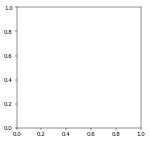

In [74]:
markers_auc = {}
candidatevalue={}
for compare_group, preprocess_method in tqdm(tmpdict.items()):
    
    shuffle_split_roc_file = 'output/'+dataset+'/cross_validation/'+preprocess_method+'/'+compare_group+'/'+classifier_use+'.10.robust'+value_change+'/cross_validation.h5'
    fig,ax=plt.subplots(1,figsize=(4,4))
    #markername  = np.array([control_markers[compare_group][i][0] for i in control_markers[compare_group].keys()])
    markername  = {}
    count = 0
    if compare_group[:10] =='Normal-CRC':
        control_markers[compare_group] = control_markers['Normal-CRC']
    for i in control_markers[compare_group].keys():
        tmpmarkers = np.unique(np.array([control_markers[compare_group][i][j][:-3] for j in range(control_markers[compare_group][i].shape[0])]))
        if tmpmarkers.shape[0] >1:
            print (tmpmarkers)
            markername[i] = 'Panel '+str(count+1)
            count+=1
        else:
            markername[i] = tmpmarkers[0]
    #print (markername)
    ## TO DO: panel
    if compare_group=='Normal-CRC':
        markers_auc[compare_group],candidatevalue[compare_group] =  plot_shuffle(ax,shuffle_split_roc_file+'evaluation.stratified_shuffle_split.h5',
                     spe_criter=0.99,compare_group=compare_group,
                    markers_file=return_marker_file(dataset,compare_group,len(control_markers[compare_group].keys()),de=False)
                #markers_file=return_marker_file(dataset,compare_group,1,de=False)                        
                           ,title= None,marker_roc_ind =marker_roc_ind[compare_group],markername=markername)
    else:
        markers_auc[compare_group],candidatevalue[compare_group] = plot_shuffle(ax,shuffle_split_roc_file+'evaluation.stratified_shuffle_split.h5',
                     spe_criter=0.99,compare_group=compare_group,
                   markers_file=return_marker_file(dataset,compare_group,len(control_markers[compare_group].keys()),de=False)
                #markers_file=return_marker_file(dataset,compare_group,0,de=False)  
                         ,title= None,marker_roc_ind =marker_roc_ind[compare_group],markername=markername)
        

In [ ]:
pd.set_option('display.max_colwidth', -1)
for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    if len(control_markers[compare_group].keys())>0:
        print (len(control_markers[compare_group].keys()),compare_group)
        #markernames  = np.concatenate((np.array(['Candidate']),np.array([control_markers[compare_group][i][0] for i in range(len(control_markers[compare_group].keys()))])))
        markernames = np.ndarray([len(control_markers[compare_group].keys())+1]).astype('str')
        markernames[0] = 'Candidate'
        count = 0
        count_=1
        panel_marker = []
        for i in control_markers[compare_group].keys(): 
            tmpmarkers = np.unique(np.array([control_markers[compare_group][i][j][:-3] for j in range(control_markers[compare_group][i].shape[0])]))
            if tmpmarkers.shape[0] >1:

                markernames[count_] = 'Panel '+str(count)
                panel_marker.append(np.array2string(control_markers[compare_group][i],separator=',')[2:-2].replace("'", ""))
                count+=1
            else:
                markernames[count_] = control_markers[compare_group][i][0]
            count_+=1
        #print (markernames)
        if len(panel_marker) >0:
            panel_table = pd.DataFrame(panel_marker)
            panel_table.index = np.array(['panel '+str(i) for i in range(panel_table.shape[0])])
            panel_table.columns = ['markers']
            display(panel_table)
        selectedind = np.array([i for i in control_markers[compare_group].keys()])
        #print (selectedind)
        
        aucall = np.concatenate((np.array([candidatevalue[compare_group]]),np.array([markers_auc[compare_group][i] for i in markers_auc[compare_group].keys()])))
        auctable =pd.DataFrame(np.concatenate((markernames.reshape(-1,1),aucall.reshape(-1,1)),axis=1))
        auctable.columns = ['Marker Name','AUROC']
        auctable.AUROC = pd.to_numeric(auctable.AUROC )
        auctable = auctable.sort_values('AUROC',ascending=0)
        #display(auctable)
        fig, ax = plt.subplots(1,figsize=(7,4))
        #auctable.plot(kind='bar')
        
        clrs = ['grey' if (x < max(np.array(auctable.AUROC))) else 'blue' for x in np.array(auctable.AUROC)]
        sns.barplot(data=auctable,x='Marker Name',y='AUROC',palette=clrs)
        fig.tight_layout()
        ax.set_xticklabels(auctable.iloc[:,0],rotation=90,fontsize=20,weight='bold')
        ax = std_plot(ax,'Marker Name','AUROC',None)
        ax.set_ylim(0,1)
        #if savefig:
        fig.savefig(savepath+compare_group+'_marker_barplot.eps', bbox_inches='tight')

## Cluster map

In [117]:
cpm_table_use['genetype'] = np.array([feature_matrix.index[i].split('|')[1] for i in range(feature_matrix.shape[0])])
pd.concat((sample_class_use.T,cpm_table_use)).to_csv('tmp.txt',sep='\t')
from clustergrammer_widget import Network, clustergrammer_widget
net = Network(clustergrammer_widget)
net.load_file('tmp.txt')

# cluster using default parameters
net.cluster(enrichrgram=True)

# make interactive widget
net.widget()

In [ ]:
def open_file_or_stdout(filename):
    if filename == '-':
        return sys.stdout
    else:
        return open(filename, 'w')
def extract_feature_sequence(output_file,genome_dir,selected_features):
    from pyfaidx import Fasta
    from Bio.Seq import Seq

    fout = open_file_or_stdout(output_file)
    fastas = {}
    for feature in selected_features:
        gene_id, gene_type, gene_name, domain_id, transcript_id, start, end = feature.split('|')
        if gene_type=='miRNA':
            gene_type = 'mature_miRNA'
        start = int(start)
        end = int(end)
        if gene_type == 'genomic':
            gene_type = 'genome'
        if gene_type not in fastas:
            fastas[gene_type] = Fasta(os.path.join(genome_dir, 'fasta', gene_type + '.fa'))
        if gene_type == 'genome':
            chrom, gstart, gend, strand = gene_id.split('_')
            gstart = int(gstart)
            gend = int(gend)
            seq = fastas[gene_type][chrom][gstart:gend].seq
            if strand == '-':
                seq = str(Seq(seq).reverse_complement())
        else:
            seq = fastas[gene_type][transcript_id][start:end].seq
        seq = seq.upper()
        fout.write('>{}\n'.format(feature))
        fout.write(seq)
        fout.write('\n')
    fout.close()

In [ ]:
for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    extract_feature_sequence(savepath+compare_group+'_sequence.txt','/Share/home/shibinbin/projects/exSeek-dev/genome/hg38/',
                         selected_features[compare_group])

In [ ]:
for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    print ('output/'+dataset+'/matrix_processing/'+preprocess_method+'.txt')

In [ ]:
genename_remain = {}
best_processed_mx = {}

for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    best_processed_mx[compare_group] =pd.read_table('output/'+dataset+'/matrix_processing/'+preprocess_method+'.txt')
    genename_remain[compare_group] = np.array([best_processed_mx[compare_group].index[i].split('|')[0] for i
                            in range(best_processed_mx[compare_group].index.shape[0])])
    

In [ ]:
for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    for i in range(len(control_markers[compare_group].keys())):
        tmptab = best_processed_mx[compare_group].iloc[np.isin(genename_remain[compare_group],control_markers[compare_group][i])]
        tmptab.to_csv('control_markers/'+dataset+'/data/'+compare_group+'/control_markers_'+str(i)+'.txt',sep='\t')


#CRC
miR-92-3p,miR-21,miR-139-3p,miR-431
miR-20a
miR-26a
miR-124-5p
miR-141
miR-183
miR-221
miR-200c
miR-25-3p
miR-331-3p
miR-103a-3p
miR-127-3p
miR-151a-5p
miR-17-5p
miR-181a-5p
miR-18a-5p
miR-18b-5p
miR18a
miR19a
miR19b
miR15b
miR29a
miR335
miR-92
miR-17-3p

#Pancreat
miR-106b
miR-10b
miR-21
miR-30c
miR-20a
miR-181a
miR-483
miR-let7a
miR-122
miR-22
miR-642
miR-885
miR-223
miR-744
miR-10b
miR-30c
miR-106b
hsa-miR-155-5p
miR-212
Panel(miR-10b, miR-106b)
miR-182
miR-16
miR-885
miR-22
miR-642
Panel (miR-885, miR-22, miR-642)
miR-221
Panel (miR-16, miR-196a)
miR-21
miR-210
miR-155
miR-196a
Panel (miR-21,miR-210, miR-155, miR-196a)

#prostate
miR-30c
miR-26b
miR-451
miR-223
miR-24
miR-874
miR-1274a
miR-1207-5p
miR-93
miR-106a
panel(let-7e,let-7c,miR-30c,miR-622 and miR-1285)
miR-21
miR-221
miRNA-375
miRNA-141
miR-1290
miR-375
miR-107
miR-130B
miR-141
miR-181a-2
miR-2110
miR-301A
miR-326
miR-331-3p
miR-432
miR-484
miR-574-3p
miR-625

In [ ]:
original_mx_name=  np.array([original_mx.index[i].split('|')[2] for i in  range(original_mx.index.shape[0]) ])
markername  = np.array([control_markers['Normal-CRC'][i][0] for i in range(len(control_markers['Normal-CRC'].keys()))])
marker_mx = original_mx.iloc[np.isin(original_mx_name,markername)]
sampleindex = marker_mx.columns

featureindex = np.array([marker_mx.index[i].split('|')[2]  for i in range(marker_mx.index.shape[0])])
testtable = pd.DataFrame(np.concatenate((np.array(marker_mx).reshape(-1,1),
        np.repeat(np.array(sample_class.index),featureindex.shape[0]).reshape(-1,featureindex.shape[0]).T.reshape(-1,1),
   np.repeat(np.array(sample_class.label),featureindex.shape[0]).reshape(-1,featureindex.shape[0]).T.reshape(-1,1),
        np.repeat(np.array(featureindex),sampleindex.shape[0]).reshape(-1,1)),axis=1))
testtable.columns=['Expression value','Sample','Class','Feature']
testtable['Class'].iloc[np.where(testtable.Class !='Healthy Control')] ='Cancer'
testtable.iloc[:,0] = np.log2(np.array(testtable.iloc[:,0]).astype('float'))
x = 'Feature'
y = 'Expression value'
hue = 'Class'
        
fig, ax = plt.subplots(figsize=(25,8))
sns.boxplot(data = testtable,ax=ax,x=x,y=y,hue=hue)
#sns.stripplot(data =testtable,ax=ax,x=x,y=y,hue=hue,size=3, edgecolor='black')
ax.set_xticklabels(markername,rotation=20,fontsize=20)
#ax.set_yticklabels(['{:.1f}%'.format((i-1)*20) for i in range(10)],fontsize=20,fontweight='bold')

add_stat_annotation(ax=ax, data=testtable, x=x, y=y, hue=hue,
                    boxPairList=np.array([((markername[i],'Healthy Control'),(markername[i],'Cancer')) for i in range(markername.shape[0])]),
                    test='Mann-Whitney',  loc='inside', verbose=2,#textFormat='full'
                   )
ax.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
ax = std_plot(ax,'Markers','Log Expression Value',title=None)
fig.tight_layout()

In [ ]:
def extract_featurefile(best_preprocess_methods):
    filename = []
    for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
        tmp='output/'+dataset+'/feature_selection/'+preprocess_method+'/'+compare_group+'/random_forest.10.robust/features.txt'
        filename.append(tmp)
    return np.array(filename)
np.savetxt('output/selected_feature/'+dataset+'/selected_features.txt',
           extract_featurefile(best_preprocess_methods),fmt='%s')

HBox(children=(IntProgress(value=0, max=3), HTML(value='')))

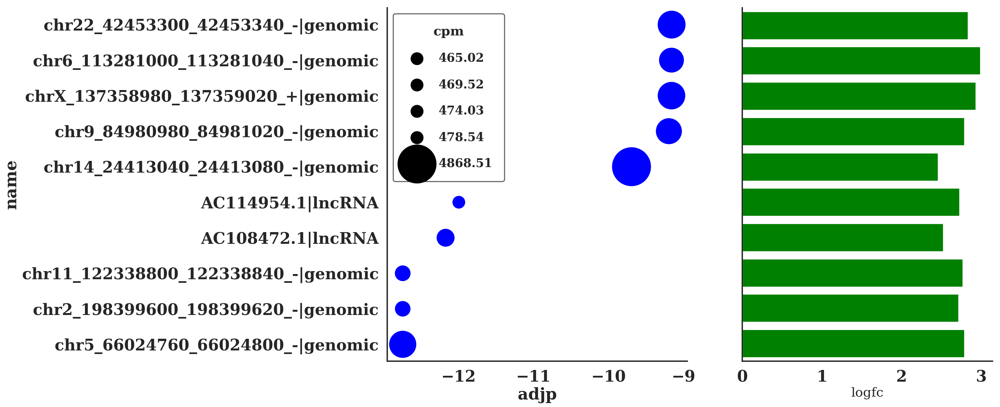

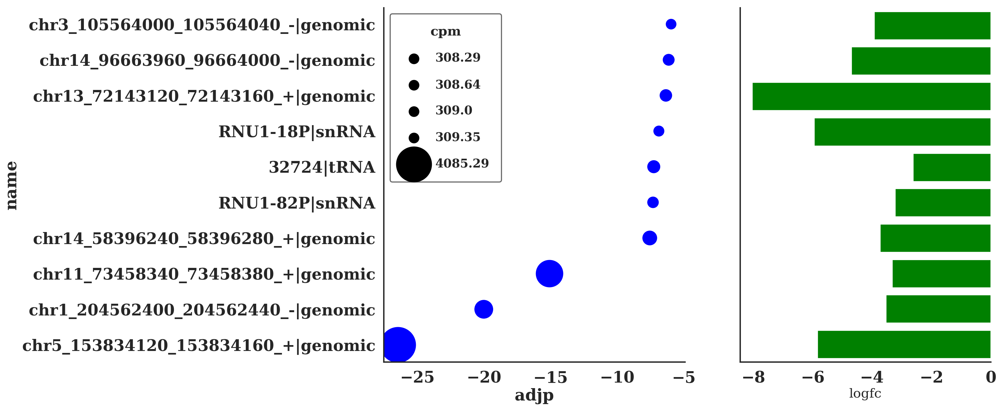

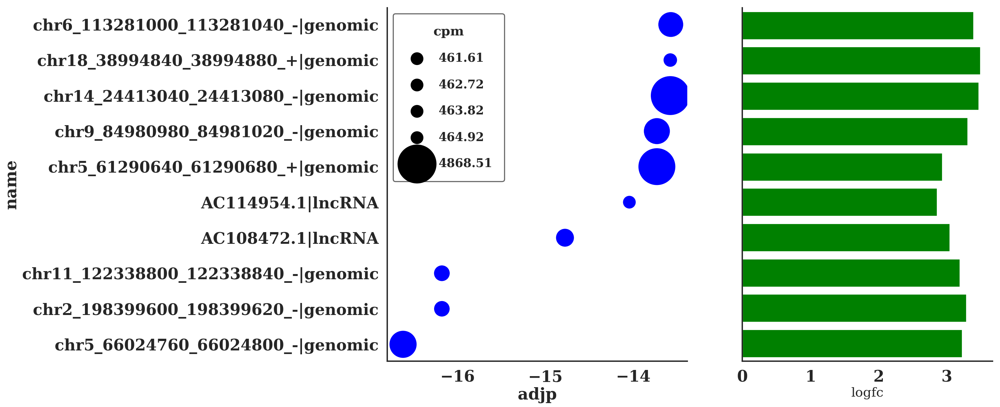

In [509]:
def DE_bar_plot(detable,rpkmtable,nums_retain=10):
    remain_table = detable.sort_values('padj').iloc[:nums_retain]
    featurename = remain_table.index
    featurename = np.array([featurename[i].split('|')[2]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
    padj = remain_table.padj
    logfc = remain_table.log2FoldChange
    rpkm = rpkmtable.loc[remain_table.index].mean(axis=1)
    dataframe= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),padj.reshape(-1,1),
                                           logfc.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','padj','logfc','rpkm'])

    #dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','rpkm'])
    dataframe.padj  =  np.log10(dataframe.padj.astype('float'))
    dataframe.logfc  =  pd.to_numeric(dataframe.logfc)
    dataframe.rpkm  =  pd.to_numeric(dataframe.rpkm)

    fig,ax=plt.subplots(1,3,figsize=(nums_retain*4,12))
    sns.barplot(ax=ax[0],data=dataframe,y='name',x='padj',color='r',saturation=1)
    ax[0].set_xlabel('log10 adjusted p value')
    sns.barplot(ax=ax[1],data=dataframe,y='name',x='logfc',color='b',saturation=1)
    sns.barplot(ax=ax[2],data=dataframe,y='name',x='rpkm',color='g',saturation=1)
    #sns.barplot(ax=ax[2],data=dataframe_rpkm.iloc[:nums_retain],y='name',x='rpkm',color='g',saturation=1)
    if sequencing_type =='short':
        ax[2].set_xlabel('cpm')
    elif sequencing_type =='long':
        ax[2].set_xlabel('rpkm')
    plt.figure(linewidth=30.5)
    for i in range(3):
        ax[i].spines['right'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
    fig.tight_layout()
    if savefig:
        fig.savefig(savepath+compare_group+'_bar_plot.png', bbox_inches='tight')
    ax[1].get_yaxis().set_ticks([])
    ax[1].set_ylabel('')
    ax[2].get_yaxis().set_ticks([])
    ax[2].set_ylabel('')
    fig.tight_layout()
    
def DE_bar_plot_(detable,rpkmtable,nums_retain=10):
    remain_table = detable.sort_values('padj').iloc[:nums_retain]
    featurename = remain_table.index
    featurename = np.array([featurename[i].split('|')[2]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
    padj = remain_table.padj
    logfc = remain_table.log2FoldChange
    rpkm = rpkmtable.loc[remain_table.index].mean(axis=1)
    dataframe= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),padj.reshape(-1,1),
                                           logfc.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','padj','logfc','rpkm'])

    #dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','rpkm'])
    dataframe.padj  =  np.log10(dataframe.padj.astype('float'))
    dataframe.logfc  =  pd.to_numeric(dataframe.logfc)
    dataframe.rpkm  =  pd.to_numeric(dataframe.rpkm)

    fig,ax=plt.subplots(1,2,figsize=(nums_retain*4,12))
    #sns.barplot(ax=ax[0],data=dataframe,y='name',x='padj',color='r',saturation=1)
    #for i in range(nums_retain):
        #display(pd.DataFrame(dataframe.iloc[i]).T)
    sns.stripplot(ax=ax[0],y='name',x='padj', data = dataframe, 
               palette="Set1", size=np.arange(100,200,10))#dataframe.rpkm[i])
    ax[0].set_xlabel('log10 adjusted p value')
    #sns.barplot(ax=ax[1],data=dataframe,y='name',x='logfc',color='b',saturation=1)
    sns.barplot(ax=ax[1],data=dataframe,y='name',x='logfc',color='g',saturation=1)
    #sns.barplot(ax=ax[2],data=dataframe_rpkm.iloc[:nums_retain],y='name',x='rpkm',color='g',saturation=1)
    
    if sequencing_type =='short':
        mattype = 'cpm'
    elif sequencing_type =='long':
        mattype = 'rpkm'
    ax[1].set_xlabel(mattype)
    plt.figure(linewidth=30.5)
    for i in range(2):
        ax[i].spines['right'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
    fig.tight_layout()
    if savefig:
        fig.savefig(savepath+compare_group+'_bar_plot.png', bbox_inches='tight')
    ax[1].get_yaxis().set_ticks([])
    ax[1].set_ylabel('')
    #ax[2].get_yaxis().set_ticks([])
    #ax[2].set_ylabel('')
    fig.tight_layout()
def DE_bar_plot__(detable,rpkmtable,nums_retain=10):
    remain_table = detable.sort_values('padj').iloc[:nums_retain]
    featurename = remain_table.index
    featurename = np.array([featurename[i].split('|')[2]+'|'+featurename[i].split('|')[1] for i in range(len(featurename))])
    padj = remain_table.padj
    logfc = remain_table.log2FoldChange
    rpkm = rpkmtable.loc[remain_table.index].mean(axis=1)
    dataframe= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),padj.reshape(-1,1),
                                           logfc.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','padj','logfc','rpkm'])

    #dataframe_rpkm= pd.DataFrame(np.concatenate((featurename.reshape(-1,1),rpkm.reshape(-1,1)),axis=1),columns=['name','rpkm'])
    dataframe.padj  =  np.log10(dataframe.padj.astype('float'))
    dataframe.logfc  =  pd.to_numeric(dataframe.logfc)
    dataframe.rpkm  =  pd.to_numeric(dataframe.rpkm)    
    #display(dataframe)
    f, (ax, ax1) = plt.subplots(1,2, figsize=(nums_retain*2,12),gridspec_kw = {'width_ratios':[1.2, 1]})
    scalefactor=1
    ax.scatter(dataframe.padj, np.arange(10),
                c = 'b', s=(dataframe.rpkm)*5, cmap="viridis")
    ax.set_xlabel("adjp",fontsize=30,fontdict=dict(weight='bold'))
    ax.set_ylabel("name",fontsize=30,fontdict=dict(weight='bold'))
    ax.set_yticks(np.arange(10))
    ax.set_yticklabels(featurename)
    if sequencing_type =='short':
        mattype = 'cpm'
    elif sequencing_type =='long':
        mattype = 'rpkm'
    #make a legend:
    pws = np.round(np.array([np.min(dataframe.rpkm),np.percentile(dataframe.rpkm,0.2),
                   np.percentile(dataframe.rpkm,0.4),np.percentile(dataframe.rpkm,0.6),
                   np.percentile(dataframe.rpkm,0.8),np.max(dataframe.rpkm)])*5,2)
    for pw in pws:
        ax.scatter([], [], s=pw*scalefactor, c="k",label=str(pw))
        
    h,l = ax.get_legend_handles_labels()
    ax.legend(h[1:], l[1:], labelspacing=1.2, title=mattype, borderpad=1, 
                frameon=True, framealpha=0.6, edgecolor="k", facecolor="w")
    sns.barplot(ax=ax1,data=dataframe,y='name',x='logfc',color='g',saturation=1)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    fig.tight_layout()
    if savefig:
        fig.savefig(savepath+compare_group+'_bar_plot.png', bbox_inches='tight')
    ax1.get_yaxis().set_ticks([])
    ax1.set_ylabel('')
    
for compare_group, preprocess_method in tqdm(best_preprocess_methods.items()):
    if sequencing_type =='short':
        tmptable = cpm_table_origin
    elif sequencing_type =='long':
        tmptable = rpkm_table_origin
    detable = pd.read_table('output/'+dataset+'/differential_expression/'+exp_mx_name+'/'+compare_group+'/deseq2.txt'
                       ,index_col=0)
    DE_bar_plot__(detable,tmptable,nums_retain=10)